In [1]:
import gym
import gym_anytrading

from gym_anytrading.envs import TradingEnv, ForexEnv, StocksEnv, Actions, Positions 
from gym_anytrading.datasets import FOREX_EURUSD_1H_ASK, STOCKS_GOOGL
import matplotlib.pyplot as plt
from keras import applications
from keras.models import Sequential, Model
from keras.layers import Dense, Activation, Flatten, Dropout, Input, Concatenate, Conv2D
from keras.optimizers import Adam

from rl.agents.dqn import DQNAgent
from rl.agents.ddpg import DDPGAgent
from rl.policy import BoltzmannQPolicy, EpsGreedyQPolicy
from rl.memory import SequentialMemory
from rl.core import Processor
from rl.random import OrnsteinUhlenbeckProcess
from rl.callbacks import FileLogger, ModelIntervalCheckpoint, TrainIntervalLogger
from rl.processors import WhiteningNormalizerProcessor

from sklearn import preprocessing
import warnings
warnings.filterwarnings('ignore')

import json
import numpy as np

Using TensorFlow backend.
/Users/williamtan/tech/iss/mtech-sls/env/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/Users/williamtan/tech/iss/mtech-sls/env/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/Users/williamtan/tech/iss/mtech-sls/env/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/U

### Using Forex-v0 with all features available and diffs

In [2]:
from custom_env import ForexV0FullFeature
def env_creator():
    return ForexV0FullFeature(df=FOREX_EURUSD_1H_ASK, frame_bound=(50, 5000), window_size=24)

env = env_creator()
print(env.df)
obs = env.reset()
obs_shape = obs.shape
nb_actions = env.action_space.n

def buildModel():
    model = Sequential()
    model.add(Flatten(input_shape=(1,) + obs_shape))
    model.add(Dense(1024, activation='relu'))
    model.add(Dense(1024, activation='relu'))
    model.add(Dense(1024, activation='relu'))
    model.add(Dense(nb_actions, activation='linear'))
    return model
buildModel().summary()

def agent_creator():
    processor = WhiteningNormalizerProcessor()
    memory = SequentialMemory(limit=256, window_length=1)
    policy = BoltzmannQPolicy()
    agent = DQNAgent(model=buildModel(), nb_actions=nb_actions, memory=memory, nb_steps_warmup=128, policy=policy, batch_size=64, processor=processor, 
                   target_model_update=1e-2, train_interval=32, gamma=0.5, enable_double_dqn=False)
    agent.compile(Adam(lr=0.001), metrics=['mae'])
    return agent

                            Open     High      Low    Close        Volume
Time                                                                     
01.01.2017 22:00:00.000  1.05236  1.05253  1.05221  1.05227  1.435400e+08
01.01.2017 23:00:00.000  1.05227  1.05426  1.05226  1.05282  2.531400e+08
02.01.2017 00:00:00.000  1.05283  1.05283  1.05268  1.05281  1.314000e+08
02.01.2017 01:00:00.000  1.05282  1.05286  1.05225  1.05240  2.739400e+08
02.01.2017 02:00:00.000  1.05239  1.05240  1.05164  1.05220  2.581400e+08
...                          ...      ...      ...      ...           ...
29.12.2017 17:00:00.000  1.20224  1.20257  1.20191  1.20218  9.283300e+09
29.12.2017 18:00:00.000  1.20218  1.20242  1.20122  1.20139  7.366750e+09
29.12.2017 19:00:00.000  1.20139  1.20144  1.20073  1.20096  7.205770e+09
29.12.2017 20:00:00.000  1.20098  1.20109  1.19978  1.19982  6.679810e+09
29.12.2017 21:00:00.000  1.19984  1.20130  1.19931  1.20075  4.885530e+09

[6225 rows x 5 columns]
Instructions 

starting train 1
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
131/989 [==>...........................] - ETA: 1s - reward: 1.4916 - cumulative_reward: 155.7985WARNING:tensorflow:From /Users/williamtan/tech/iss/mtech-sls/env/lib/python3.7/site-packages/tensorflow/python/ops/math_ops.py:3066: to_int32 (from tensorflow.python.ops.math_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.cast instead.
989/989 [==============================] - 11s 11ms/step - reward: -0.4179 - cumulative_reward: -108.6458
train 1 completed. took 11.384 seconds, total_reward: -413.600000000056 total_profit: 0.9189332597305568
min reward: -153.49999999999974, max reward: 72.90000000000019, mean_reward: -0.08357243887655204


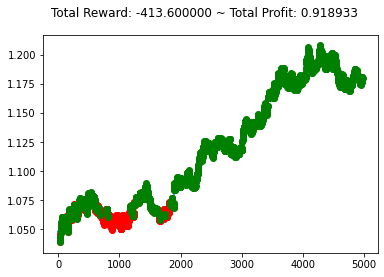

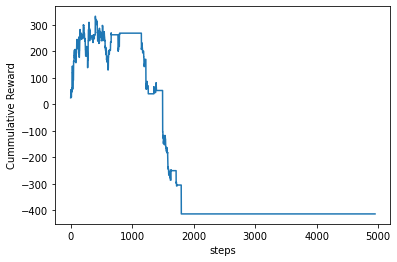

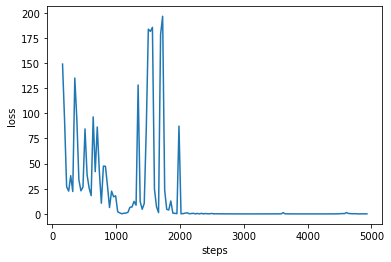

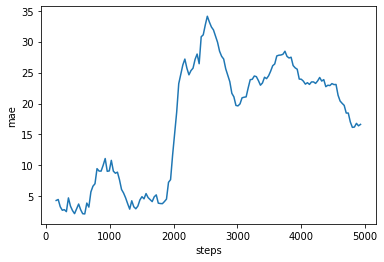

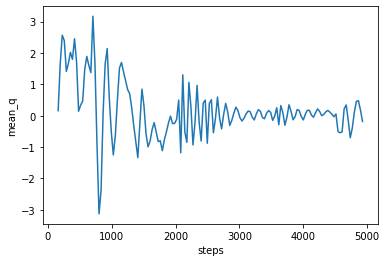

starting train 2
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 11s 11ms/step - reward: -50.6769 - cumulative_reward: -947.5368
train 2 completed. took 24.120 seconds, total_reward: -1164.900000000025 total_profit: 0.8057495391421847
min reward: -266.29999999999933, max reward: 127.69999999999726, mean_reward: -0.2353808850272833


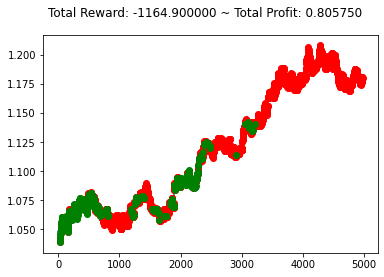

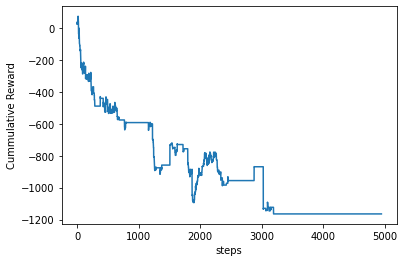

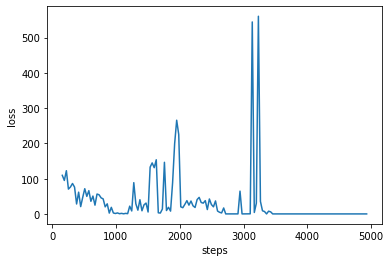

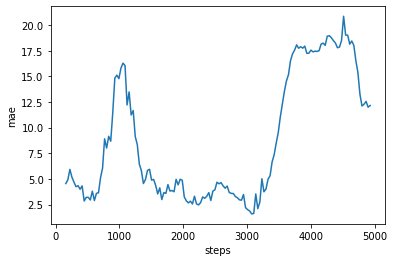

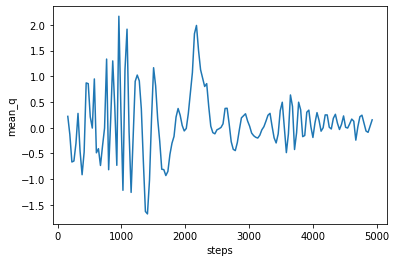

starting train 3
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 12s 12ms/step - reward: 11.7807 - cumulative_reward: -1098.3712
train 3 completed. took 37.461 seconds, total_reward: -1404.8000000000497 total_profit: 0.7736072815431524
min reward: -196.6000000000001, max reward: 110.90000000000266, mean_reward: -0.2838553243079511


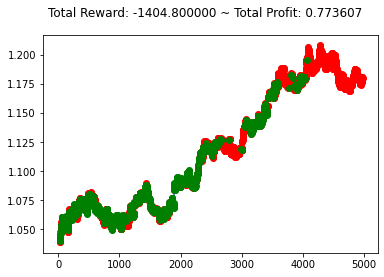

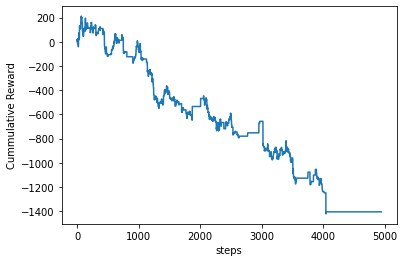

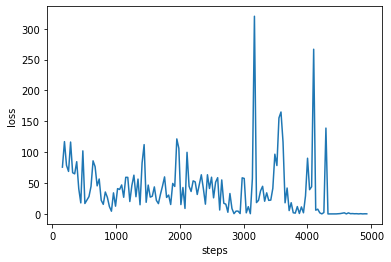

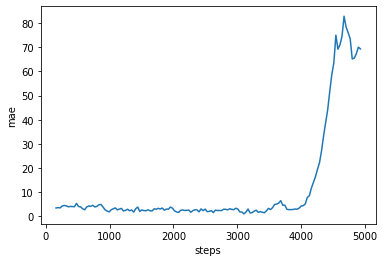

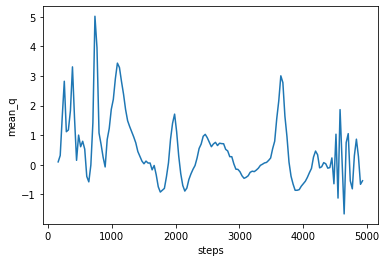

starting train 4
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 12s 12ms/step - reward: 4.1503 - cumulative_reward: 369.3856
train 4 completed. took 51.774 seconds, total_reward: 1237.500000000076 total_profit: 0.7861371737704839
min reward: -124.19999999999875, max reward: 195.19999999999982, mean_reward: 0.25005051525562255


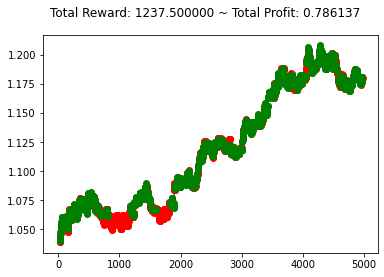

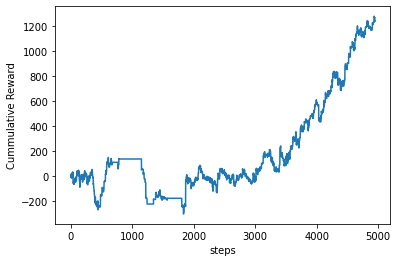

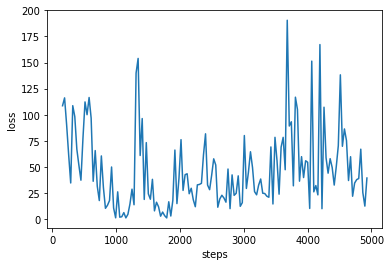

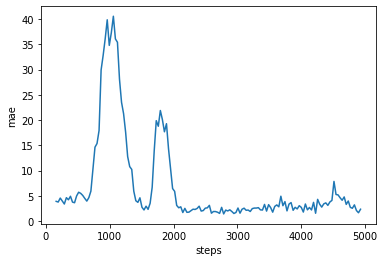

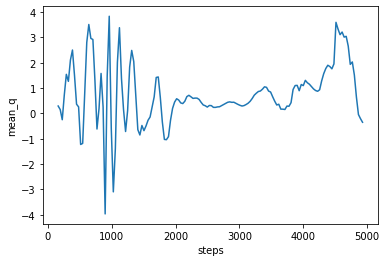

starting train 5
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 13s 13ms/step - reward: -10.8311 - cumulative_reward: -254.2995
train 5 completed. took 66.954 seconds, total_reward: -327.7000000000789 total_profit: 0.7643400988482463
min reward: -181.00000000000006, max reward: 125.50000000000061, mean_reward: -0.06621539704992502


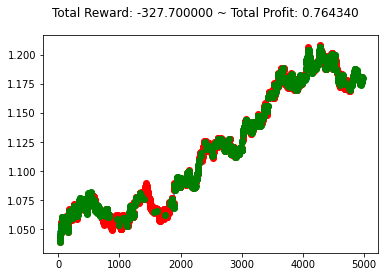

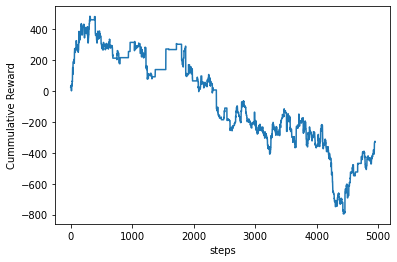

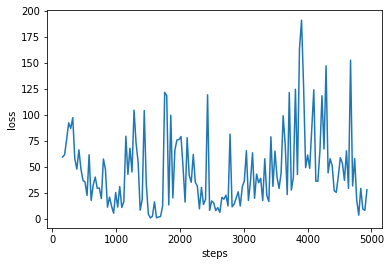

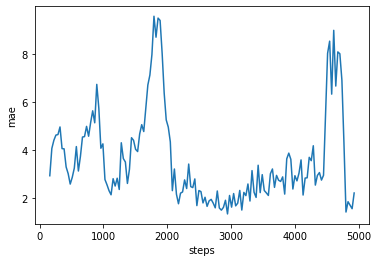

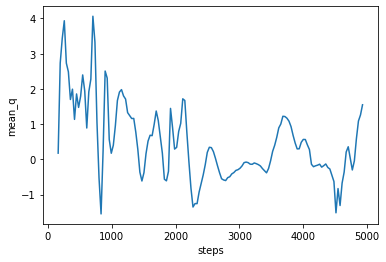

starting train 6
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 14s 14ms/step - reward: -11.3439 - cumulative_reward: 9.5531
train 6 completed. took 82.838 seconds, total_reward: 352.50000000013983 total_profit: 0.7800800868179232
min reward: -193.3000000000029, max reward: 166.20000000000078, mean_reward: 0.07122651040617091


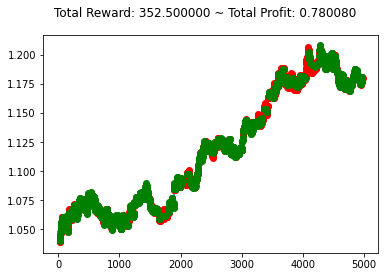

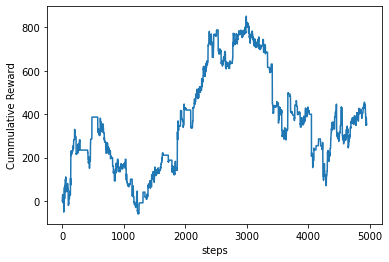

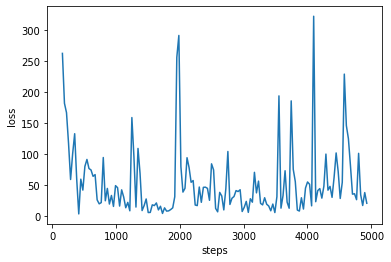

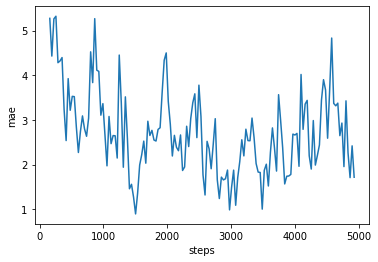

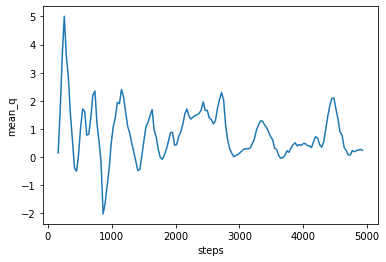

starting train 7
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 14s 14ms/step - reward: 1.7264 - cumulative_reward: 231.0708
train 7 completed. took 99.257 seconds, total_reward: 620.0000000000398 total_profit: 0.7592008017698387
min reward: -129.69999999999925, max reward: 255.10000000000144, mean_reward: 0.1252778339058476


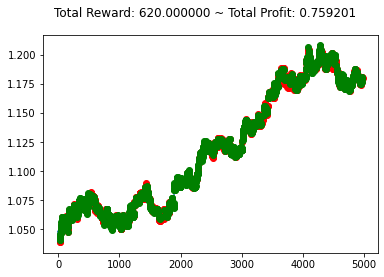

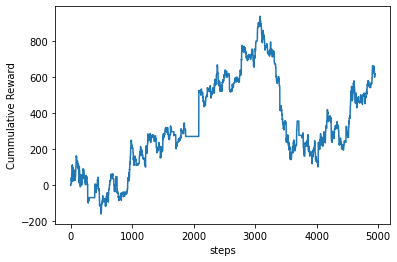

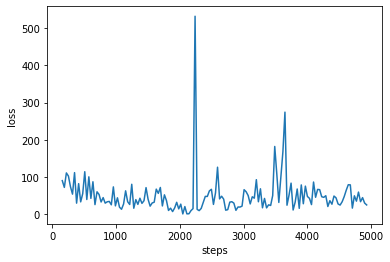

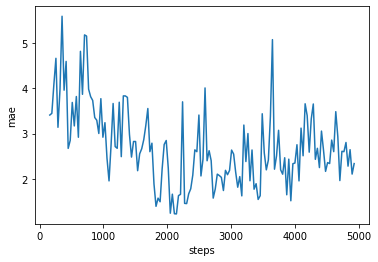

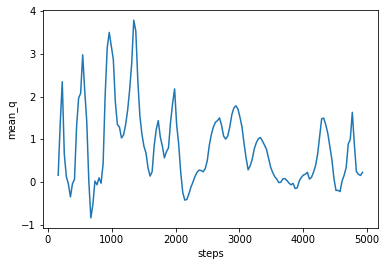

starting train 8
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 14s 14ms/step - reward: -0.3937 - cumulative_reward: -335.3658
train 8 completed. took 116.168 seconds, total_reward: -389.6999999999059 total_profit: 0.8048348241752122
min reward: -146.1000000000001, max reward: 147.20000000000067, mean_reward: -0.07874318044047401


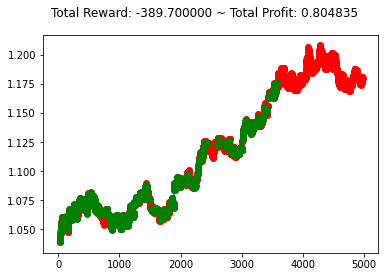

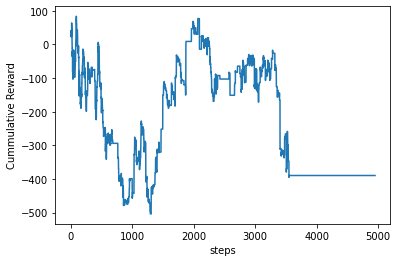

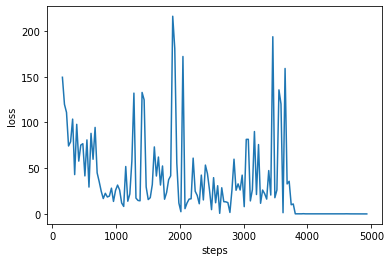

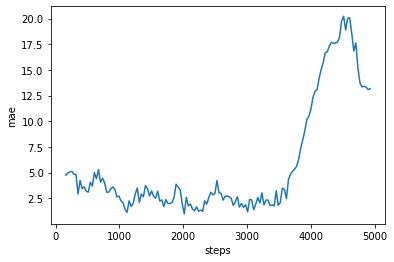

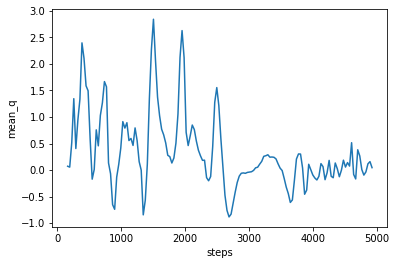

starting train 9
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 16s 16ms/step - reward: 0.7617 - cumulative_reward: 248.3727
train 9 completed. took 134.476 seconds, total_reward: 753.9000000000336 total_profit: 0.9183621819969086
min reward: -148.50000000000028, max reward: 1154.8000000000002, mean_reward: 0.15233380480905914


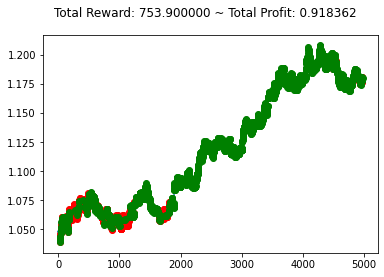

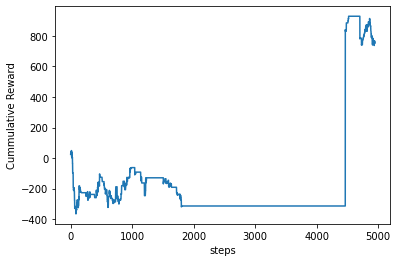

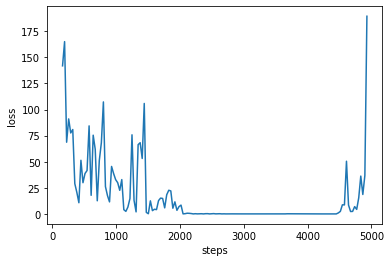

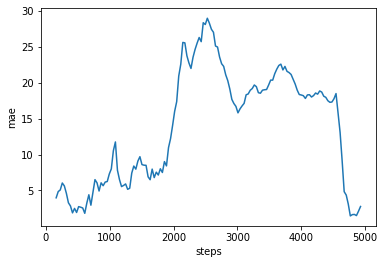

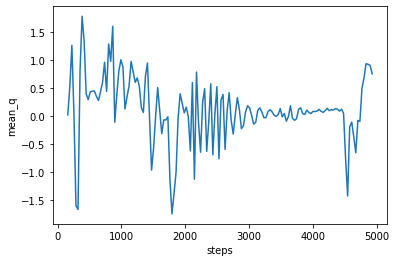

starting train 10
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 15s 16ms/step - reward: -10.3030 - cumulative_reward: -55.1407
train 10 completed. took 153.025 seconds, total_reward: 195.00000000000102 total_profit: 0.8121698434076822
min reward: -195.19999999999982, max reward: 79.89999999999941, mean_reward: 0.039401899373611035


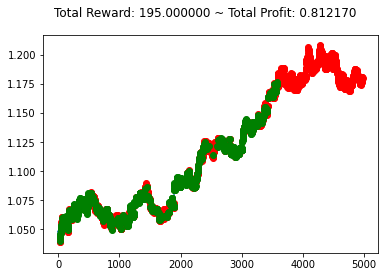

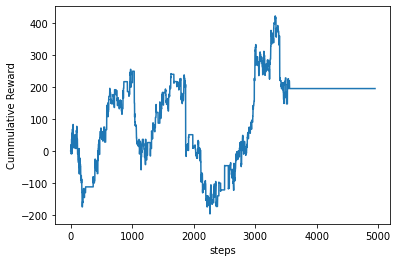

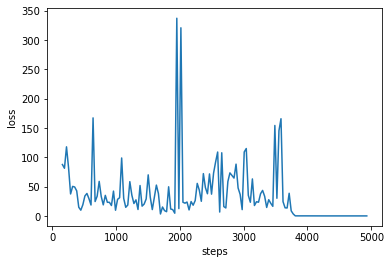

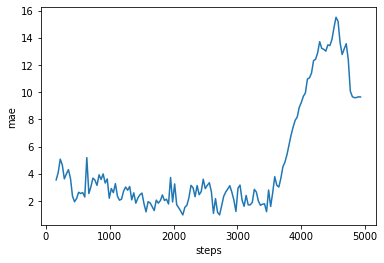

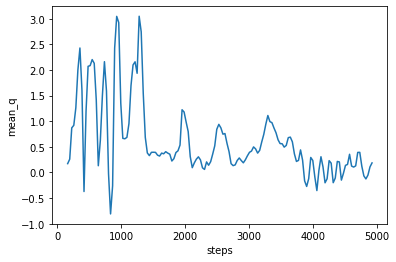

starting train 11
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 16s 16ms/step - reward: -0.7291 - cumulative_reward: -295.9277
train 11 completed. took 171.627 seconds, total_reward: -721.7000000000116 total_profit: 0.8548790167012389
min reward: -998.3000000000009, max reward: 84.59999999999911, mean_reward: -0.14582743988684818


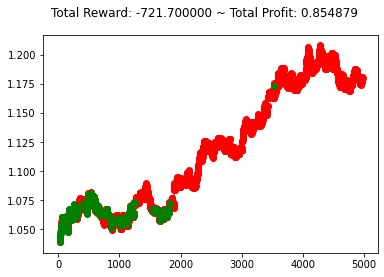

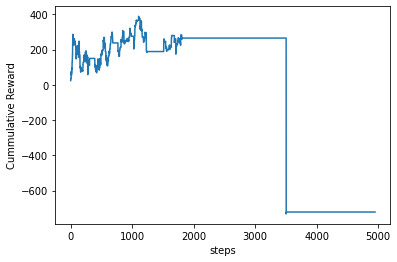

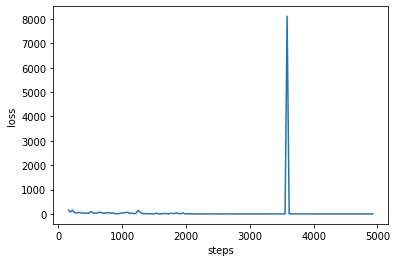

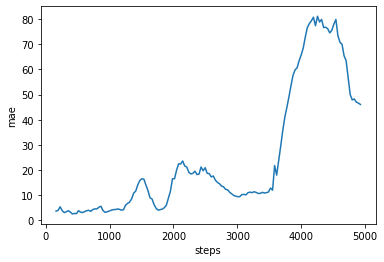

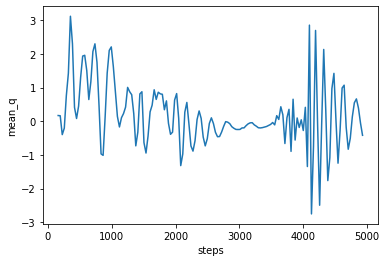

starting train 12
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 16s 16ms/step - reward: -0.1328 - cumulative_reward: 287.4159
train 12 completed. took 191.278 seconds, total_reward: -131.40000000003695 total_profit: 0.84151554460216
min reward: -195.19999999999982, max reward: 84.60000000000134, mean_reward: -0.026550818347148303


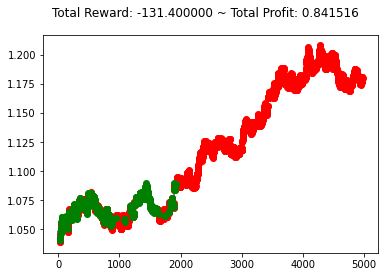

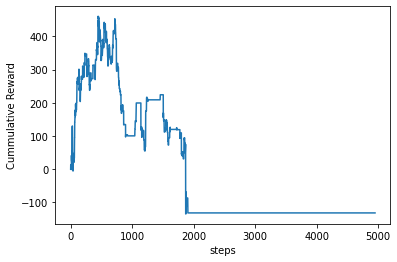

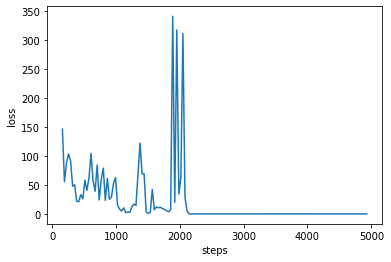

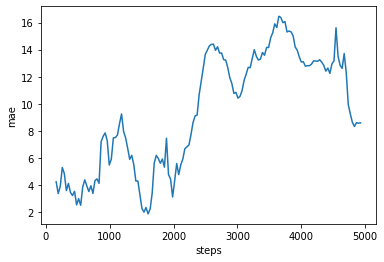

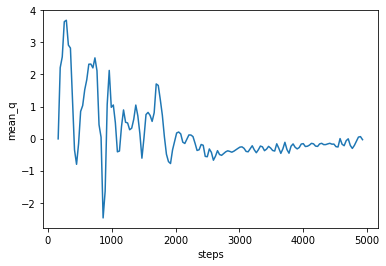

starting train 13
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 17s 17ms/step - reward: -10.9350 - cumulative_reward: -343.9418
train 13 completed. took 211.365 seconds, total_reward: -430.5999999999657 total_profit: 0.8164937587559999
min reward: -149.49999999999795, max reward: 132.90000000000023, mean_reward: -0.08700747625782293


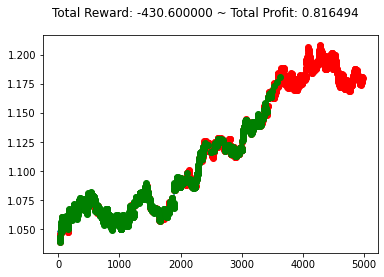

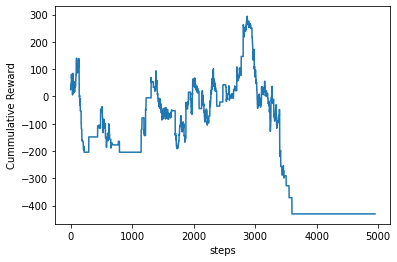

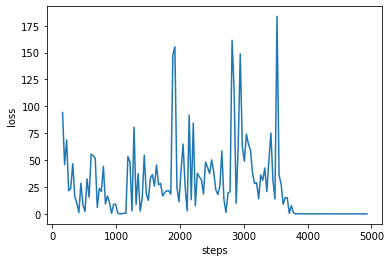

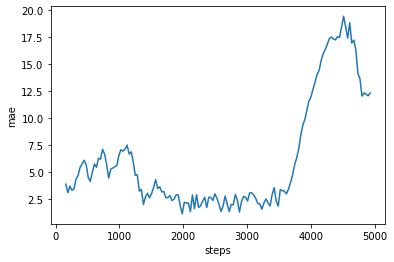

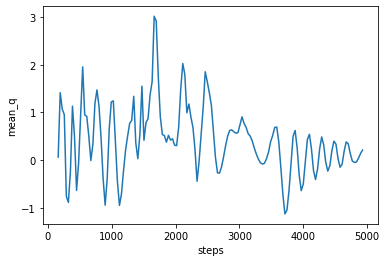

starting train 14
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 18s 18ms/step - reward: 13.4039 - cumulative_reward: 221.5953
train 14 completed. took 232.339 seconds, total_reward: 696.699999999903 total_profit: 0.7818120679254761
min reward: -123.00000000000199, max reward: 195.19999999999982, mean_reward: 0.1407759143261069


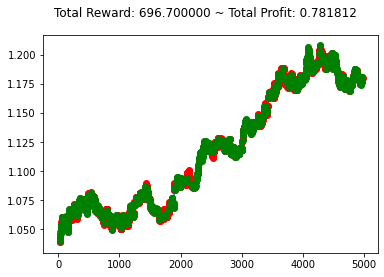

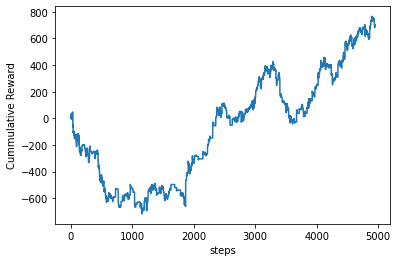

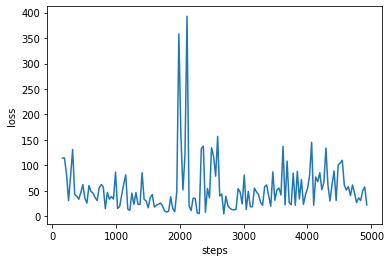

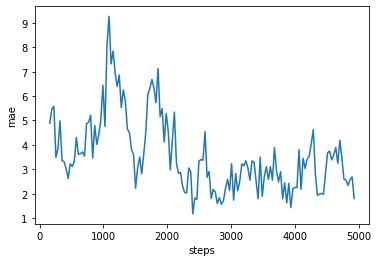

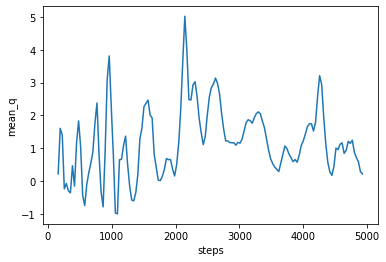

starting train 15
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 18s 18ms/step - reward: -7.7467 - cumulative_reward: 635.3138
train 15 completed. took 254.024 seconds, total_reward: 1042.6000000000265 total_profit: 0.7814962876818361
min reward: -81.7000000000001, max reward: 143.90000000000347, mean_reward: 0.2106688219842446


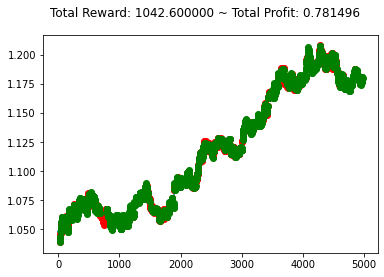

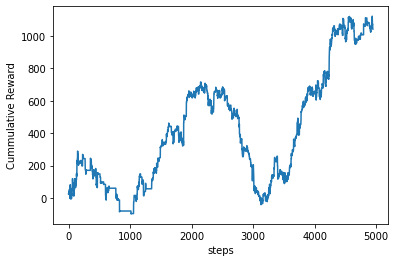

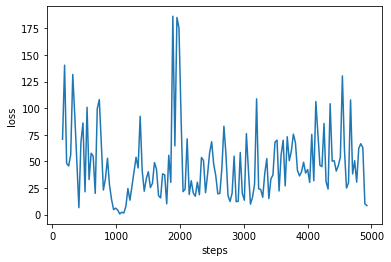

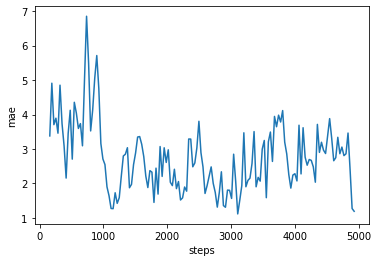

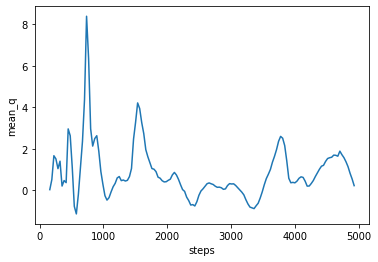

starting train 16
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 19s 19ms/step - reward: 0.6881 - cumulative_reward: 345.3078
train 16 completed. took 276.364 seconds, total_reward: 681.0999999999816 total_profit: 0.8702834944074852
min reward: -65.99999999999939, max reward: 150.3999999999994, mean_reward: 0.13762376237623392


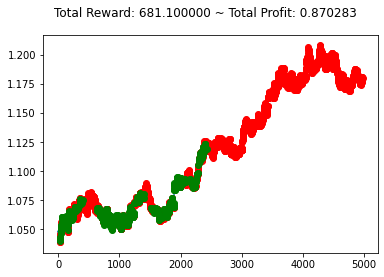

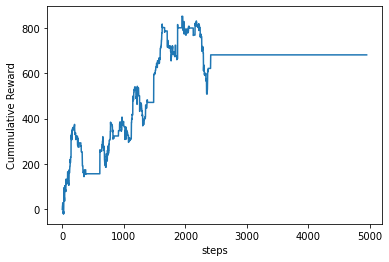

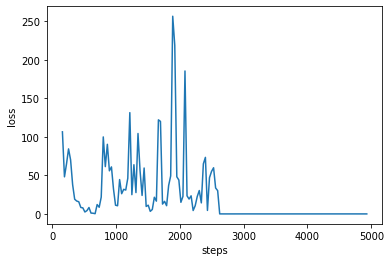

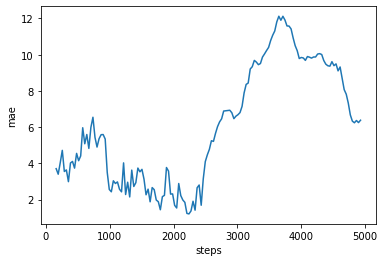

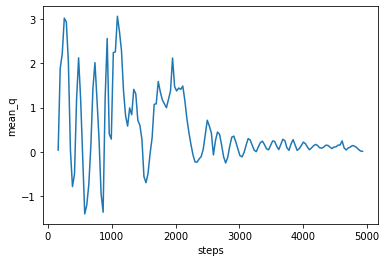

starting train 17
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 19s 20ms/step - reward: 8.2950 - cumulative_reward: -433.2205
train 17 completed. took 299.817 seconds, total_reward: -301.9000000000696 total_profit: 0.7912634892856923
min reward: -121.4000000000004, max reward: 166.29999999999922, mean_reward: -0.061002222671260785


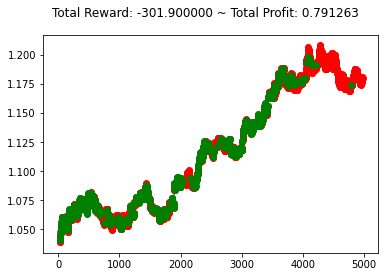

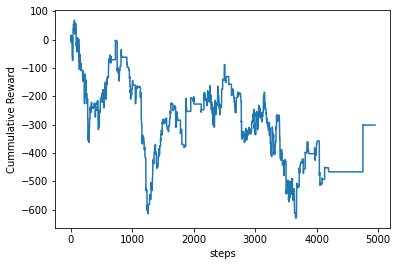

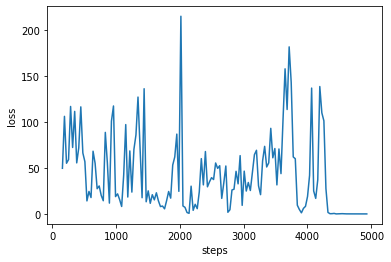

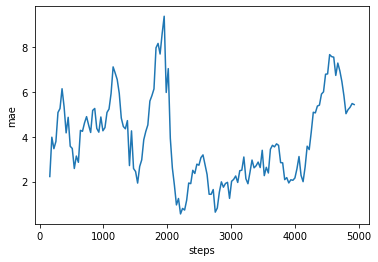

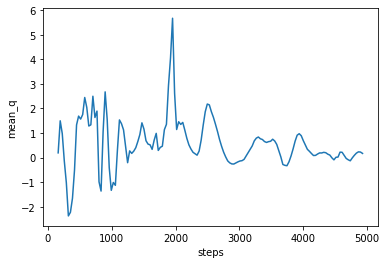

starting train 18
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 20s 21ms/step - reward: -13.6332 - cumulative_reward: -255.2370
train 18 completed. took 324.597 seconds, total_reward: -428.80000000000945 total_profit: 0.9223555807478984
min reward: -110.90000000000045, max reward: 84.59999999999911, mean_reward: -0.08664376641745998


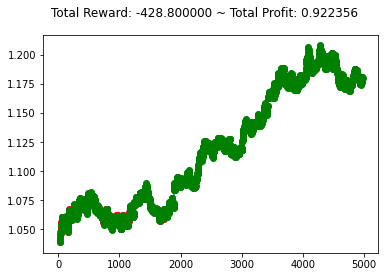

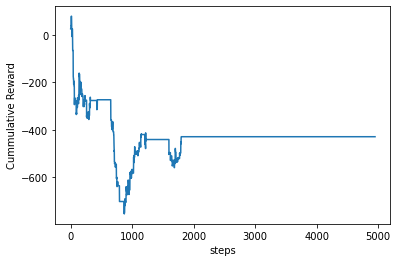

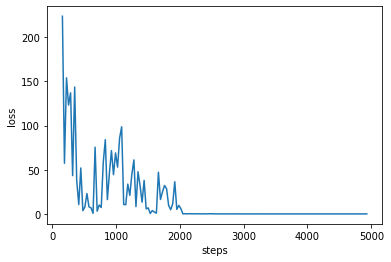

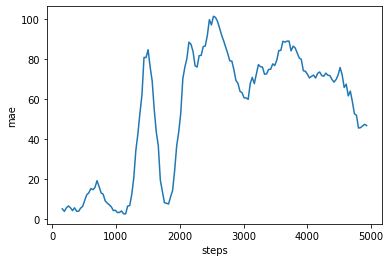

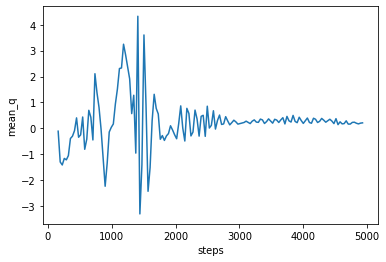

starting train 19
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 21s 22ms/step - reward: 10.0135 - cumulative_reward: -423.9852
train 19 completed. took 350.756 seconds, total_reward: -481.50000000001177 total_profit: 0.7995267717023204
min reward: -109.70000000000147, max reward: 98.30000000000005, mean_reward: -0.09729238229945682


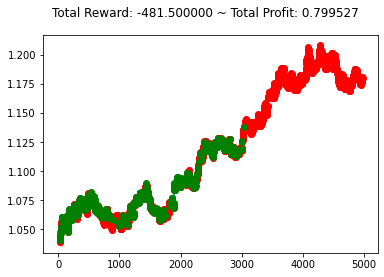

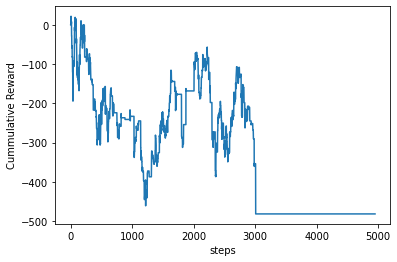

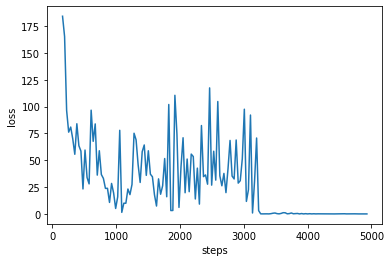

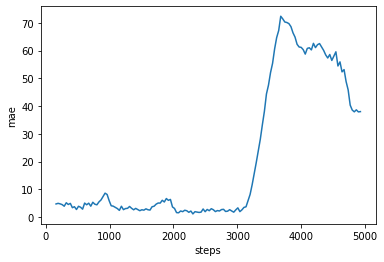

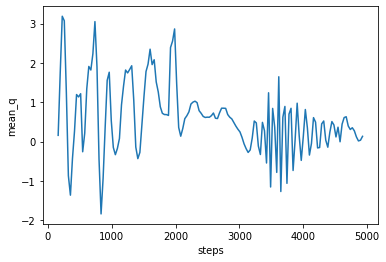

starting train 20
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 23s 23ms/step - reward: 0.0464 - cumulative_reward: -341.2373
train 20 completed. took 378.743 seconds, total_reward: 45.89999999987204 total_profit: 0.7715368339654528
min reward: -99.29999999999994, max reward: 195.19999999999982, mean_reward: 0.009274600929454847


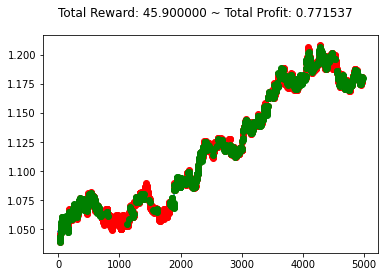

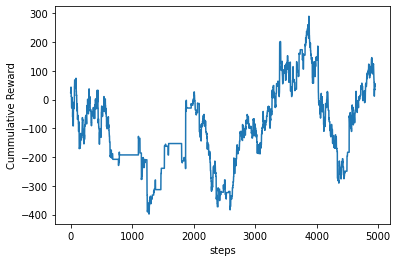

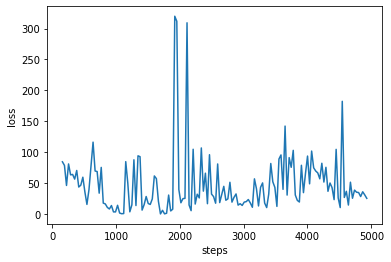

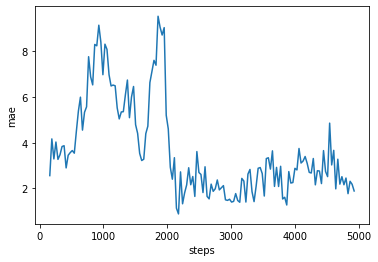

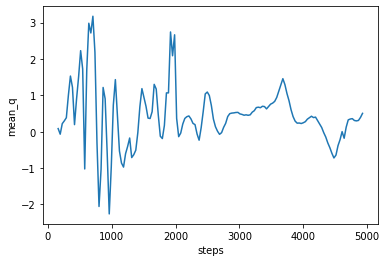

starting train 21
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 23s 23ms/step - reward: -6.6806 - cumulative_reward: -141.4588A: 12s - reward: -10.6173 - cumu
train 21 completed. took 407.211 seconds, total_reward: 118.20000000008164 total_profit: 0.8371754041443984
min reward: -121.89999999999924, max reward: 128.9000000000007, mean_reward: 0.023883612851097524


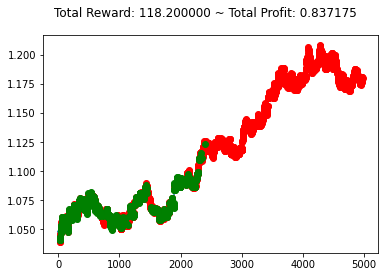

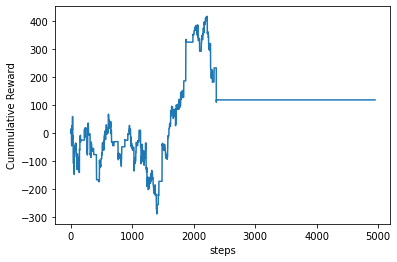

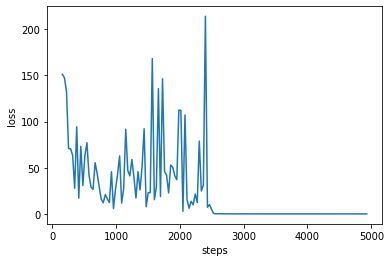

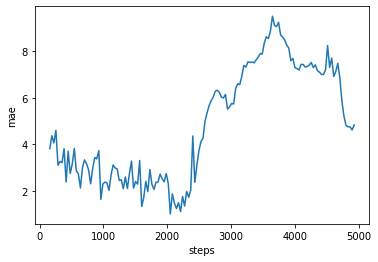

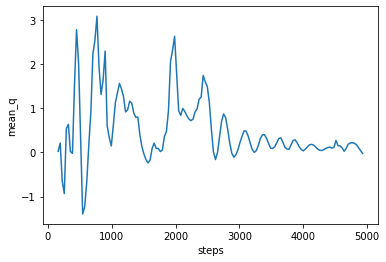

starting train 22
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 24s 25ms/step - reward: -18.3756 - cumulative_reward: 555.1220
train 22 completed. took 437.000 seconds, total_reward: 716.9999999999466 total_profit: 0.8244140337821385
min reward: -168.70000000000164, max reward: 181.80000000000086, mean_reward: 0.14487775308141979


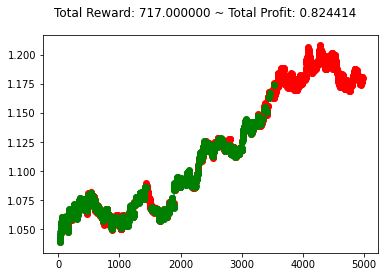

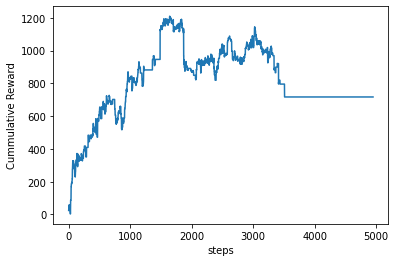

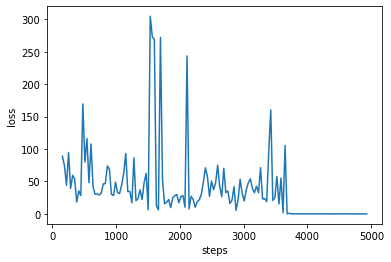

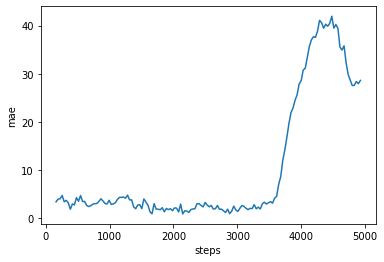

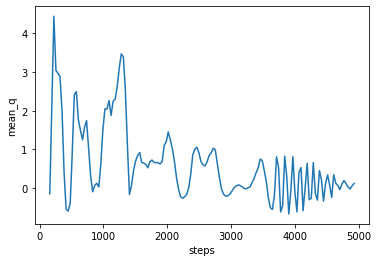

starting train 23
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 24s 25ms/step - reward: -1.7499 - cumulative_reward: -878.0034
train 23 completed. took 467.169 seconds, total_reward: -1732.0999999999988 total_profit: 0.8297146384485027
min reward: -1249.3, max reward: 105.1000000000002, mean_reward: -0.34998989694887833


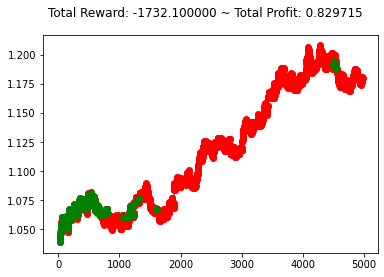

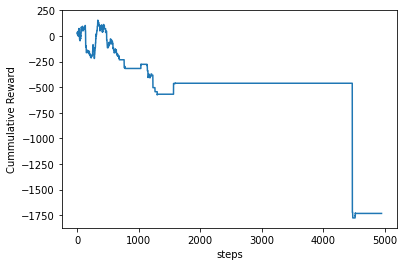

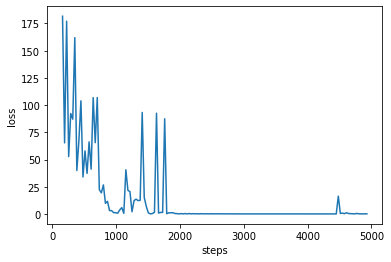

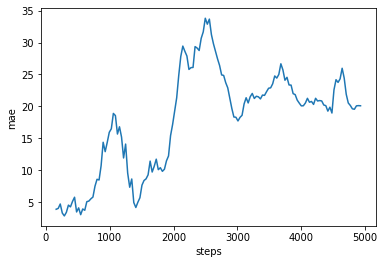

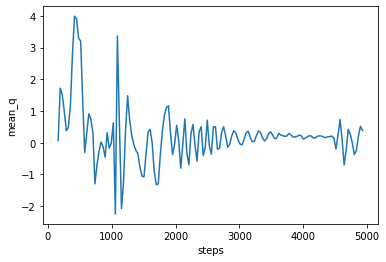

starting train 24
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 25s 26ms/step - reward: 1.8330 - cumulative_reward: 991.7369
train 24 completed. took 498.335 seconds, total_reward: 1814.2999999999824 total_profit: 0.9418613771984954
min reward: -93.10000000000151, max reward: 1039.9999999999986, mean_reward: 0.3665993129925202


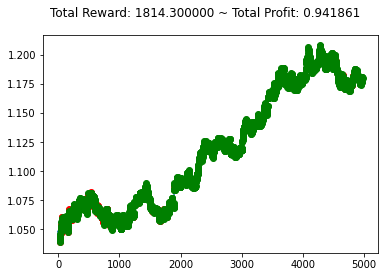

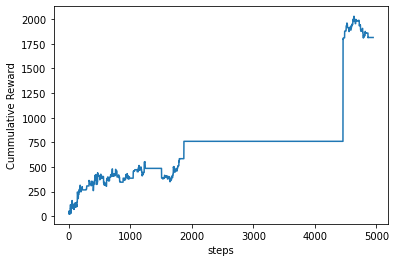

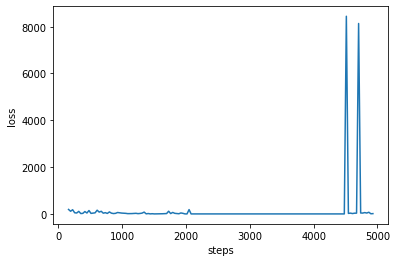

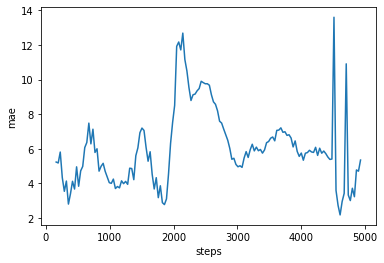

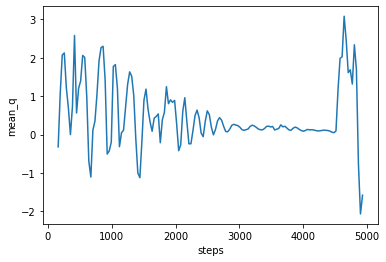

starting train 25
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 26s 26ms/step - reward: -10.9827 - cumulative_reward: 502.0984
train 25 completed. took 530.222 seconds, total_reward: 1105.8999999999294 total_profit: 0.7831973138327029
min reward: -101.19999999999906, max reward: 191.59999999999843, mean_reward: 0.22345928470396634


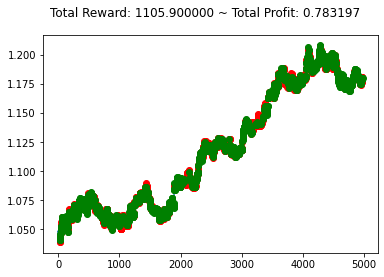

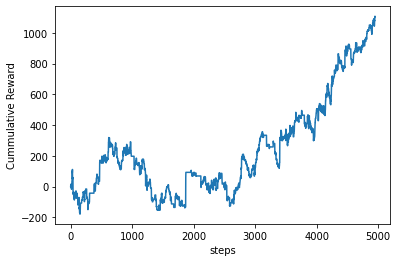

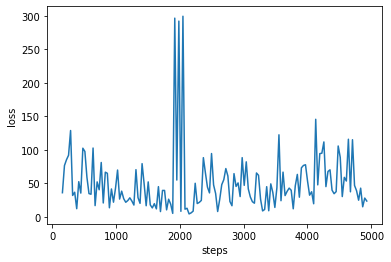

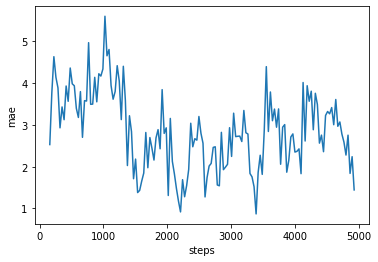

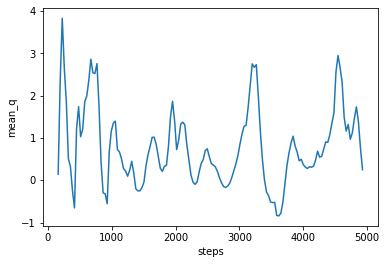

starting train 26
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 29s 29ms/step - reward: -0.0480 - cumulative_reward: -203.6191
train 26 completed. took 565.940 seconds, total_reward: -47.49999999998033 total_profit: 0.8769210880079741
min reward: -177.30000000000024, max reward: 1222.4999999999998, mean_reward: -0.009597898565362766


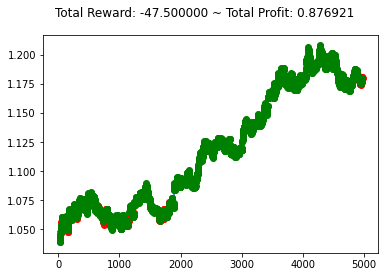

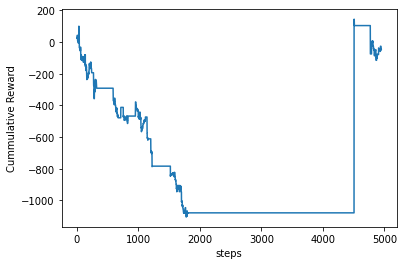

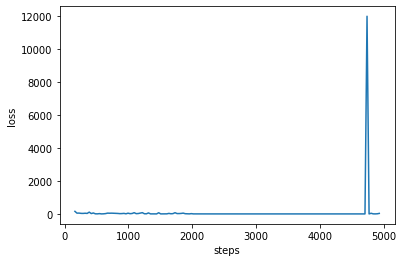

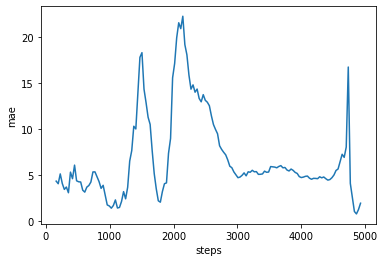

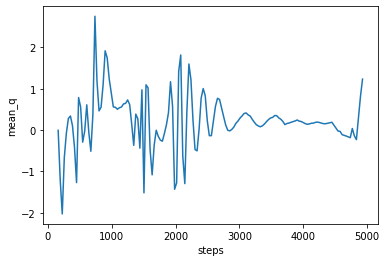

starting train 27
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 27s 27ms/step - reward: -2.6736 - cumulative_reward: 376.2360
train 27 completed. took 599.314 seconds, total_reward: 718.9999999999832 total_profit: 0.8376204479513862
min reward: -149.49999999999795, max reward: 152.69999999999894, mean_reward: 0.14528187512628474


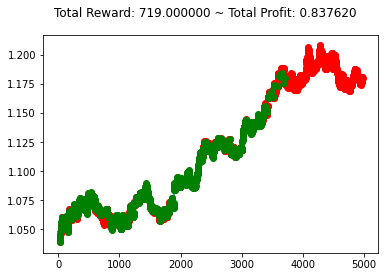

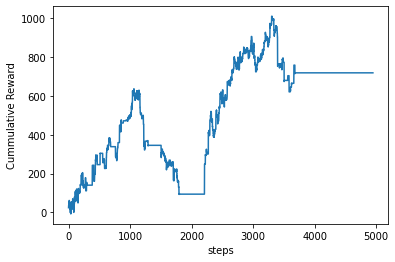

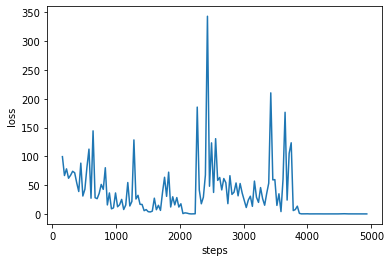

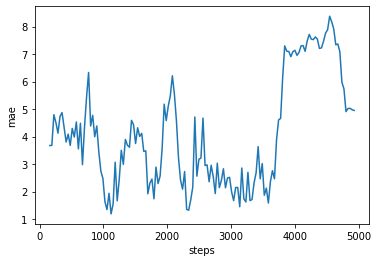

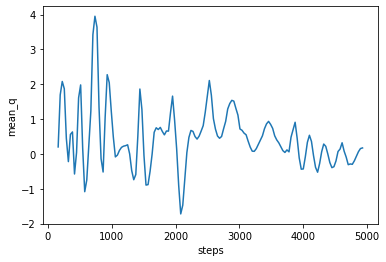

starting train 28
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 28s 28ms/step - reward: 0.4889 - cumulative_reward: 190.5558
train 28 completed. took 633.395 seconds, total_reward: 483.89999999992085 total_profit: 0.7655372993411429
min reward: -125.6999999999997, max reward: 175.0000000000007, mean_reward: 0.0977773287532675


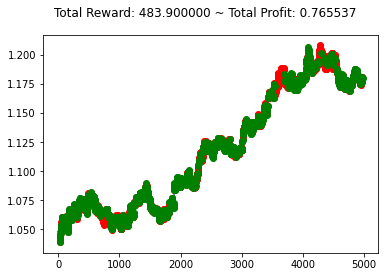

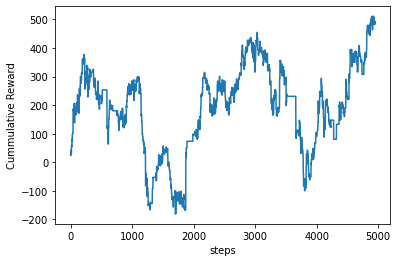

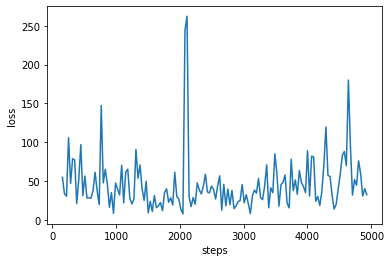

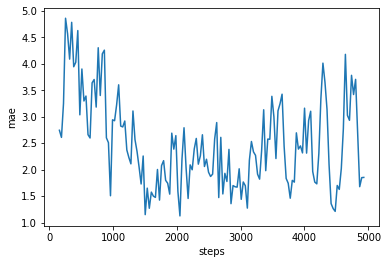

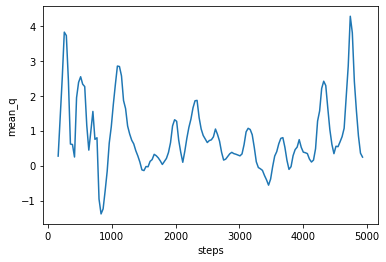

starting train 29
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 28s 29ms/step - reward: 6.8155 - cumulative_reward: 223.1793
train 29 completed. took 669.035 seconds, total_reward: 312.299999999897 total_profit: 0.8401451484493859
min reward: -253.70000000000115, max reward: 154.6000000000003, mean_reward: 0.06310365730448515


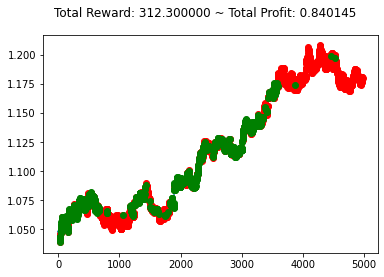

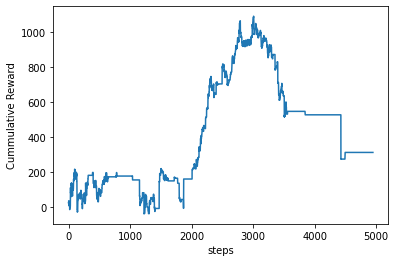

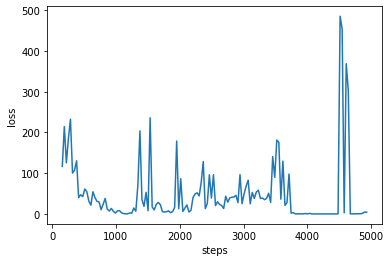

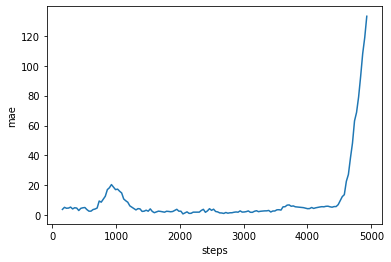

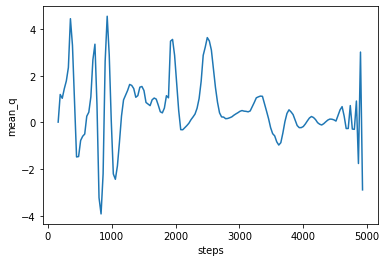

starting train 30
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 30s 30ms/step - reward: -0.5387 - cumulative_reward: -555.9710
train 30 completed. took 705.814 seconds, total_reward: -533.2000000000023 total_profit: 0.8660975682904165
min reward: -236.1000000000013, max reward: 342.00000000000006, mean_reward: -0.1077389371590225


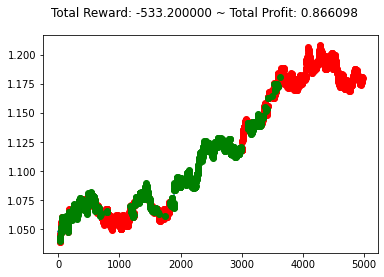

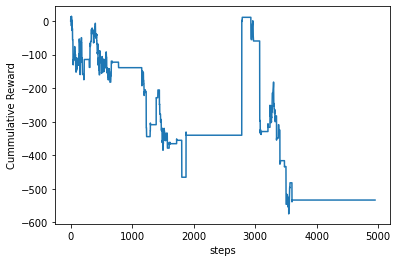

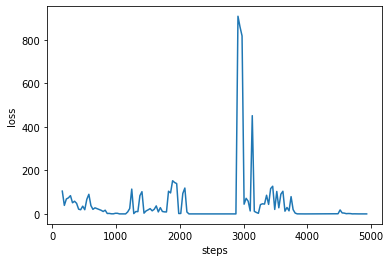

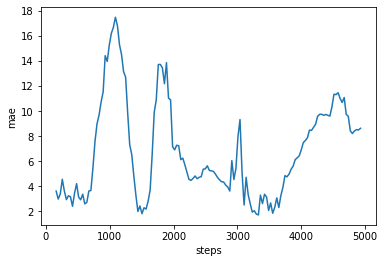

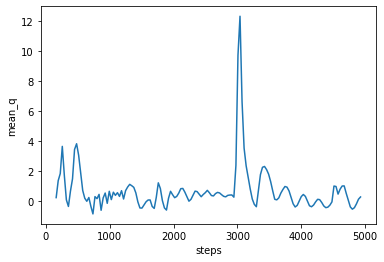

starting train 31
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 30s 30ms/step - reward: -6.9704 - cumulative_reward: -247.8393
train 31 completed. took 742.774 seconds, total_reward: -168.7000000000636 total_profit: 0.8260377358433986
min reward: -105.1000000000002, max reward: 147.99999999999923, mean_reward: -0.03408769448374694


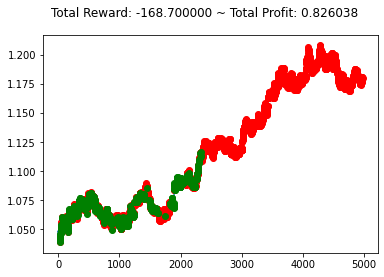

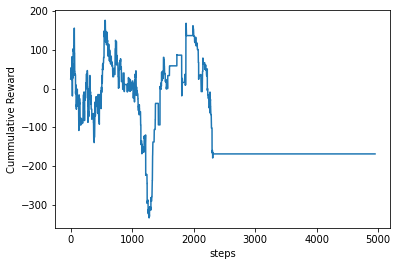

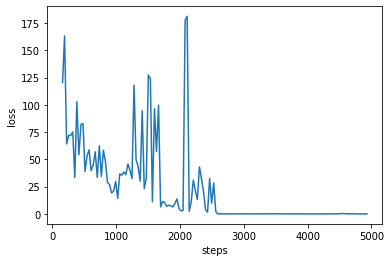

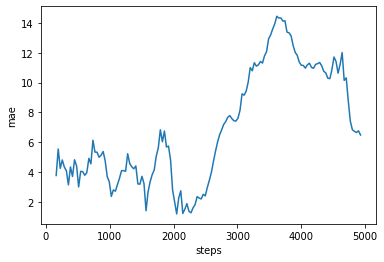

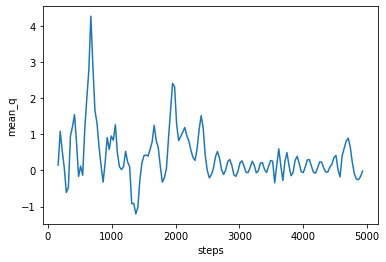

starting train 32
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 31s 31ms/step - reward: -8.7318 - cumulative_reward: -188.4347
train 32 completed. took 780.827 seconds, total_reward: -130.4999999999448 total_profit: 0.8010408062883349
min reward: -85.50000000000057, max reward: 199.30000000000004, mean_reward: -0.026368963426943788


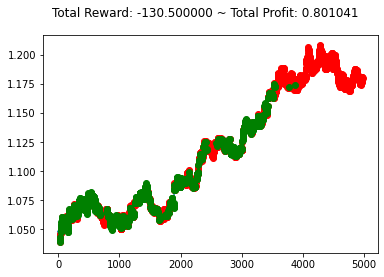

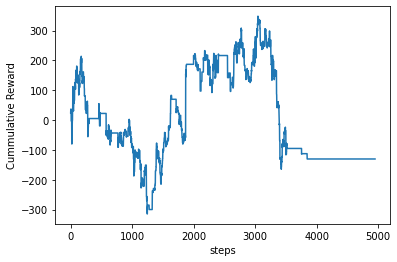

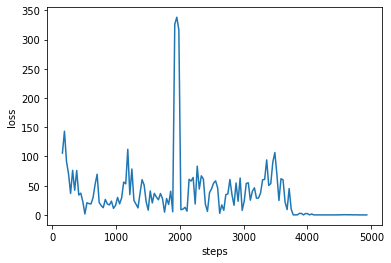

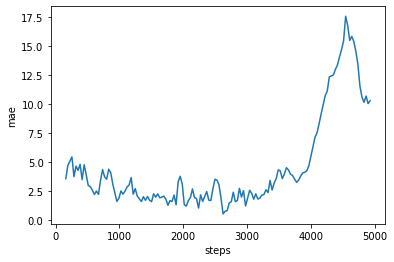

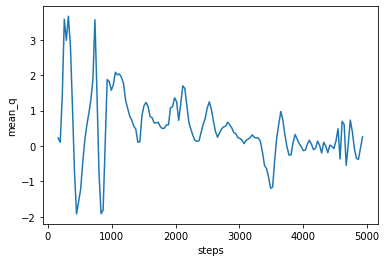

starting train 33
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 32s 32ms/step - reward: -7.4760 - cumulative_reward: -465.8588
train 33 completed. took 819.979 seconds, total_reward: -966.0000000000446 total_profit: 0.789739241416338
min reward: -168.70000000000164, max reward: 154.70000000000095, mean_reward: -0.1951909476662042


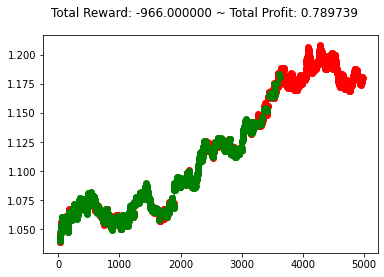

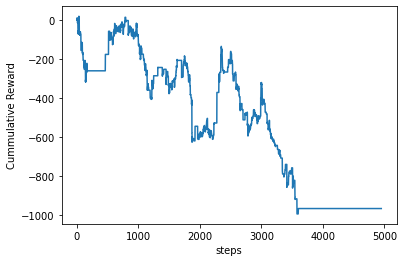

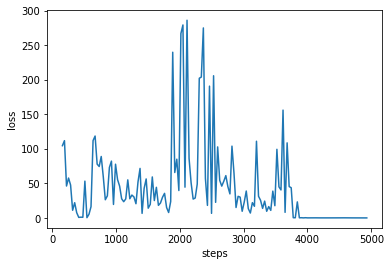

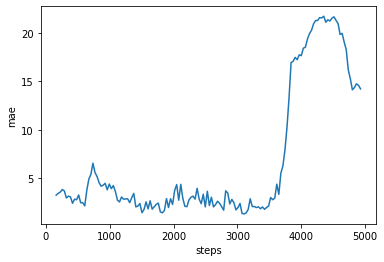

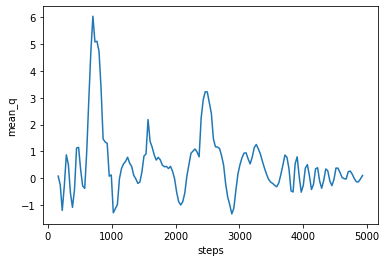

starting train 34
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 32s 32ms/step - reward: -3.9340 - cumulative_reward: 570.6005
train 34 completed. took 860.130 seconds, total_reward: 1352.1000000000395 total_profit: 0.8231250047752215
min reward: -140.69999999999806, max reward: 120.70000000000248, mean_reward: 0.2732067084259526


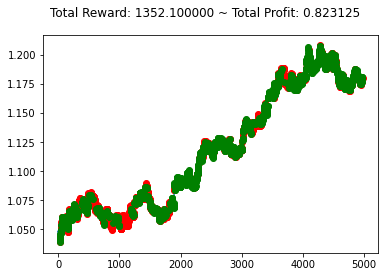

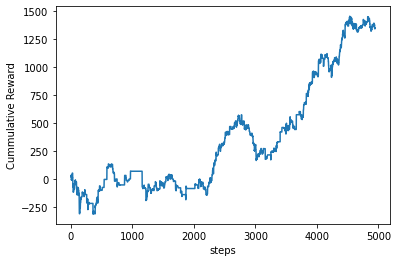

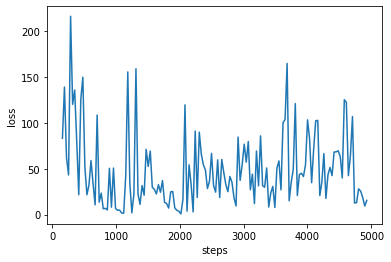

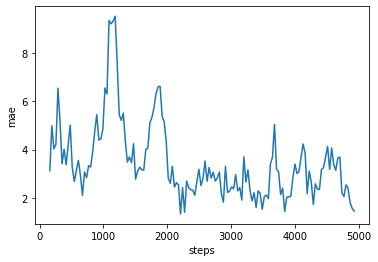

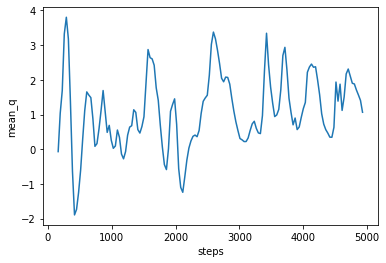

starting train 35
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 32s 33ms/step - reward: -0.0506 - cumulative_reward: 365.6882
train 35 completed. took 900.491 seconds, total_reward: -50.10000000004397 total_profit: 0.8483977841647722
min reward: -168.70000000000164, max reward: 341.5999999999997, mean_reward: -0.010123257223690436


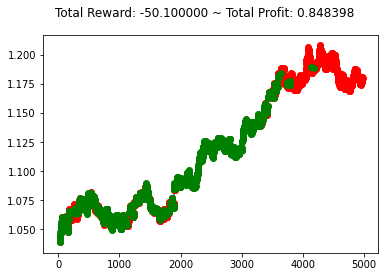

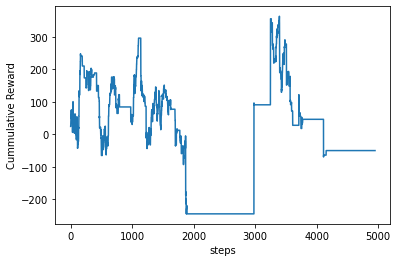

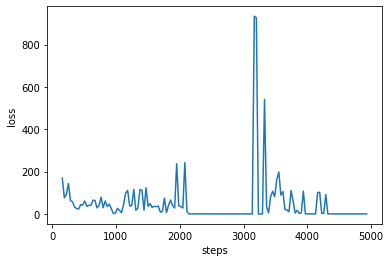

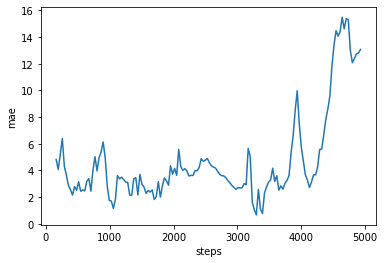

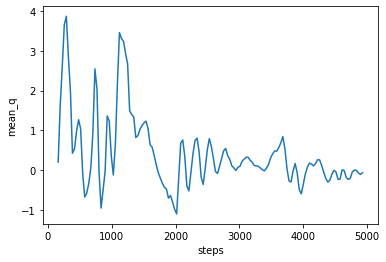

starting train 36
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 33s 34ms/step - reward: -0.6839 - cumulative_reward: -458.3152
train 36 completed. took 941.886 seconds, total_reward: -676.9000000001013 total_profit: 0.792969633391975
min reward: -168.70000000000164, max reward: 88.2000000000005, mean_reward: -0.13677510608205723


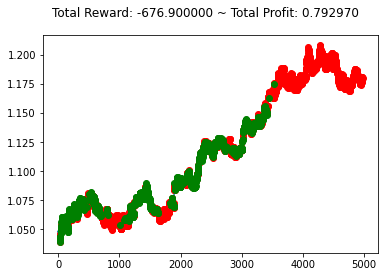

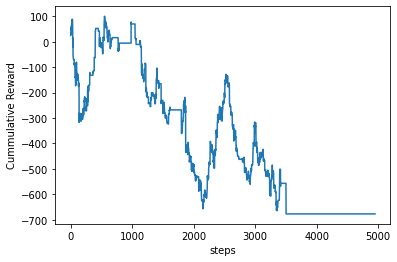

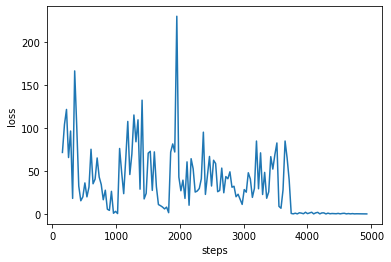

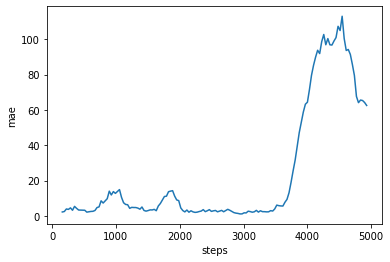

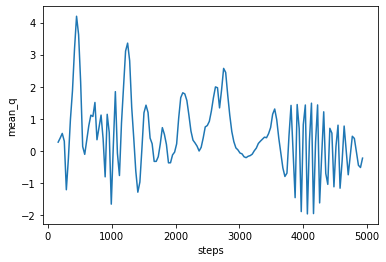

starting train 37
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 34s 35ms/step - reward: -0.7786 - cumulative_reward: -42.0844
train 37 completed. took 984.424 seconds, total_reward: -473.6999999999965 total_profit: 0.785508859571626
min reward: -168.70000000000164, max reward: 132.89999999999802, mean_reward: -0.0957163063245093


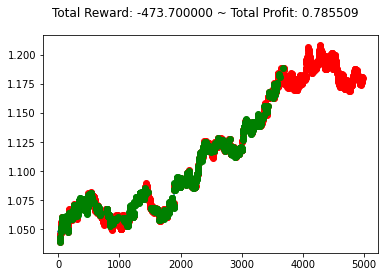

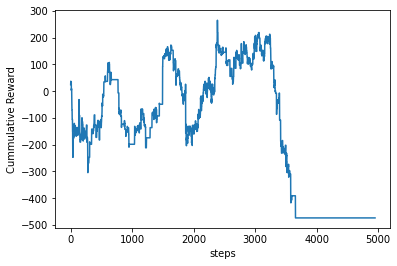

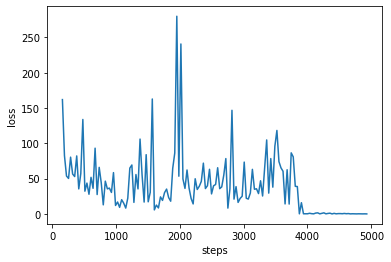

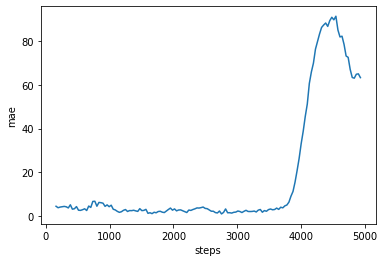

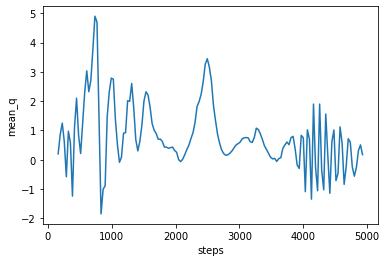

starting train 38
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 34s 35ms/step - reward: -2.2758 - cumulative_reward: 244.7111
train 38 completed. took 1026.873 seconds, total_reward: 518.8999999999872 total_profit: 0.786360329310567
min reward: -124.19999999999875, max reward: 140.1000000000008, mean_reward: 0.10484946453828799


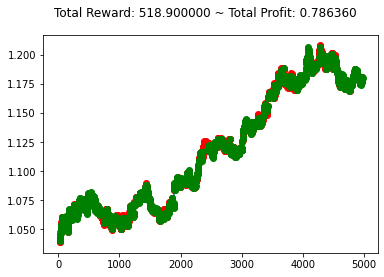

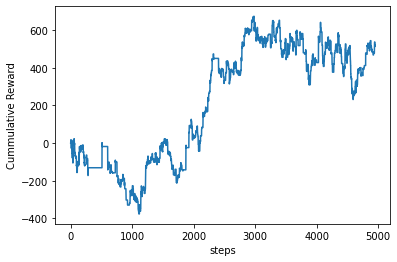

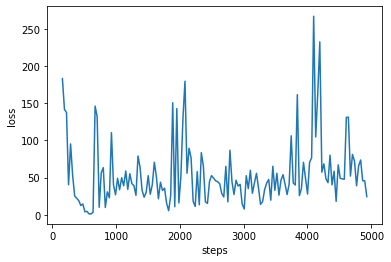

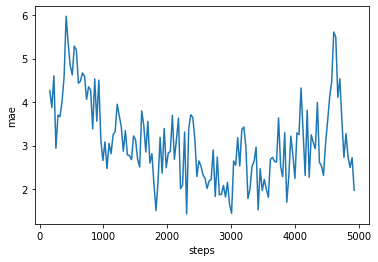

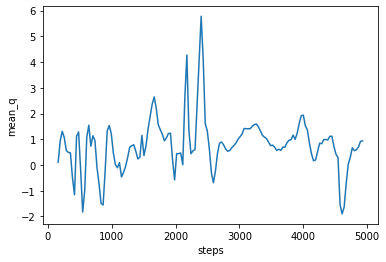

starting train 39
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 35s 36ms/step - reward: -0.4704 - cumulative_reward: -570.2315
train 39 completed. took 1071.252 seconds, total_reward: -465.5999999999703 total_profit: 0.7800378135604199
min reward: -139.59999999999974, max reward: 128.80000000000226, mean_reward: -0.09407961204283094


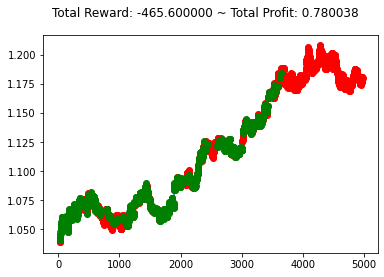

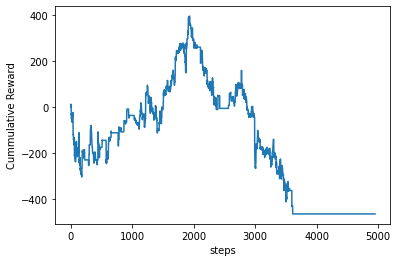

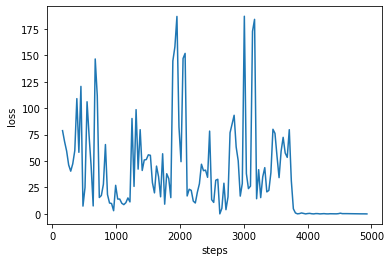

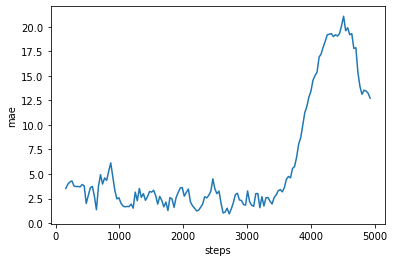

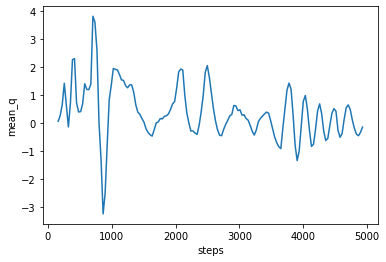

starting train 40
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 37s 37ms/step - reward: -0.7370 - cumulative_reward: -555.6071
train 40 completed. took 1116.598 seconds, total_reward: -729.4999999999895 total_profit: 0.8275153504359352
min reward: -228.3000000000013, max reward: 112.90000000000022, mean_reward: -0.14740351586178815


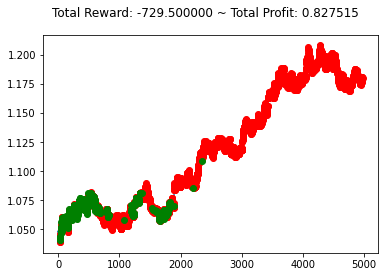

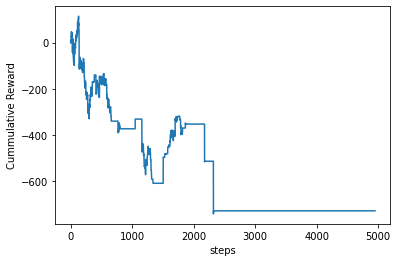

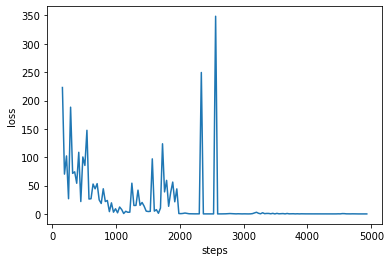

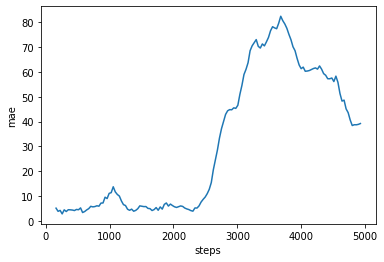

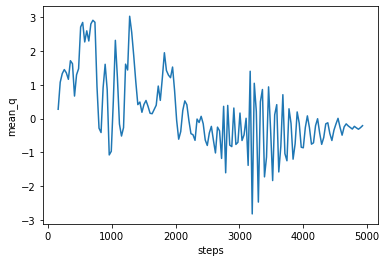

starting train 41
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 37s 37ms/step - reward: -0.1901 - cumulative_reward: -81.9366
train 41 completed. took 1162.533 seconds, total_reward: -188.19999999996952 total_profit: 0.9667045775749779
min reward: -67.99999999999918, max reward: 90.60000000000068, mean_reward: -0.03802788442108901


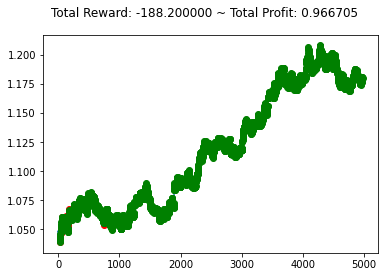

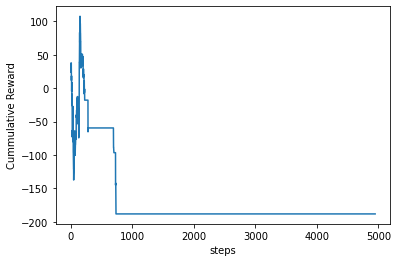

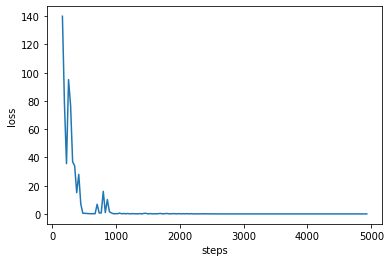

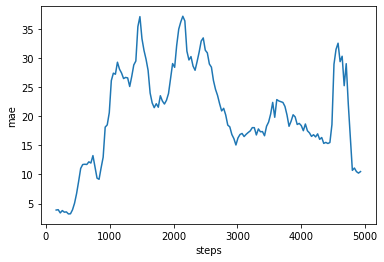

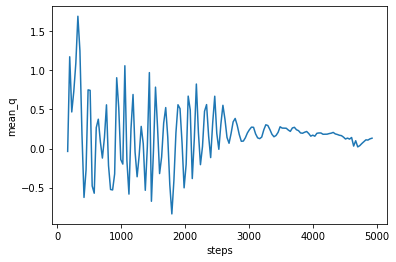

starting train 42
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 38s 38ms/step - reward: 0.8328 - cumulative_reward: 230.6094
train 42 completed. took 1209.799 seconds, total_reward: 824.2999999999713 total_profit: 0.860416307331593
min reward: -137.39999999999864, max reward: 361.29999999999995, mean_reward: 0.16655890078803218


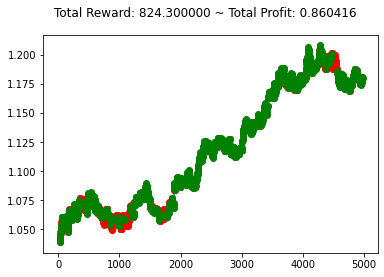

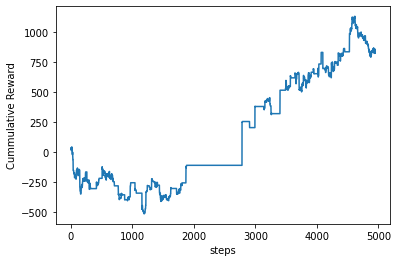

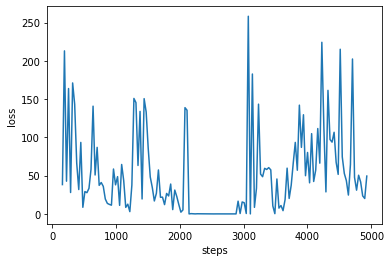

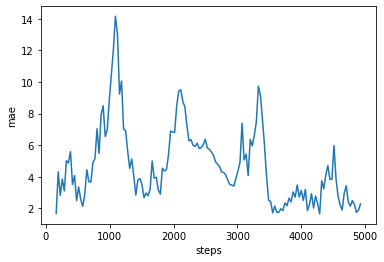

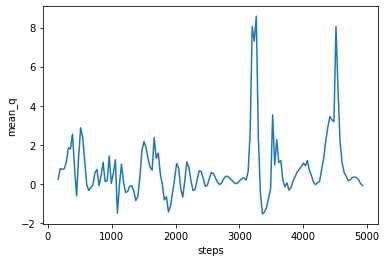

starting train 43
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 40s 40ms/step - reward: -22.9127 - cumulative_reward: -356.8558
train 43 completed. took 1263.644 seconds, total_reward: -705.3999999999699 total_profit: 0.7944214032340751
min reward: -129.00000000000134, max reward: 101.19999999999906, mean_reward: -0.14253384522125073


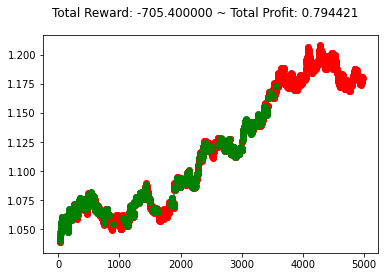

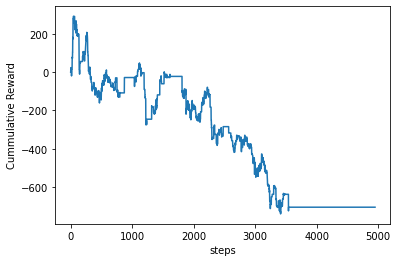

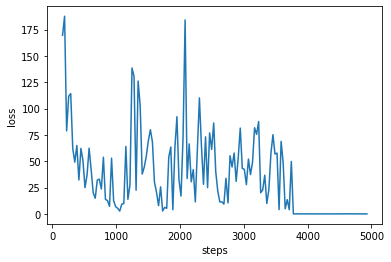

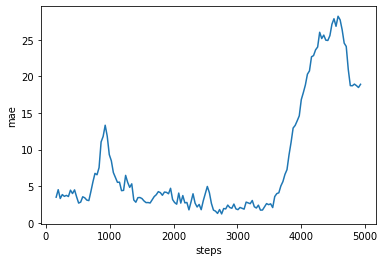

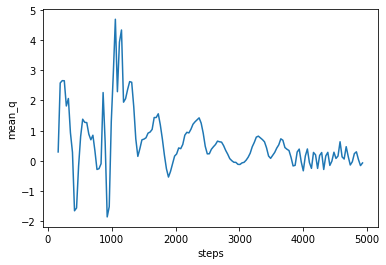

starting train 44
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 40s 40ms/step - reward: 6.0562 - cumulative_reward: -203.7881
train 44 completed. took 1313.170 seconds, total_reward: -439.299999999971 total_profit: 0.7417252701120015
min reward: -154.50000000000185, max reward: 188.80000000000007, mean_reward: -0.08876540715295433


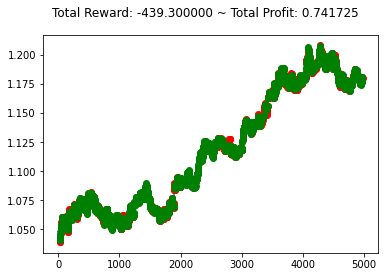

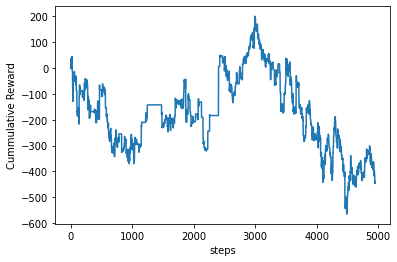

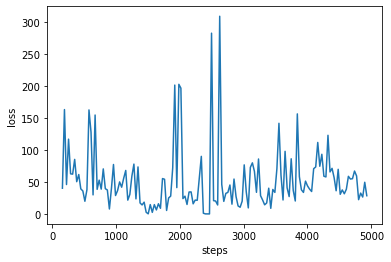

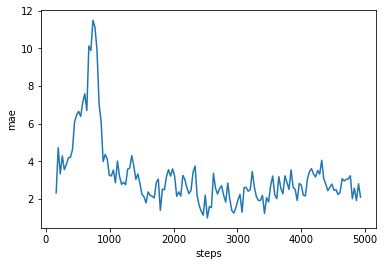

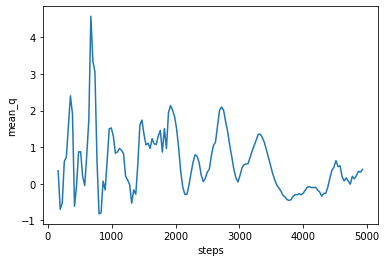

starting train 45
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 40s 40ms/step - reward: 0.6946 - cumulative_reward: 396.2575
train 45 completed. took 1362.435 seconds, total_reward: 687.5000000000367 total_profit: 0.8912342969491478
min reward: -87.3999999999997, max reward: 1144.8000000000013, mean_reward: 0.1389169529197892


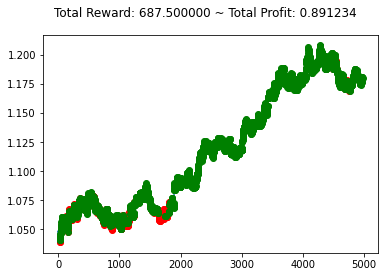

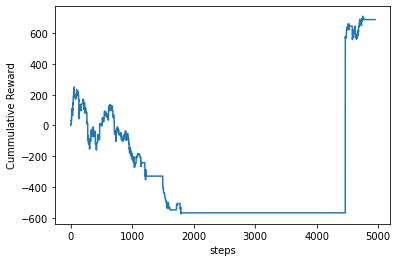

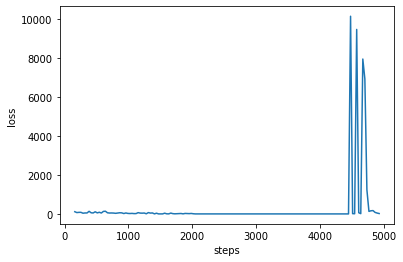

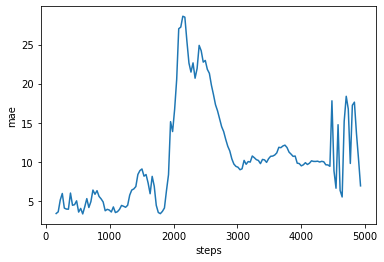

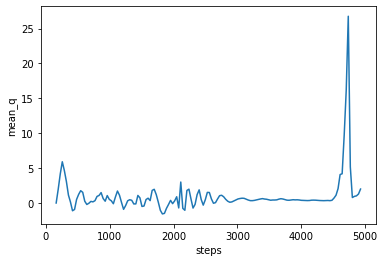

starting train 46
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 43s 44ms/step - reward: 0.4846 - cumulative_reward: 370.3871
train 46 completed. took 1415.551 seconds, total_reward: 479.6999999998782 total_profit: 0.8286605368677356
min reward: -110.09999999999964, max reward: 204.40000000000015, mean_reward: 0.09692867245905802


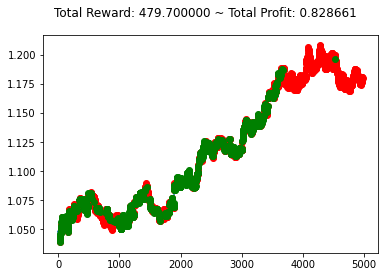

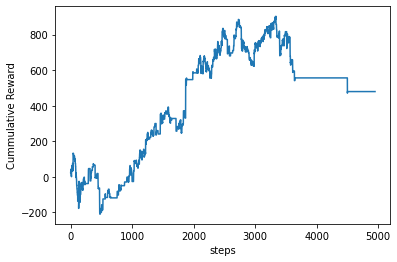

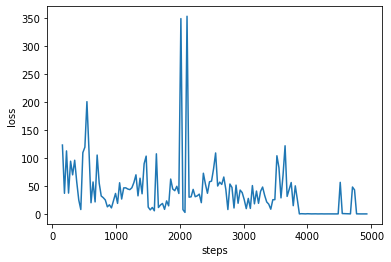

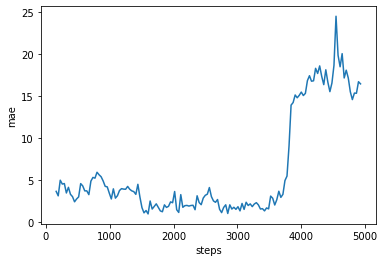

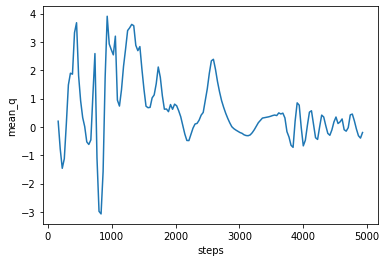

starting train 47
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 44s 45ms/step - reward: -0.5812 - cumulative_reward: -521.2107
train 47 completed. took 1470.593 seconds, total_reward: -575.2999999999743 total_profit: 0.8272710159018308
min reward: -99.20000000000151, max reward: 62.60000000000154, mean_reward: -0.11624570620326818


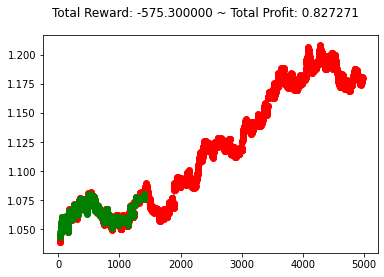

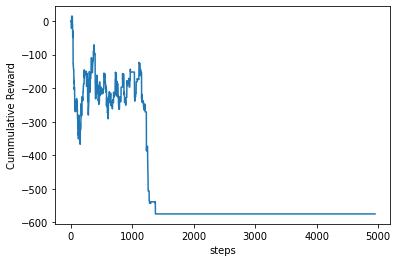

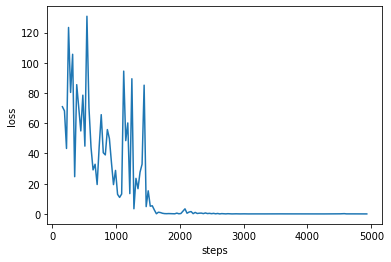

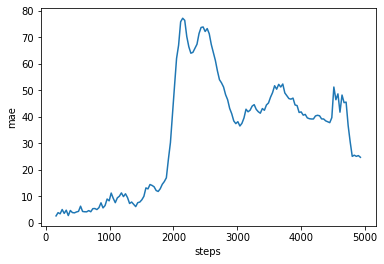

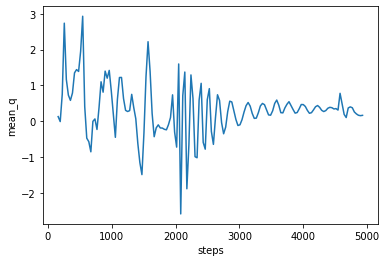

starting train 48
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 43s 43ms/step - reward: -0.6686 - cumulative_reward: -364.2825
train 48 completed. took 1524.087 seconds, total_reward: -661.800000000048 total_profit: 0.7610066643824466
min reward: -142.79999999999848, max reward: 154.50000000000185, mean_reward: -0.133723984643372


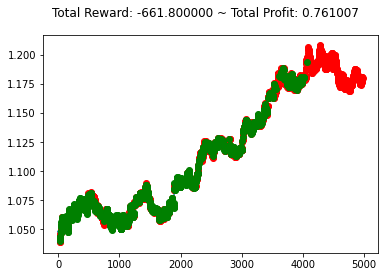

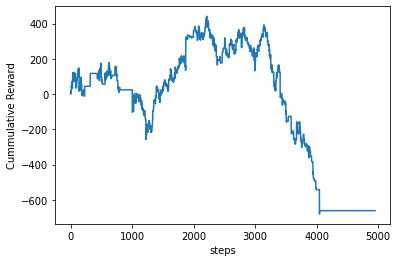

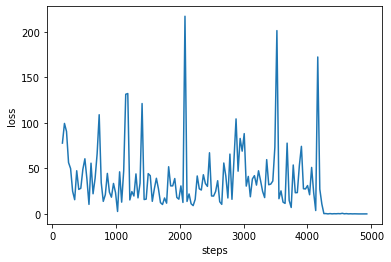

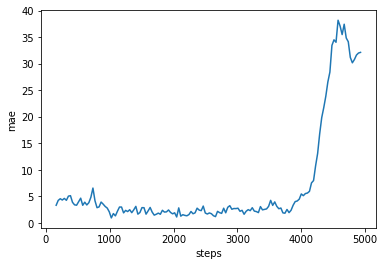

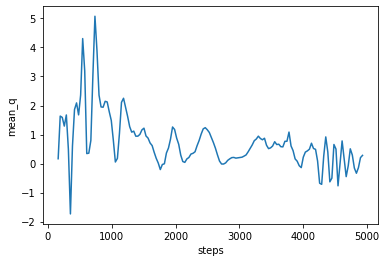

starting train 49
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 43s 44ms/step - reward: 0.0448 - cumulative_reward: 124.0689
train 49 completed. took 1578.096 seconds, total_reward: 44.29999999999312 total_profit: 0.8724920989923742
min reward: -131.90000000000035, max reward: 481.600000000002, mean_reward: 0.008951303293593275


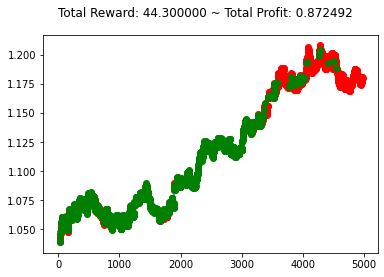

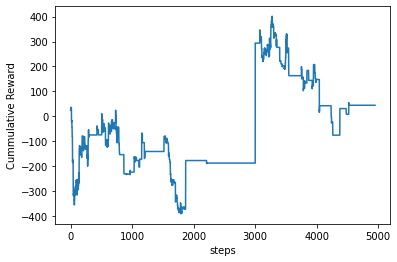

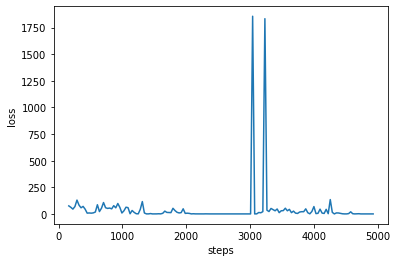

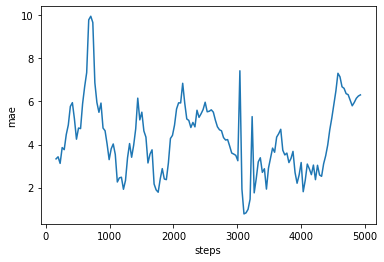

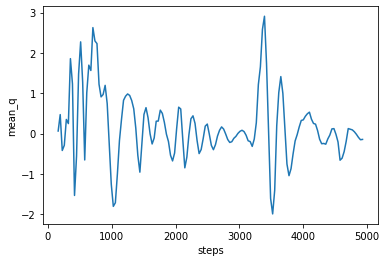

starting train 50
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 45s 45ms/step - reward: 14.1326 - cumulative_reward: 1010.7503
train 50 completed. took 1633.724 seconds, total_reward: 923.099999999948 total_profit: 0.907142279035496
min reward: -143.89999999999904, max reward: 1168.699999999998, mean_reward: 0.18652252980399028


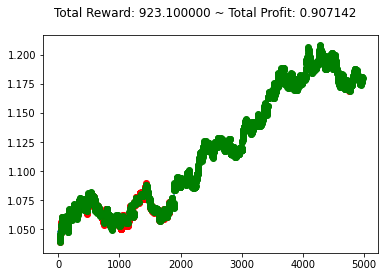

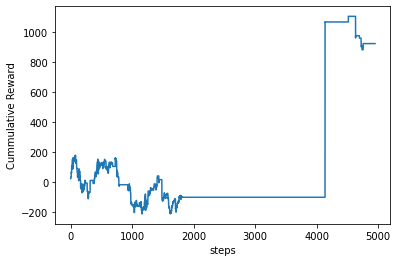

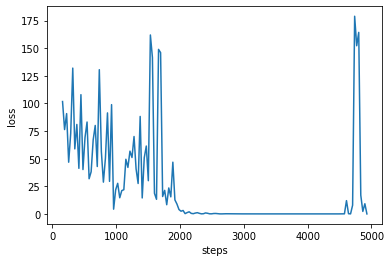

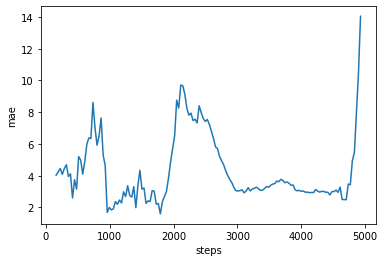

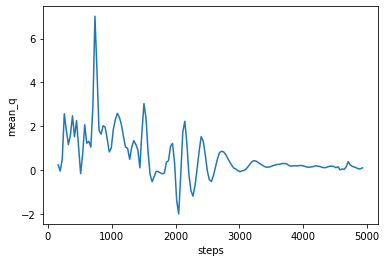

starting train 51
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 45s 46ms/step - reward: -27.9458 - cumulative_reward: 326.4689
train 51 completed. took 1690.127 seconds, total_reward: 647.4999999998657 total_profit: 0.7947392329932476
min reward: -140.5000000000012, max reward: 183.7, mean_reward: 0.1308345120226037


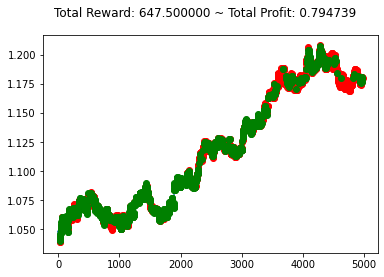

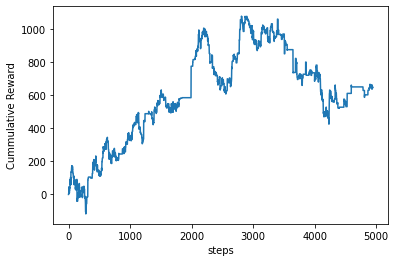

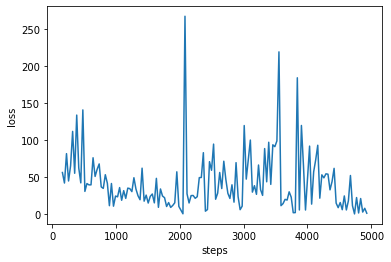

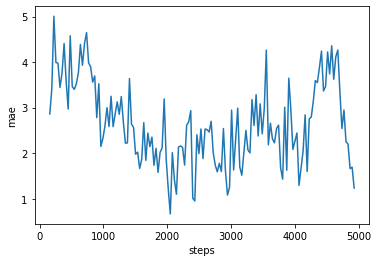

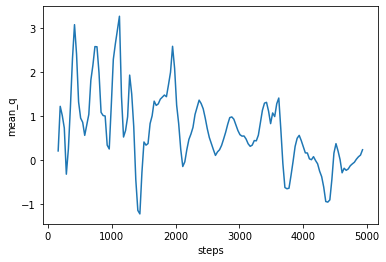

starting train 52
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 47s 48ms/step - reward: -13.9088 - cumulative_reward: -31.0421
train 52 completed. took 1749.411 seconds, total_reward: 783.1000000000993 total_profit: 0.80038398293518
min reward: -113.49999999999972, max reward: 131.30000000000086, mean_reward: 0.15823398666399258


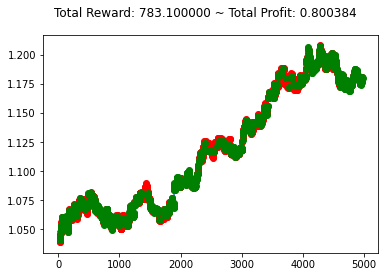

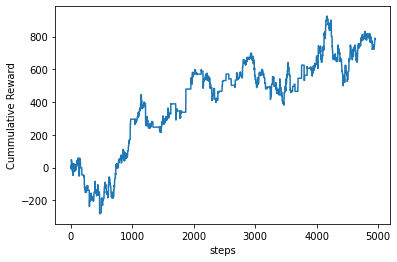

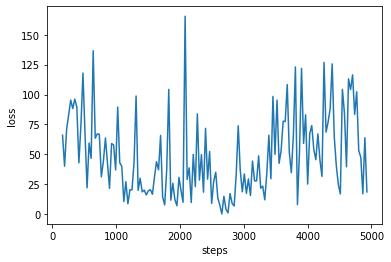

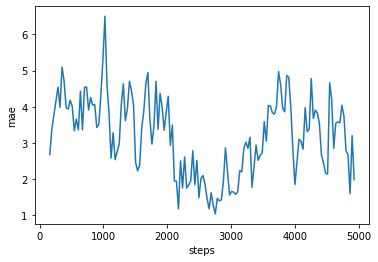

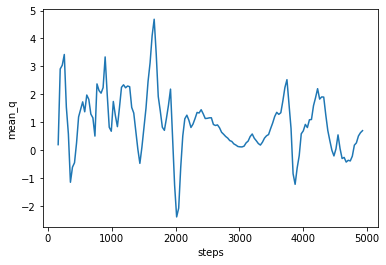

starting train 53
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 46s 47ms/step - reward: 0.8716 - cumulative_reward: 824.4764
train 53 completed. took 1807.566 seconds, total_reward: 862.7000000000522 total_profit: 0.9016934623814922
min reward: -102.19999999999897, max reward: 1071.5999999999992, mean_reward: 0.17431804404931345


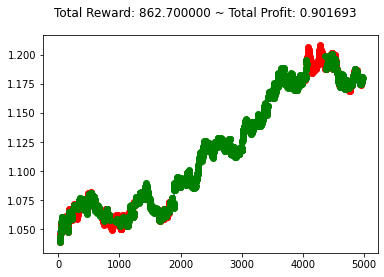

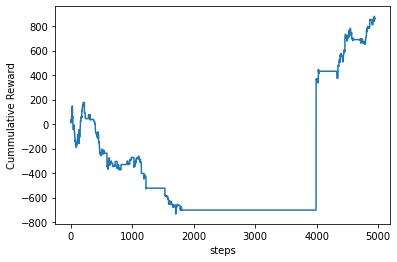

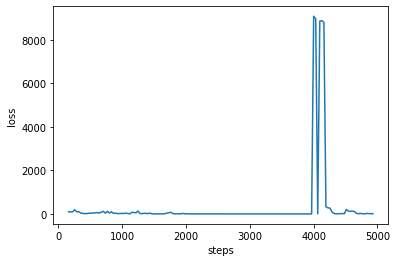

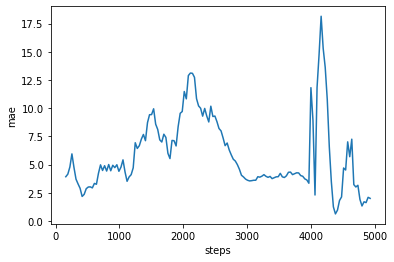

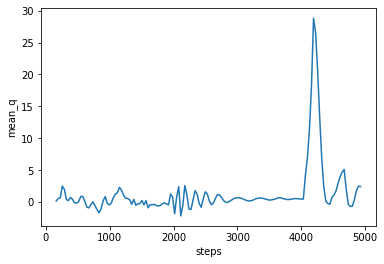

starting train 54
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 47s 48ms/step - reward: -11.9306 - cumulative_reward: 4.7864
train 54 completed. took 1866.732 seconds, total_reward: 167.70000000014153 total_profit: 0.7455014976938409
min reward: -199.30000000000004, max reward: 121.49999999999883, mean_reward: 0.033885633461333914


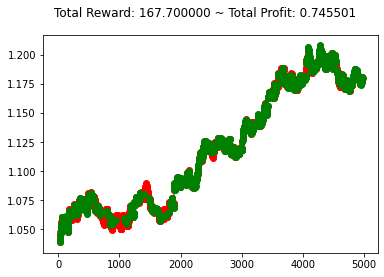

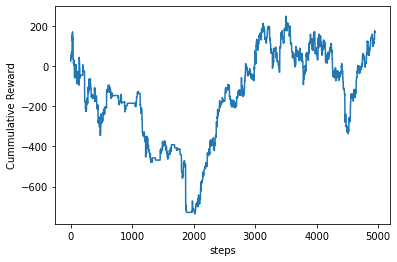

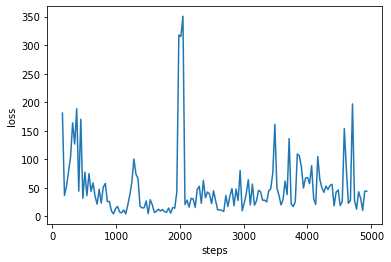

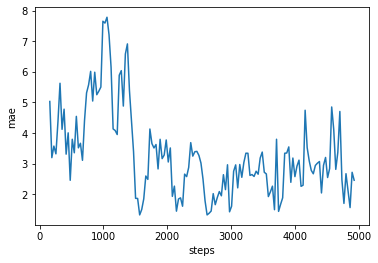

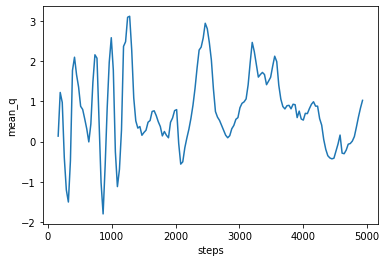

starting train 55
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 48s 49ms/step - reward: 6.4115 - cumulative_reward: -230.2148
train 55 completed. took 1927.207 seconds, total_reward: -384.4999999999876 total_profit: 0.8187864668608501
min reward: -354.1000000000016, max reward: 147.20000000000067, mean_reward: -0.0776924631238609


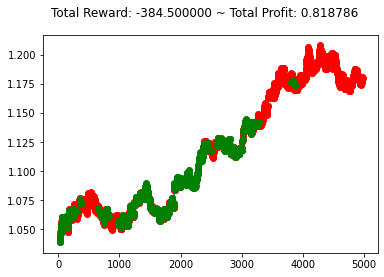

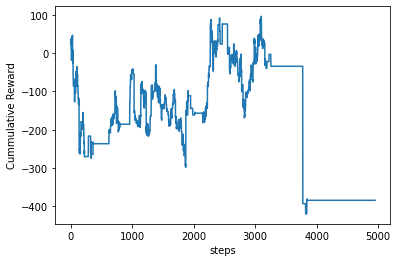

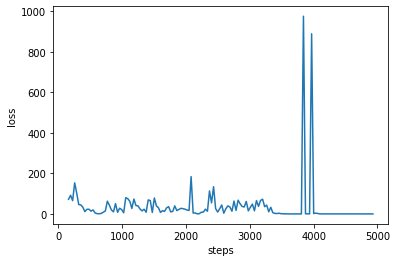

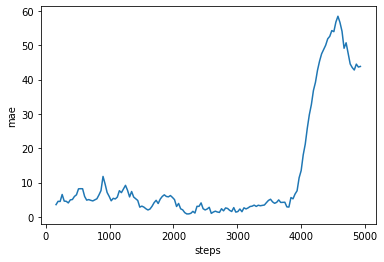

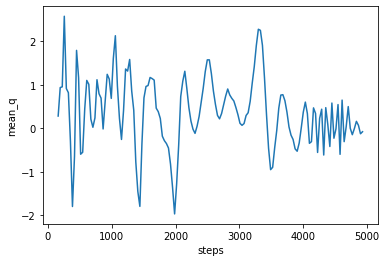

starting train 56
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 49s 50ms/step - reward: -0.5981 - cumulative_reward: -328.9771
train 56 completed. took 1989.860 seconds, total_reward: -591.9999999999991 total_profit: 0.9247101420431809
min reward: -88.6000000000009, max reward: 75.20000000000194, mean_reward: -0.11962012527783372


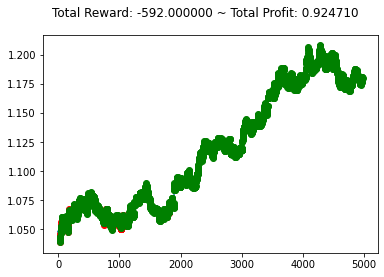

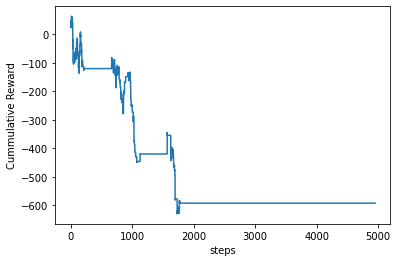

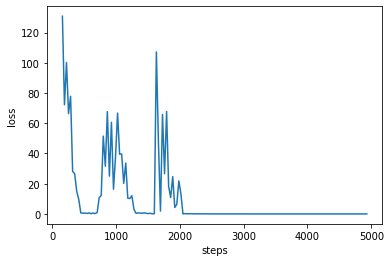

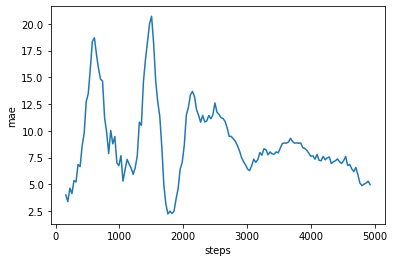

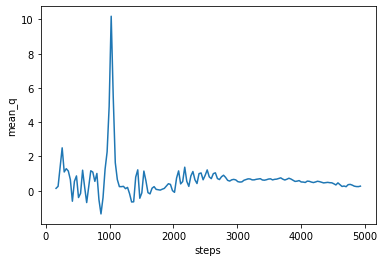

starting train 57
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 52s 53ms/step - reward: 0.1322 - cumulative_reward: -84.0871
train 57 completed. took 2054.873 seconds, total_reward: 130.89999999999873 total_profit: 0.7736792473162118
min reward: -130.00000000000122, max reward: 149.49999999999795, mean_reward: 0.026449787835926192


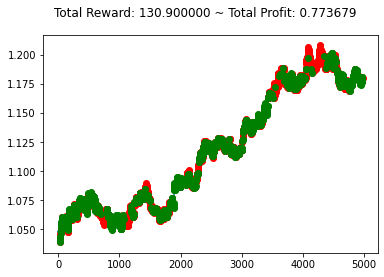

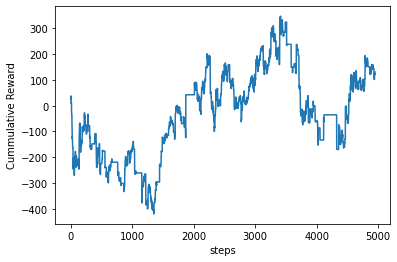

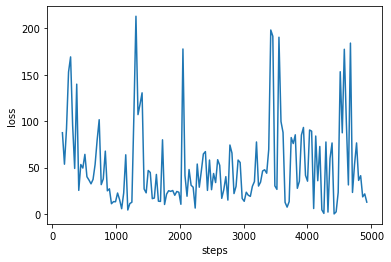

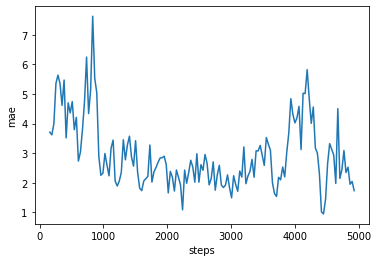

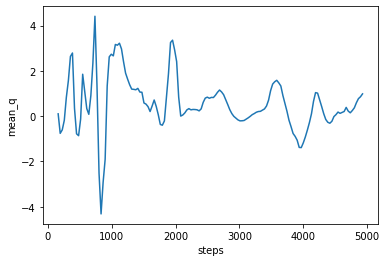

starting train 58
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 51s 52ms/step - reward: 10.8884 - cumulative_reward: 535.0923
train 58 completed. took 2119.017 seconds, total_reward: 384.4000000000176 total_profit: 0.8542846299977205
min reward: -129.69999999999925, max reward: 124.10000000000032, mean_reward: 0.07767225702162409


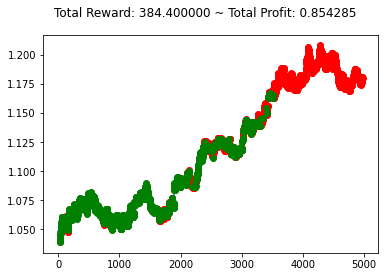

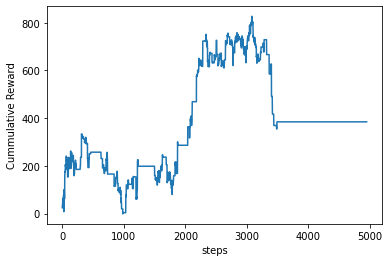

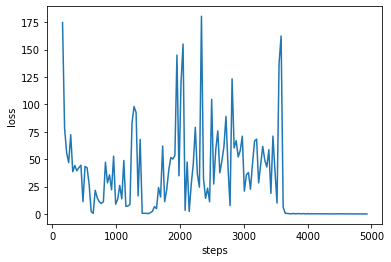

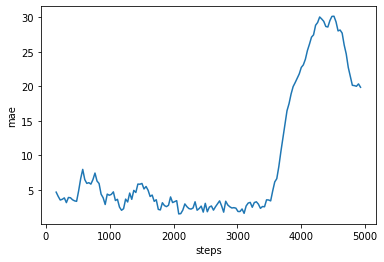

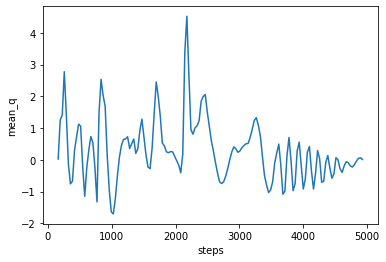

starting train 59
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 53s 54ms/step - reward: 13.9999 - cumulative_reward: 107.2278
train 59 completed. took 2185.815 seconds, total_reward: -0.09999999988922426 total_profit: 0.772130380587148
min reward: -199.30000000000004, max reward: 141.7999999999986, mean_reward: -2.020610222049389e-05


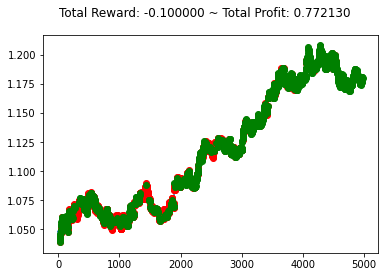

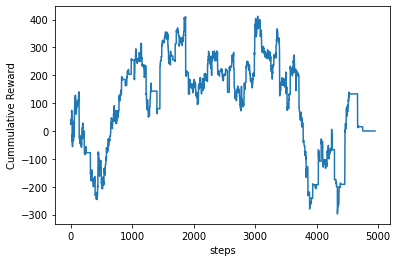

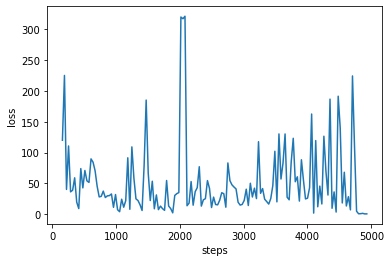

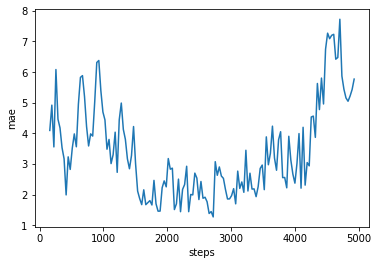

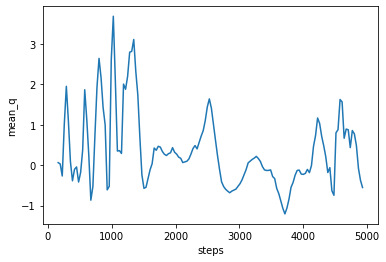

starting train 60
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 56s 57ms/step - reward: -13.8302 - cumulative_reward: -332.4737
train 60 completed. took 2255.673 seconds, total_reward: -623.8000000000192 total_profit: 0.9111273551032646
min reward: -95.09999999999907, max reward: 72.60000000000045, mean_reward: -0.12604566579107276


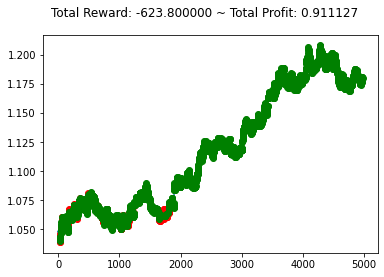

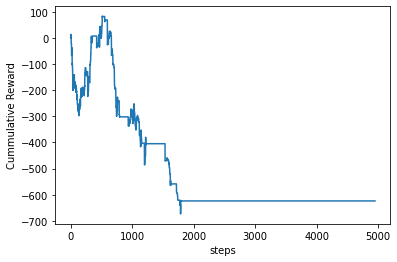

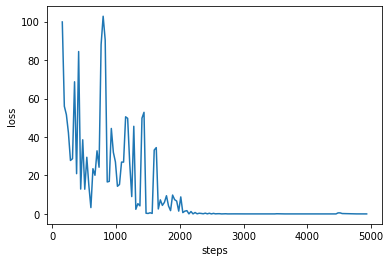

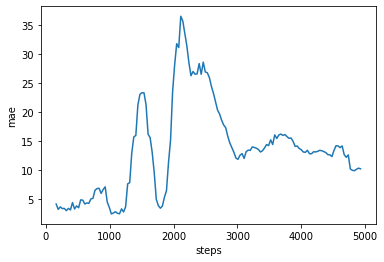

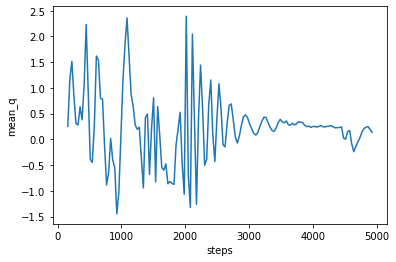

starting train 61
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 56s 57ms/step - reward: 10.9252 - cumulative_reward: 100.1108
train 61 completed. took 2325.852 seconds, total_reward: 420.89999999998906 total_profit: 0.7759132817155746
min reward: -110.00000000000121, max reward: 195.19999999999982, mean_reward: 0.08504748434026856


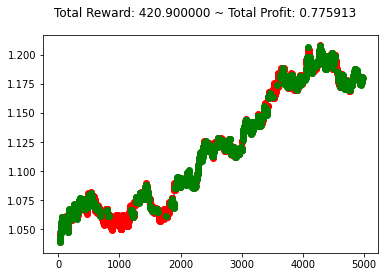

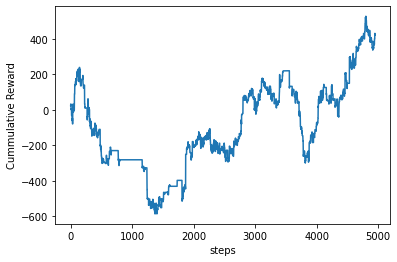

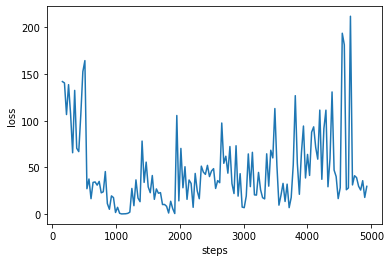

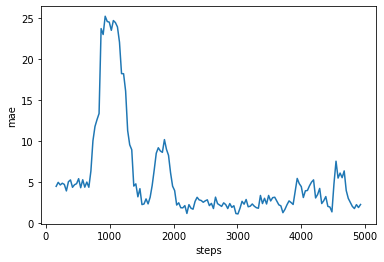

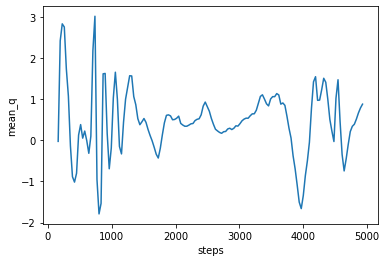

starting train 62
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 57s 57ms/step - reward: -11.6487 - cumulative_reward: -980.5863
train 62 completed. took 2396.694 seconds, total_reward: -1137.0000000000593 total_profit: 0.7695056951494214
min reward: -134.19999999999987, max reward: 199.30000000000004, mean_reward: -0.22974338250152745


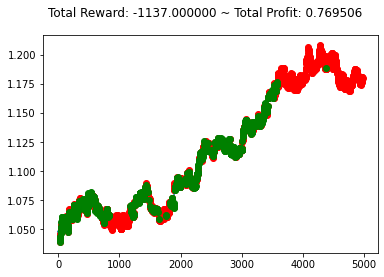

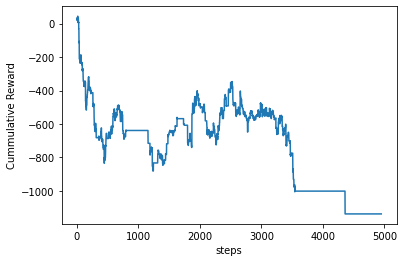

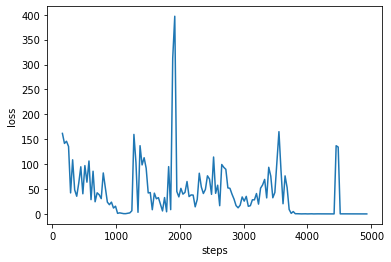

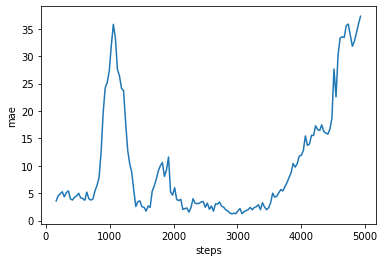

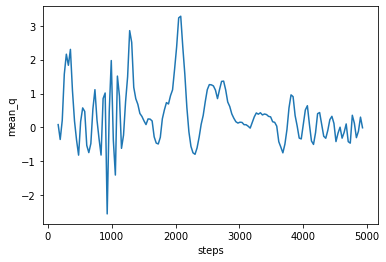

starting train 63
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 58s 58ms/step - reward: 0.2910 - cumulative_reward: 80.6492
train 63 completed. took 2468.909 seconds, total_reward: 287.9999999999417 total_profit: 0.8362732559604221
min reward: -134.49999999999963, max reward: 170.40000000000165, mean_reward: 0.058193574459474984


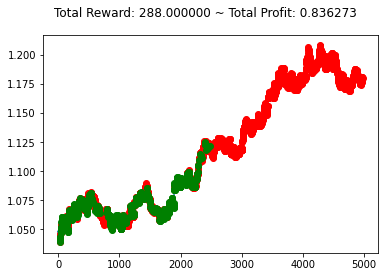

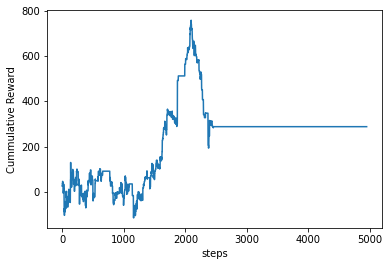

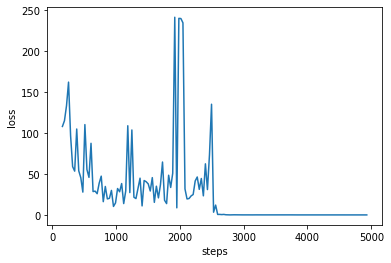

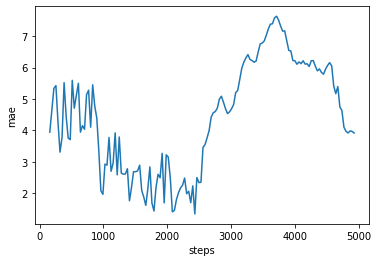

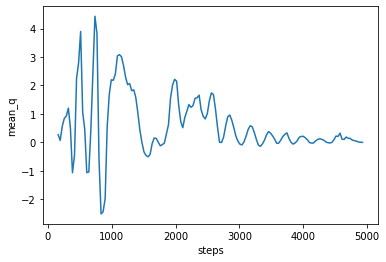

starting train 64
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 59s 59ms/step - reward: 11.7760 - cumulative_reward: -542.3139
train 64 completed. took 2542.944 seconds, total_reward: -320.70000000001124 total_profit: 0.7680190989447022
min reward: -184.29999999999947, max reward: 120.89999999999934, mean_reward: -0.06480096989290993


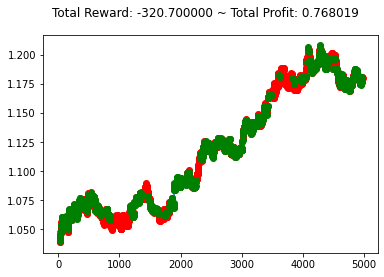

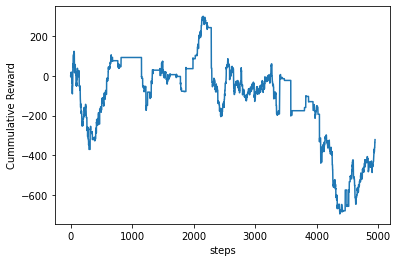

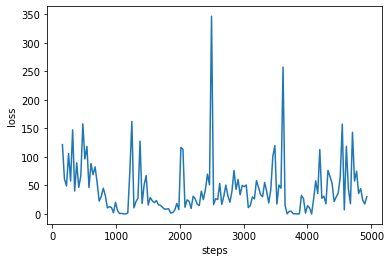

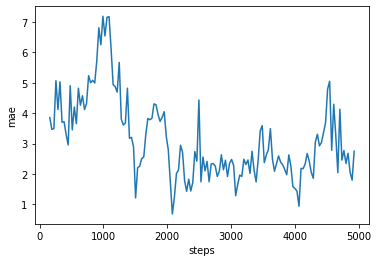

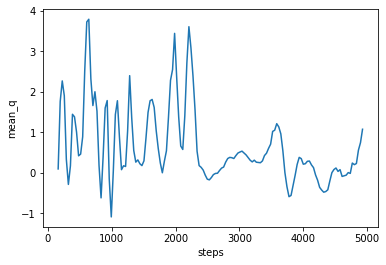

starting train 65
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 58s 59ms/step - reward: -15.8497 - cumulative_reward: -139.2122
train 65 completed. took 2615.344 seconds, total_reward: -148.19999999993573 total_profit: 0.7649082947458108
min reward: -156.40000000000097, max reward: 154.50000000000185, mean_reward: -0.029945443523931244


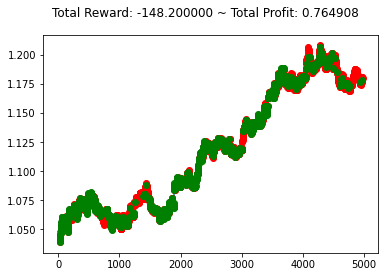

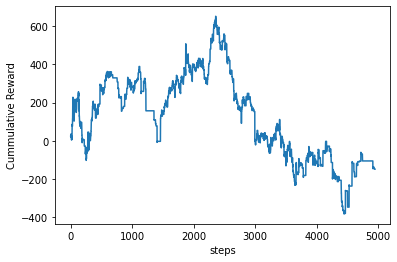

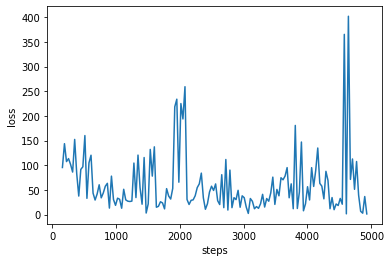

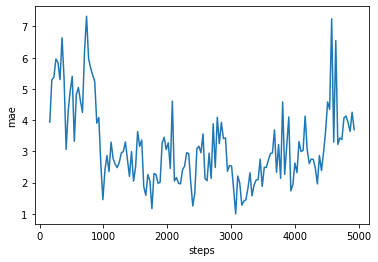

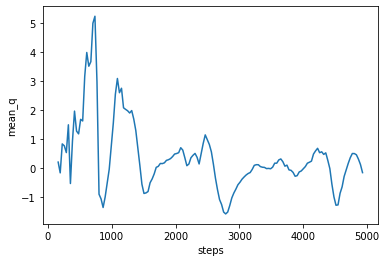

starting train 66
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 57s 58ms/step - reward: -0.2106 - cumulative_reward: -113.7363
train 66 completed. took 2687.426 seconds, total_reward: -208.49999999994918 total_profit: 0.8301071581918215
min reward: -319.0000000000004, max reward: 155.29999999999822, mean_reward: -0.042129723176389


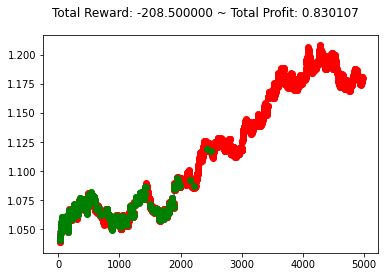

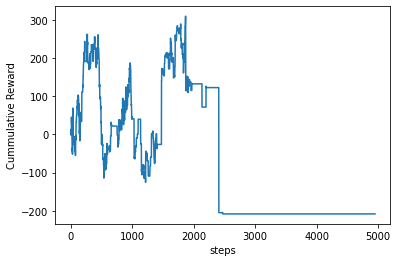

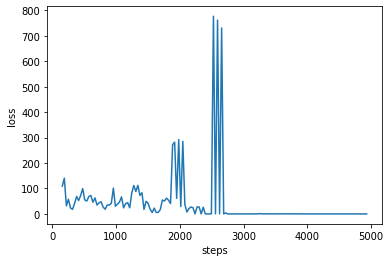

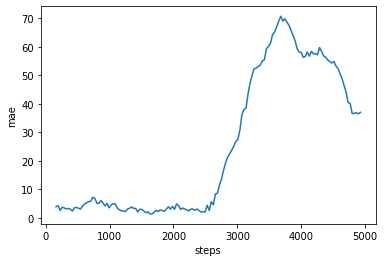

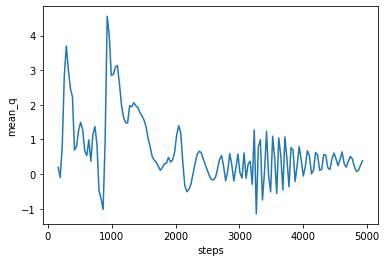

starting train 67
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 58s 59ms/step - reward: 3.0373 - cumulative_reward: 166.7190
train 67 completed. took 2759.992 seconds, total_reward: 333.9000000000669 total_profit: 0.766635892287704
min reward: -129.00000000000134, max reward: 147.20000000000067, mean_reward: 0.06746817538898098


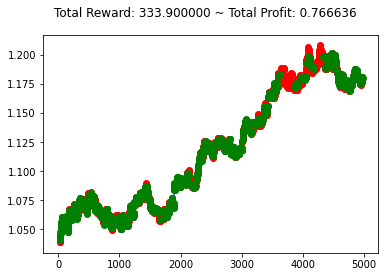

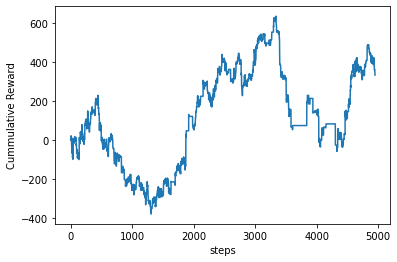

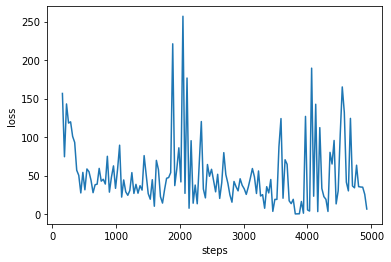

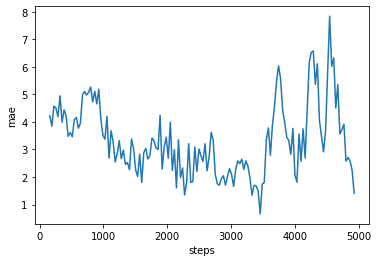

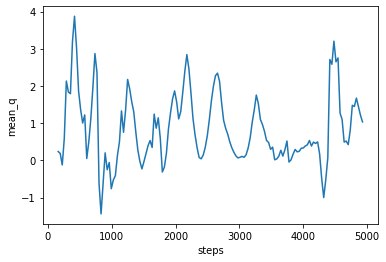

starting train 68
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 59s 60ms/step - reward: 1.2843 - cumulative_reward: 612.3649
train 68 completed. took 2834.544 seconds, total_reward: 1271.2000000000103 total_profit: 0.9325948023983093
min reward: -121.29999999999974, max reward: 1166.8999999999996, mean_reward: 0.2568599717114589


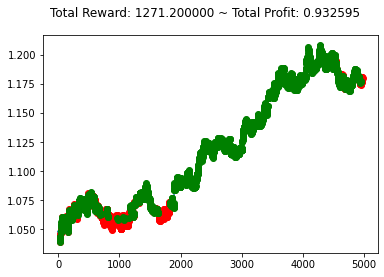

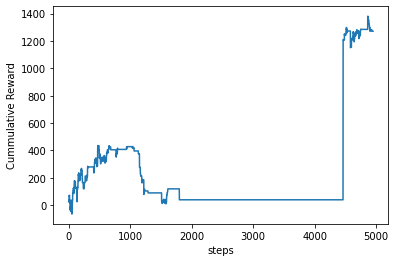

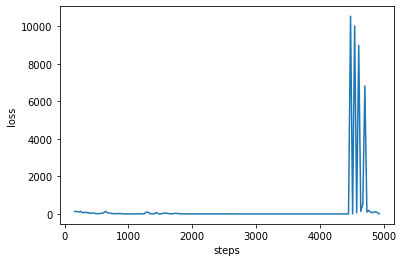

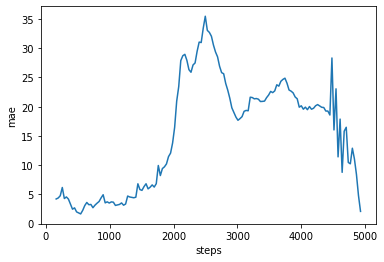

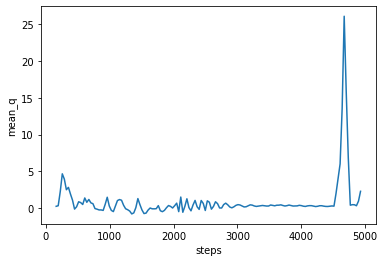

starting train 69
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 60s 60ms/step - reward: 20.7237 - cumulative_reward: -672.1432
train 69 completed. took 2909.995 seconds, total_reward: -1164.2999999999695 total_profit: 0.7843272948970771
min reward: -175.70000000000084, max reward: 120.70000000000248, mean_reward: -0.2352596484138148


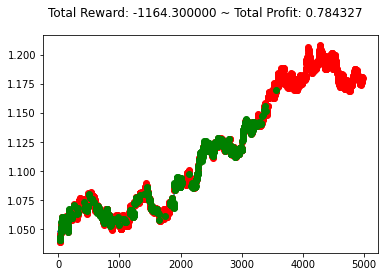

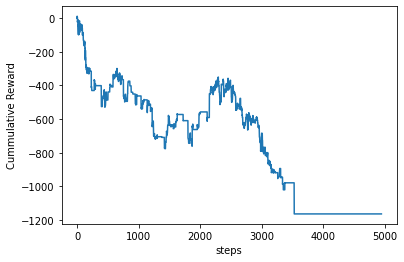

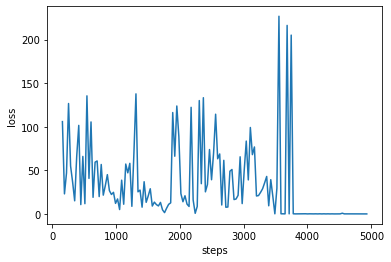

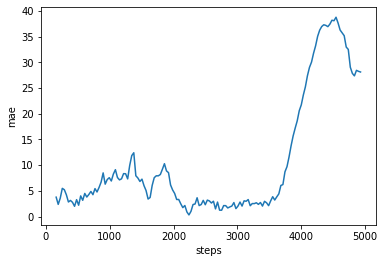

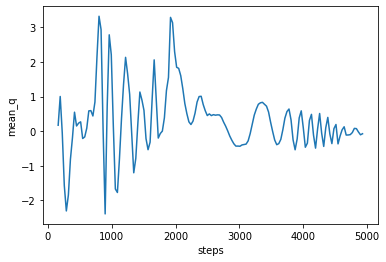

starting train 70
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 61s 61ms/step - reward: 0.3156 - cumulative_reward: -25.2990
train 70 completed. took 2985.822 seconds, total_reward: 312.4000000000191 total_profit: 0.9126721353727901
min reward: -118.69999999999825, max reward: 1054.0999999999979, mean_reward: 0.06312386340675269


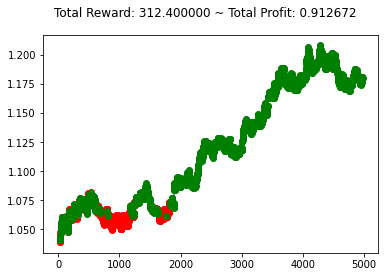

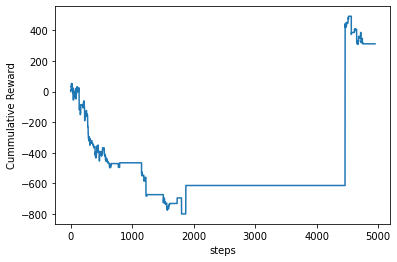

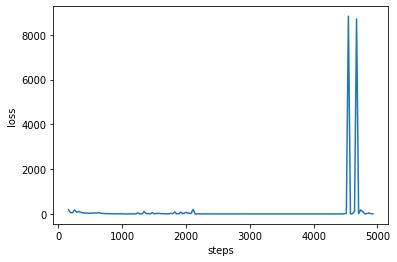

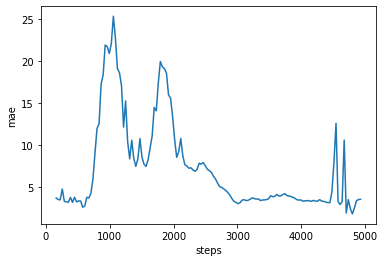

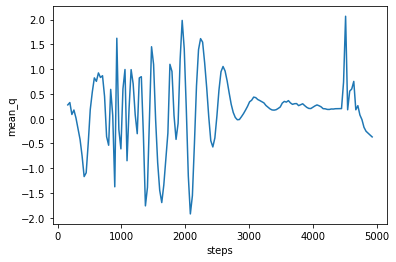

starting train 71
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 62s 62ms/step - reward: -10.1339 - cumulative_reward: -30.7230
train 71 completed. took 3063.149 seconds, total_reward: -231.5000000000333 total_profit: 0.8310714897058369
min reward: -174.50000000000188, max reward: 98.09999999999874, mean_reward: -0.046777126692267794


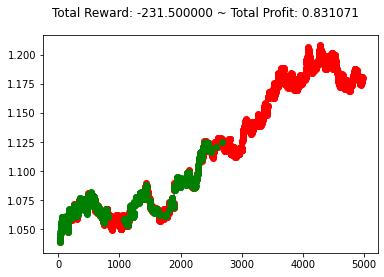

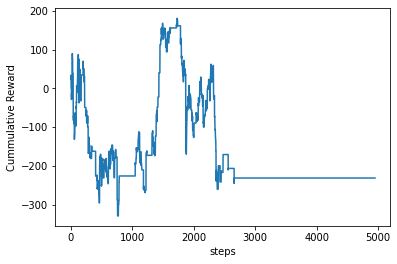

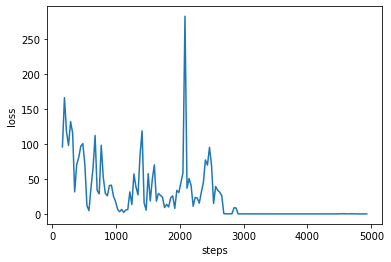

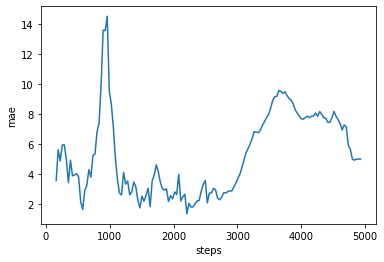

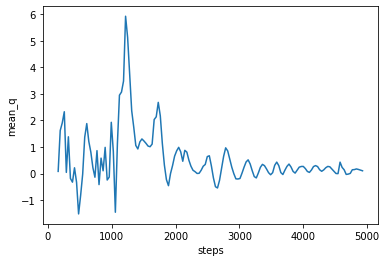

starting train 72
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 62s 63ms/step - reward: 15.3393 - cumulative_reward: 309.4332
train 72 completed. took 3141.422 seconds, total_reward: 38.90000000011479 total_profit: 0.7457850214737969
min reward: -117.49999999999928, max reward: 189.20000000000047, mean_reward: 0.007860173772502482


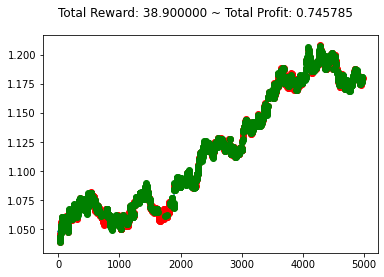

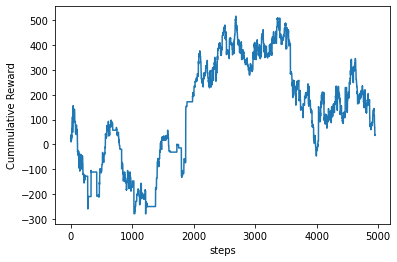

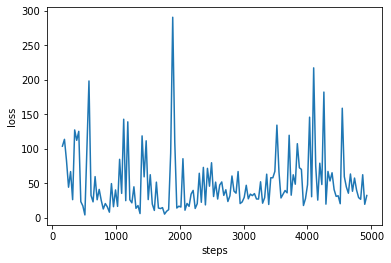

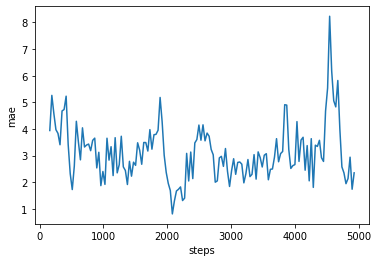

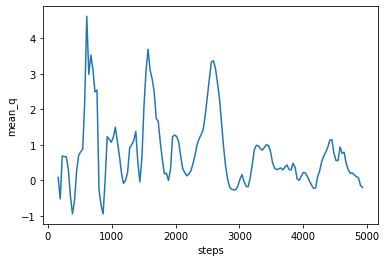

starting train 73
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 71s 71ms/step - reward: 33.9450 - cumulative_reward: 263.2180
train 73 completed. took 3223.618 seconds, total_reward: 44.500000000044125 total_profit: 0.7669045319759977
min reward: -117.50000000000149, max reward: 214.19999999999993, mean_reward: 0.008991715498089336


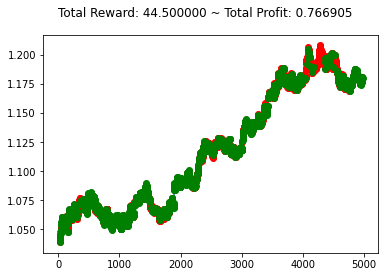

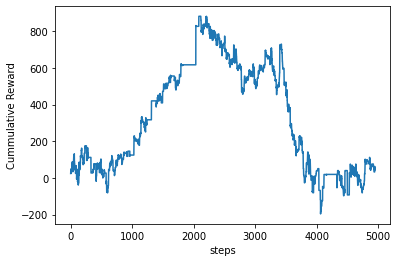

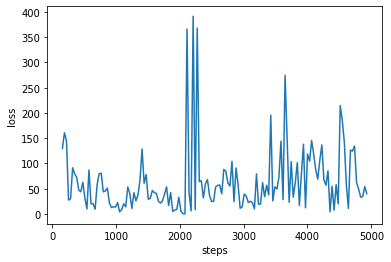

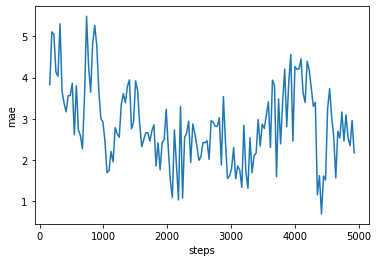

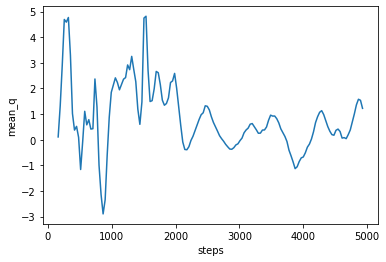

starting train 74
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 63s 64ms/step - reward: 0.2863 - cumulative_reward: 198.3965
train 74 completed. took 3302.730 seconds, total_reward: 283.3999999999737 total_profit: 0.9413074812453981
min reward: -90.09999999999962, max reward: 118.00000000000033, mean_reward: 0.057264093756309094


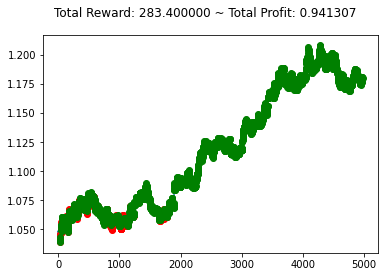

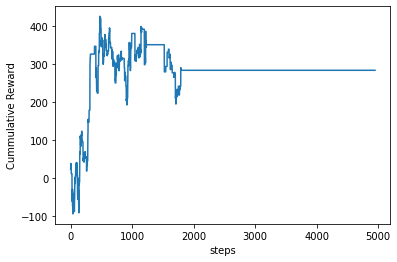

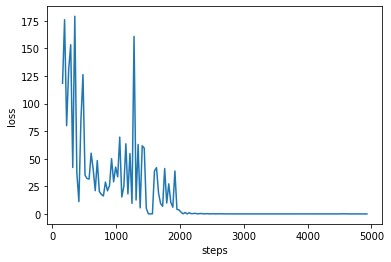

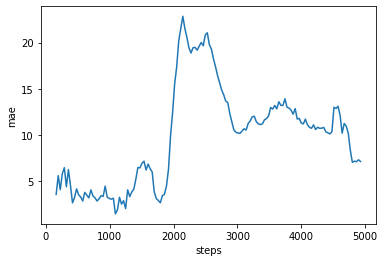

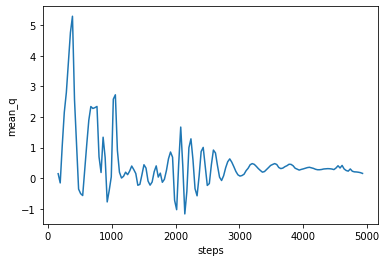

starting train 75
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 65s 66ms/step - reward: 0.1762 - cumulative_reward: 168.0582
train 75 completed. took 3383.839 seconds, total_reward: 174.40000000005207 total_profit: 0.8427503234194993
min reward: -109.90000000000055, max reward: 123.29999999999953, mean_reward: 0.03523944231158862


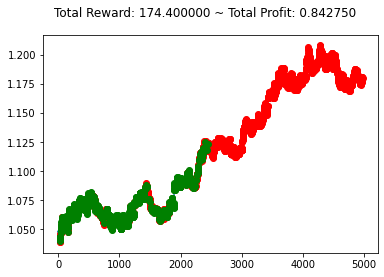

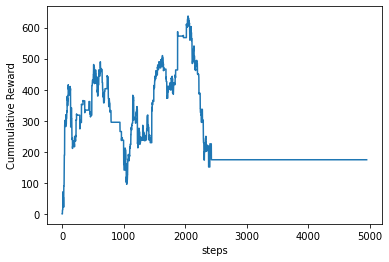

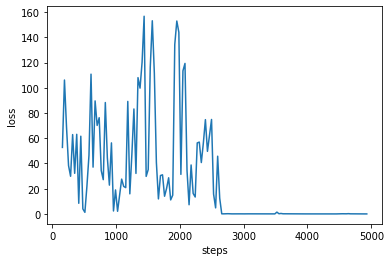

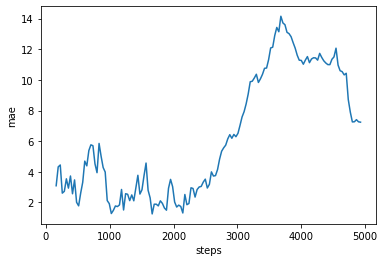

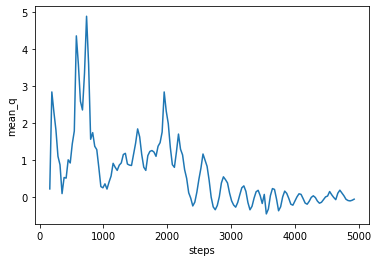

starting train 76
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 67s 68ms/step - reward: 0.0791 - cumulative_reward: -37.8863
train 76 completed. took 3468.126 seconds, total_reward: 78.2999999999343 total_profit: 0.8566912955242618
min reward: -139.49999999999906, max reward: 324.9999999999997, mean_reward: 0.01582137805615969


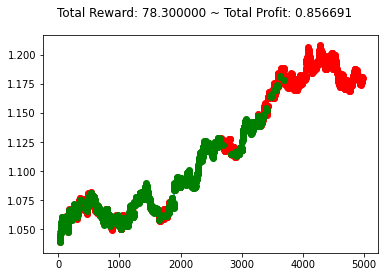

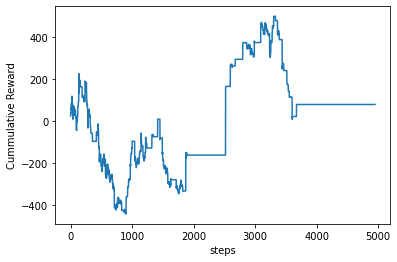

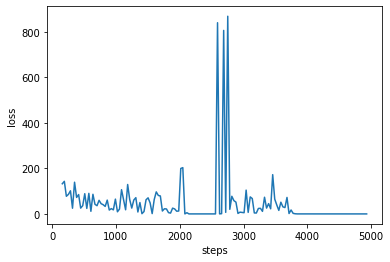

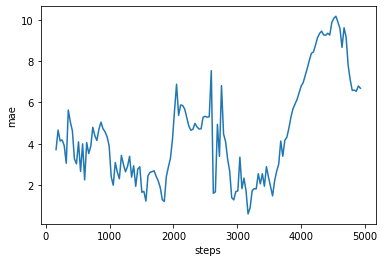

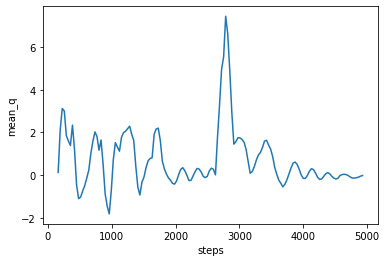

starting train 77
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 71s 72ms/step - reward: -13.1199 - cumulative_reward: 11.9428
train 77 completed. took 3557.187 seconds, total_reward: 79.30000000001085 total_profit: 0.8285013554768157
min reward: -239.90000000000177, max reward: 151.39999999999932, mean_reward: 0.01602343907860393


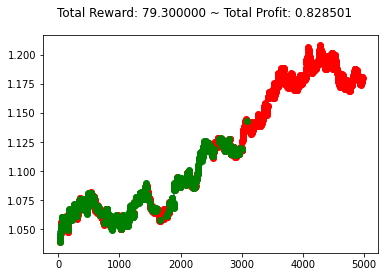

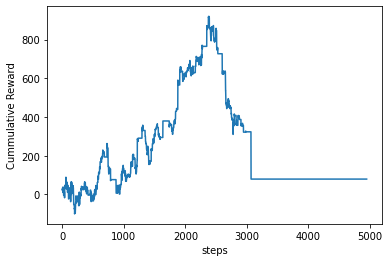

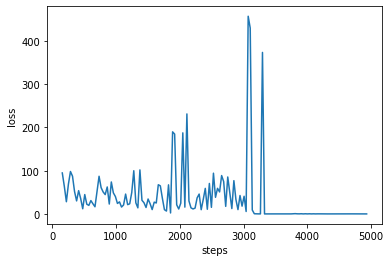

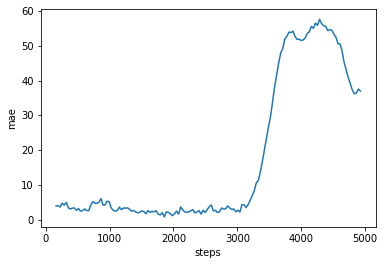

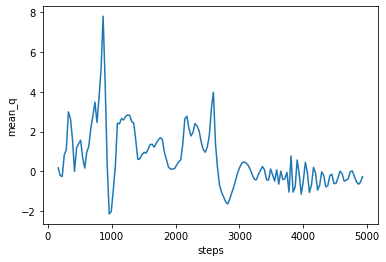

starting train 78
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 70s 71ms/step - reward: -1.1221 - cumulative_reward: -554.8384
train 78 completed. took 3645.254 seconds, total_reward: -1110.7000000000535 total_profit: 0.8398124023849559
min reward: -1059.2, max reward: 107.80000000000013, mean_reward: -0.22442917761164952


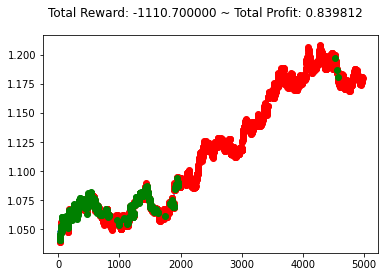

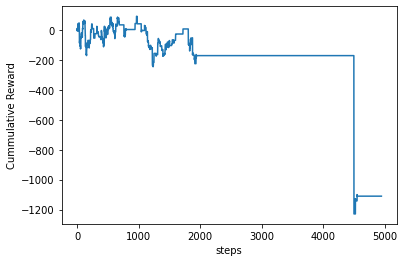

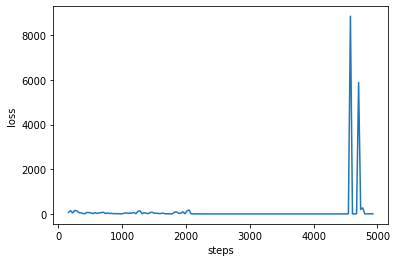

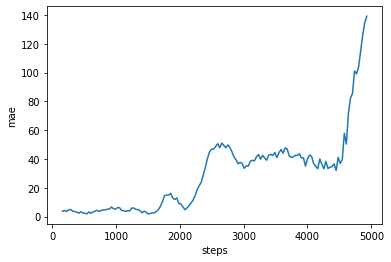

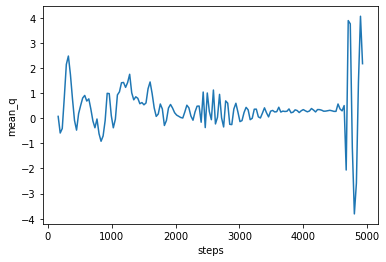

starting train 79
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 69s 69ms/step - reward: -0.6033 - cumulative_reward: -251.4365
train 79 completed. took 3732.431 seconds, total_reward: -597.1000000000234 total_profit: 0.8256744861959092
min reward: -145.29999999999933, max reward: 73.49999999999967, mean_reward: -0.12065063649222539


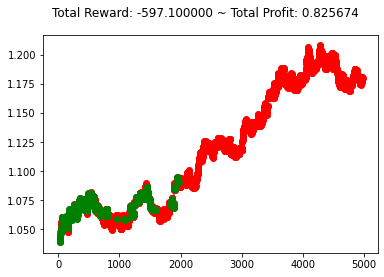

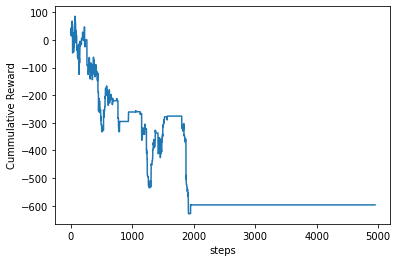

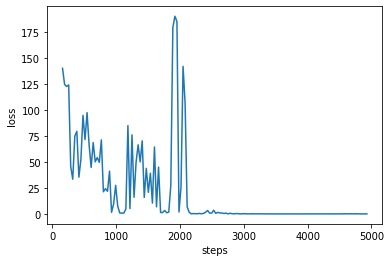

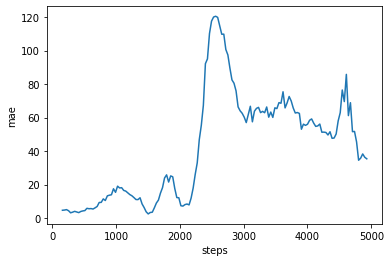

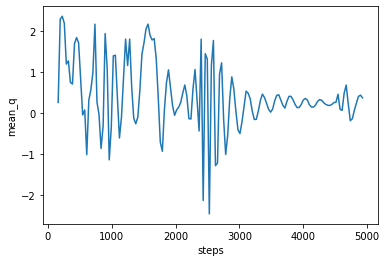

starting train 80
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 69s 70ms/step - reward: -0.1110 - cumulative_reward: -180.5473
train 80 completed. took 3819.586 seconds, total_reward: -109.90000000001815 total_profit: 0.8171569992277984
min reward: -127.89999999999857, max reward: 125.70000000000192, mean_reward: -0.022206506364925875


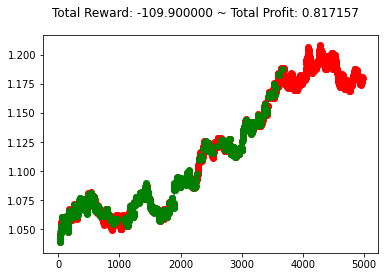

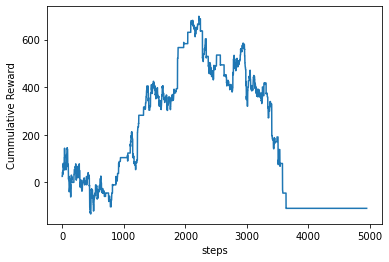

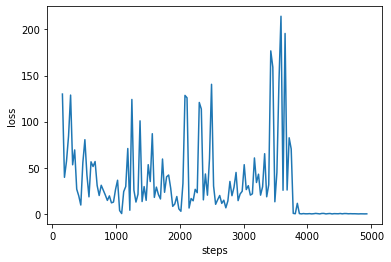

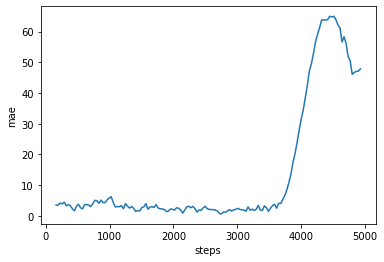

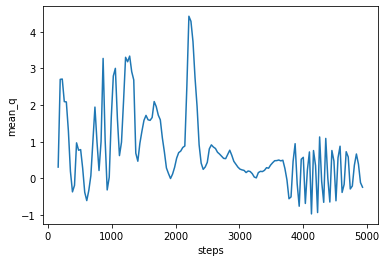

starting train 81
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 70s 71ms/step - reward: 10.1848 - cumulative_reward: -744.9877
train 81 completed. took 3907.611 seconds, total_reward: -1103.7999999999824 total_profit: 0.7863676487988664
min reward: -122.79999999999846, max reward: 238.30000000000018, mean_reward: -0.22303495655687663


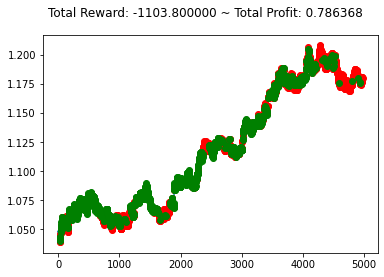

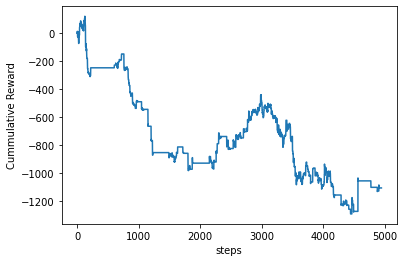

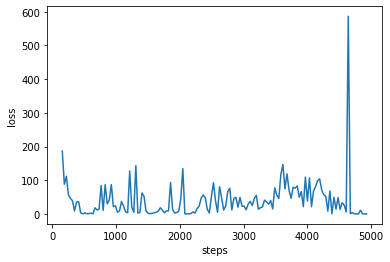

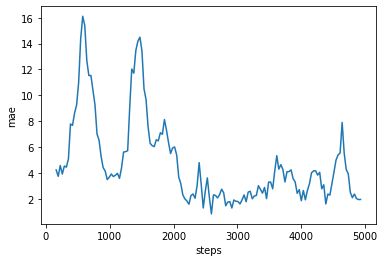

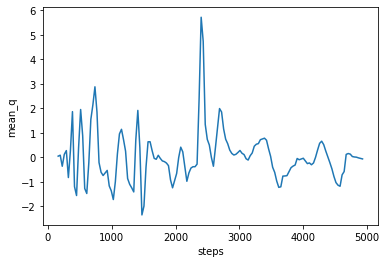

starting train 82
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 72s 73ms/step - reward: -0.4040 - cumulative_reward: -320.2531
train 82 completed. took 3999.884 seconds, total_reward: -399.8999999999997 total_profit: 0.8508898043119704
min reward: -104.50000000000071, max reward: 57.39999999999856, mean_reward: -0.08080420286926646


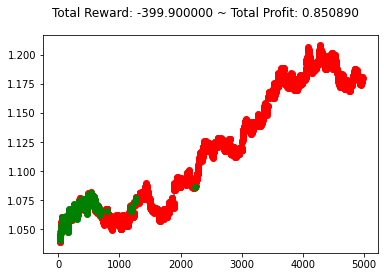

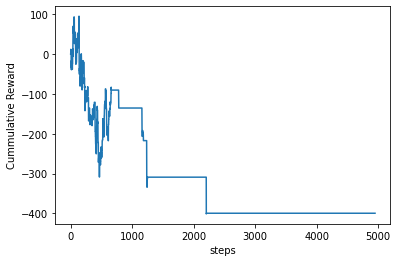

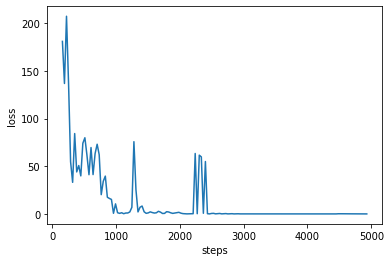

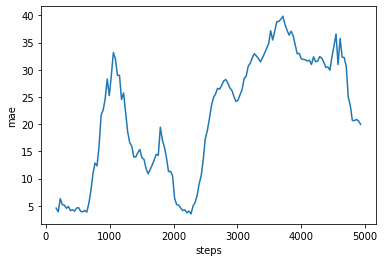

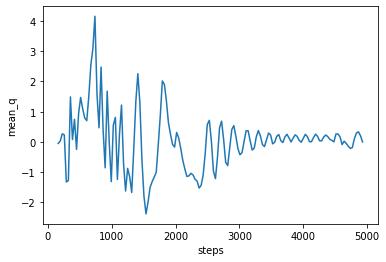

starting train 83
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 72s 72ms/step - reward: -35.6379 - cumulative_reward: -426.1479
train 83 completed. took 4090.037 seconds, total_reward: -235.50000000001947 total_profit: 0.8168986168263567
min reward: -106.80000000000022, max reward: 154.50000000000185, mean_reward: -0.047585370781980094


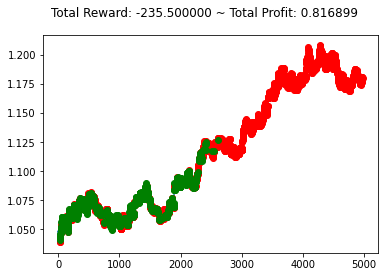

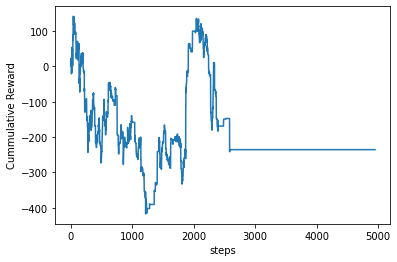

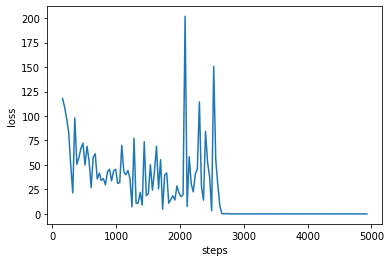

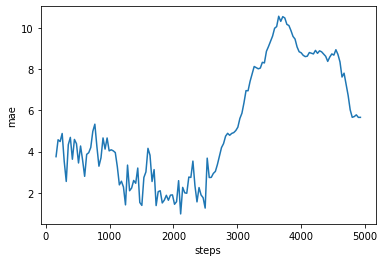

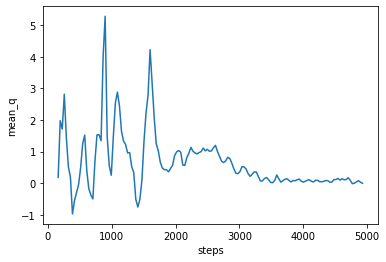

starting train 84
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 73s 74ms/step - reward: 1.6265 - cumulative_reward: 915.2775
train 84 completed. took 4181.728 seconds, total_reward: 1609.8999999999726 total_profit: 0.9307155644553229
min reward: -129.79999999999993, max reward: 1164.6999999999985, mean_reward: 0.3252980400080769


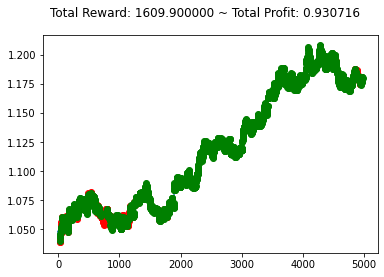

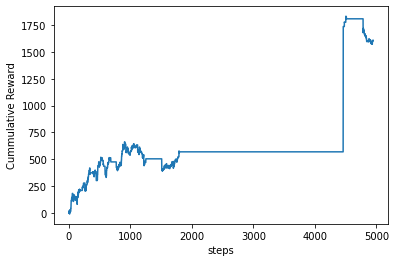

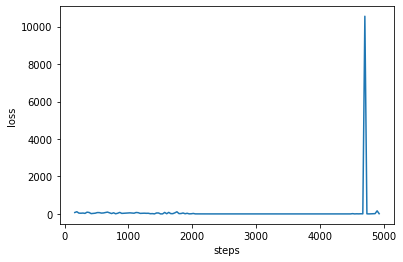

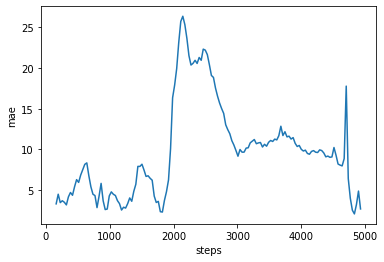

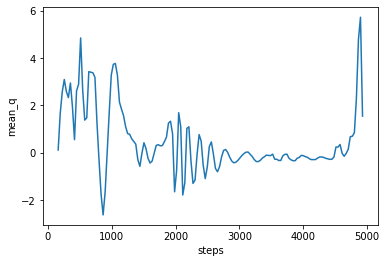

starting train 85
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 74s 75ms/step - reward: -0.5656 - cumulative_reward: -420.3578
train 85 completed. took 4275.164 seconds, total_reward: -559.7999999999615 total_profit: 0.8565616567012663
min reward: -178.30000000000234, max reward: 84.40000000000003, mean_reward: -0.11311376035561962


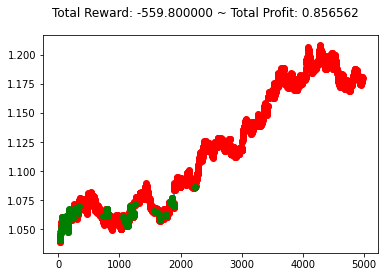

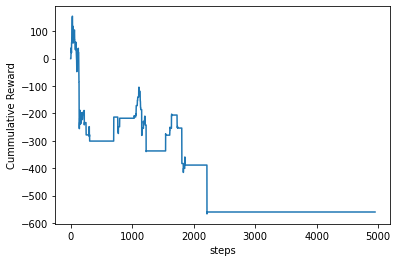

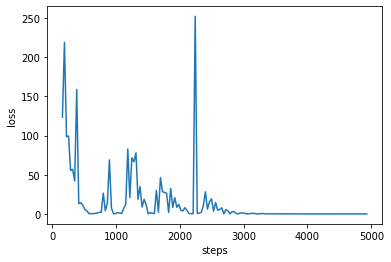

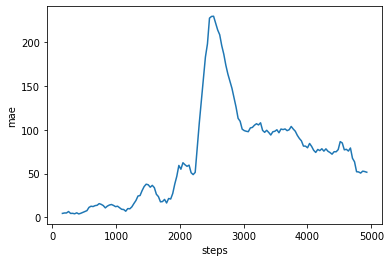

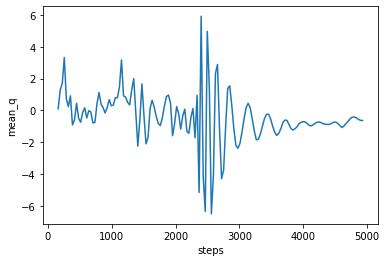

starting train 86
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 74s 75ms/step - reward: 38.2945 - cumulative_reward: -284.1070
train 86 completed. took 4368.938 seconds, total_reward: -500.30000000000257 total_profit: 0.7410204587136624
min reward: -143.90000000000347, max reward: 129.79999999999993, mean_reward: -0.1010911295211159


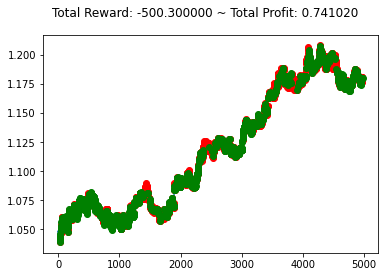

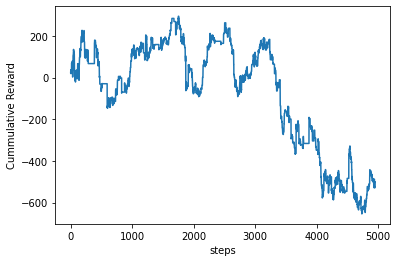

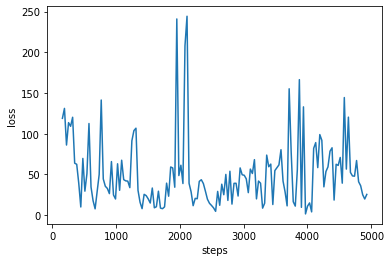

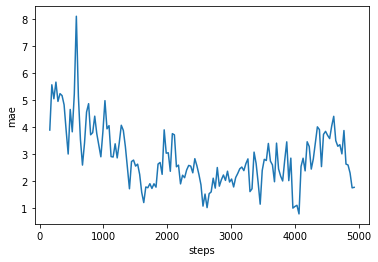

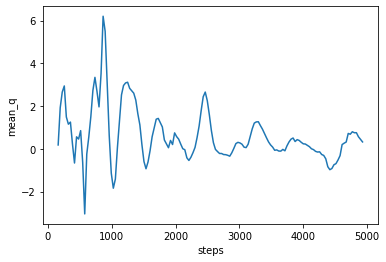

starting train 87
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 78s 79ms/step - reward: 14.1994 - cumulative_reward: 1190.7325
train 87 completed. took 4466.699 seconds, total_reward: 2077.9999999999072 total_profit: 0.8343838851530054
min reward: -109.90000000000055, max reward: 217.7999999999991, mean_reward: 0.4198828046069726


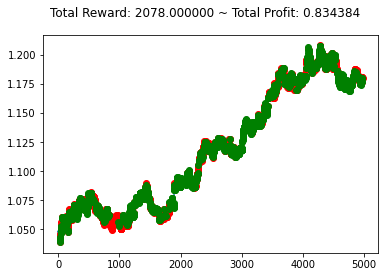

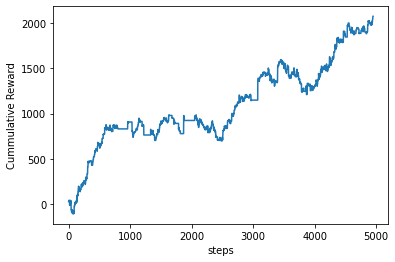

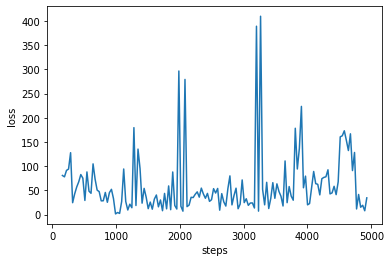

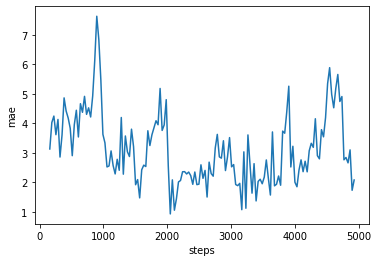

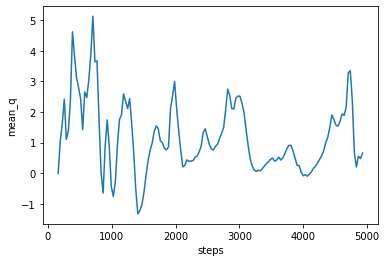

starting train 88
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 79s 80ms/step - reward: -12.4951 - cumulative_reward: 632.2007
train 88 completed. took 4565.782 seconds, total_reward: 697.6999999999845 total_profit: 0.8040079012909953
min reward: -149.49999999999795, max reward: 170.50000000000009, mean_reward: 0.14097797534855214


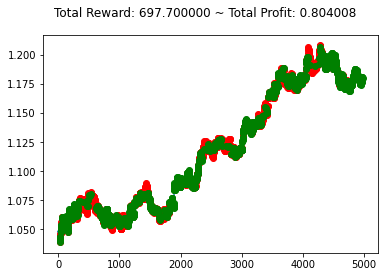

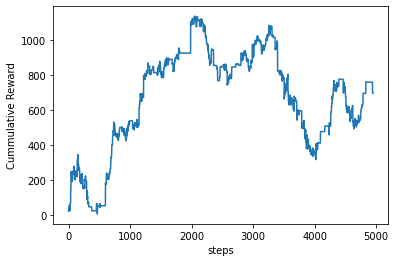

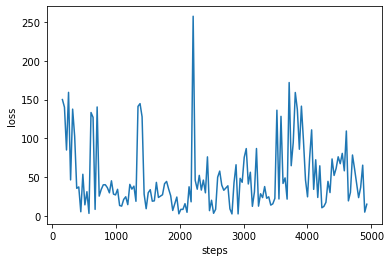

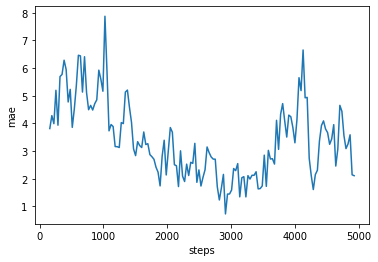

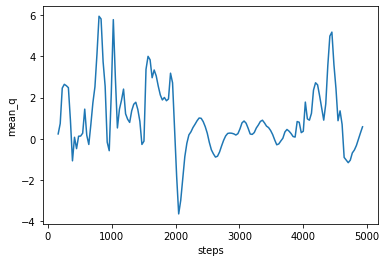

starting train 89
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 80s 81ms/step - reward: 23.1283 - cumulative_reward: 107.8367
train 89 completed. took 4666.058 seconds, total_reward: 522.9000000000487 total_profit: 0.8306617989460291
min reward: -103.69999999999769, max reward: 363.30000000000194, mean_reward: 0.1056577086280155


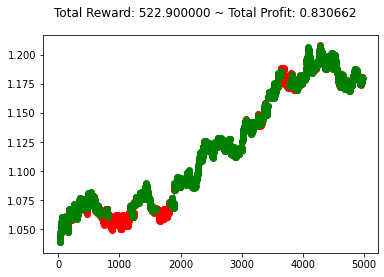

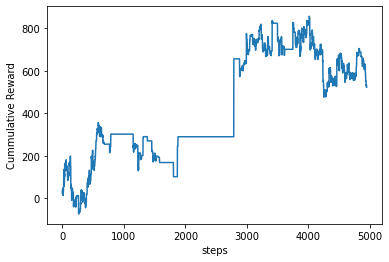

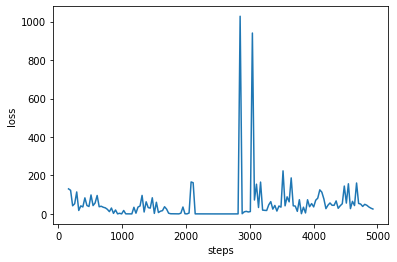

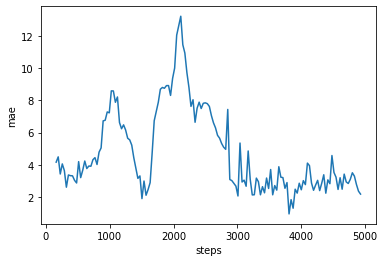

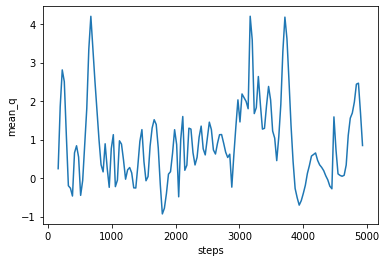

starting train 90
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 84s 84ms/step - reward: 0.8418 - cumulative_reward: 533.6349
train 90 completed. took 4770.401 seconds, total_reward: 833.1999999999695 total_profit: 0.9264090035528056
min reward: -87.00000000000152, max reward: 1144.5000000000016, mean_reward: 0.1683572438876479


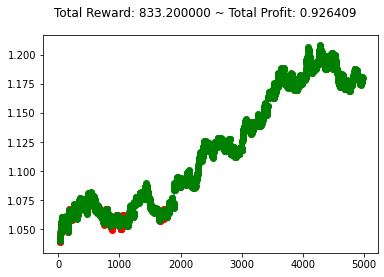

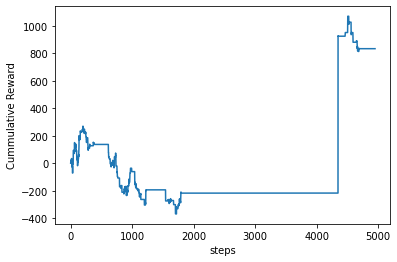

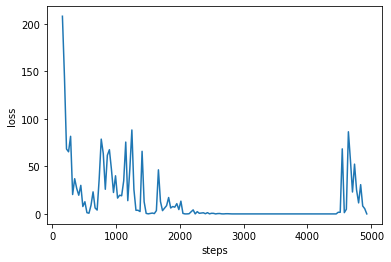

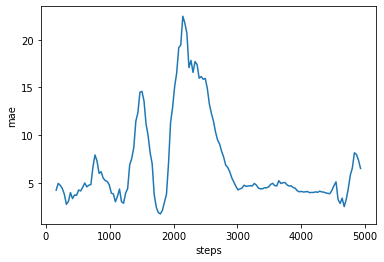

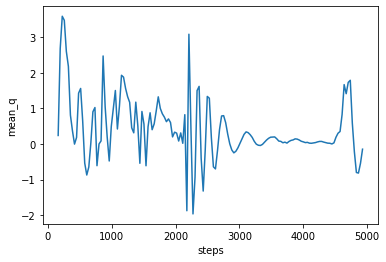

starting train 91
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 81s 82ms/step - reward: 11.0608 - cumulative_reward: 68.7962
train 91 completed. took 4873.383 seconds, total_reward: 555.1000000000157 total_profit: 0.8538468076148129
min reward: -109.90000000000055, max reward: 447.10000000000025, mean_reward: 0.11216407355021533


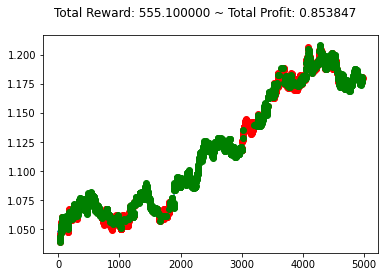

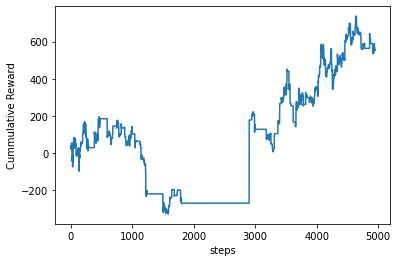

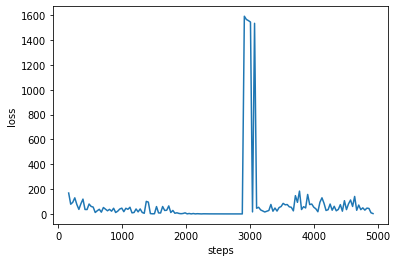

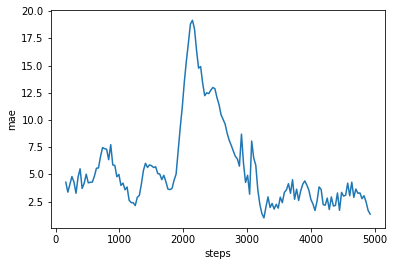

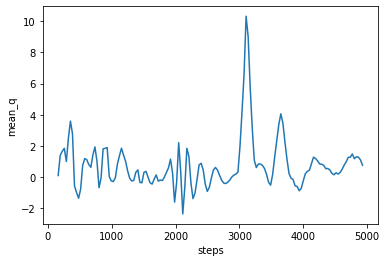

starting train 92
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 82s 83ms/step - reward: -12.3460 - cumulative_reward: 226.8128
train 92 completed. took 4976.986 seconds, total_reward: 845.3000000000136 total_profit: 0.9078809896815112
min reward: -143.49999999999864, max reward: 1225.4999999999993, mean_reward: 0.17080218225904498


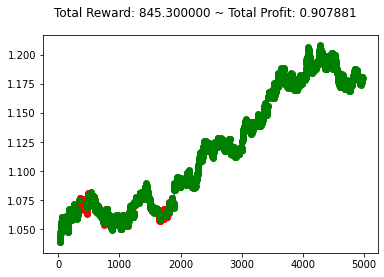

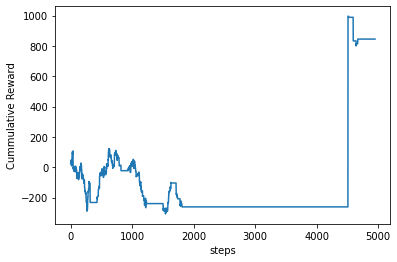

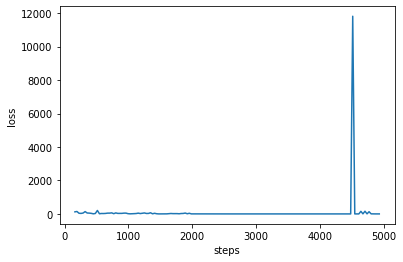

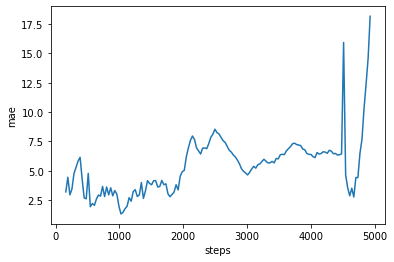

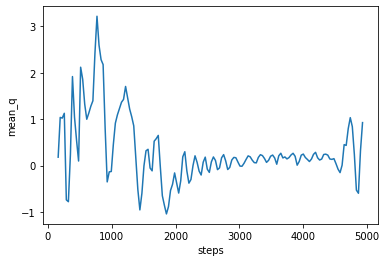

starting train 93
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 85s 86ms/step - reward: -0.3523 - cumulative_reward: -211.6928
train 93 completed. took 5083.276 seconds, total_reward: -348.6999999999839 total_profit: 0.8278888082217184
min reward: -117.19999999999953, max reward: 168.70000000000164, mean_reward: -0.07045867852091006


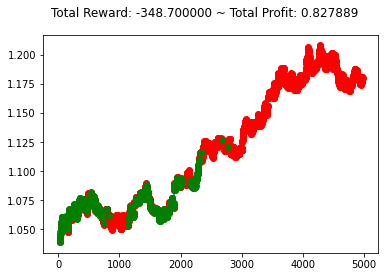

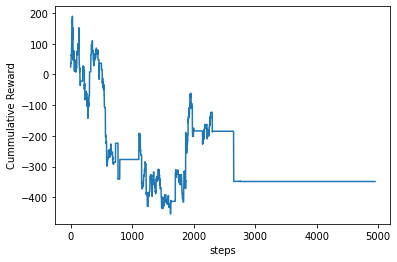

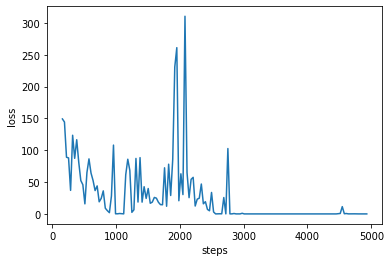

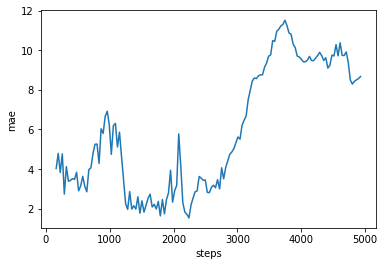

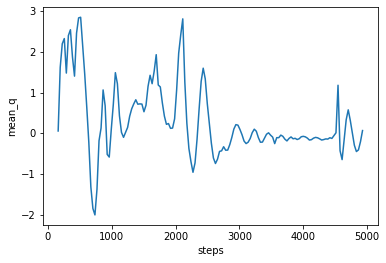

starting train 94
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 87s 88ms/step - reward: -0.1965 - cumulative_reward: -177.5648
train 94 completed. took 5192.359 seconds, total_reward: -194.49999999997115 total_profit: 0.8432752839418246
min reward: -75.00000000000063, max reward: 158.70000000000272, mean_reward: -0.03930086886239061


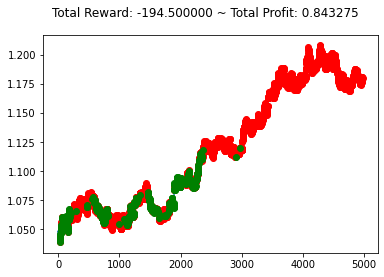

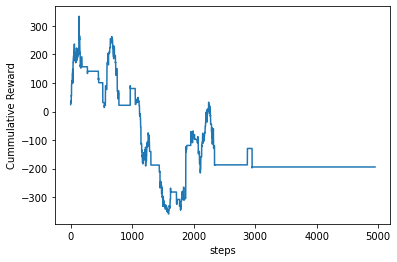

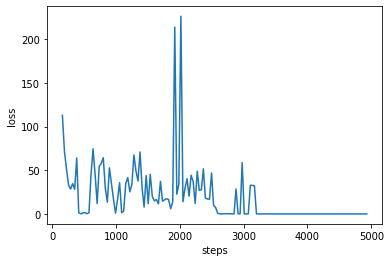

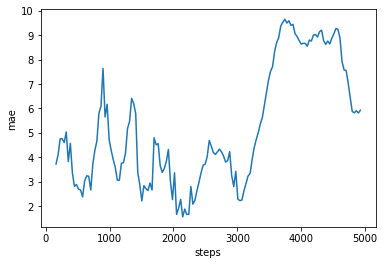

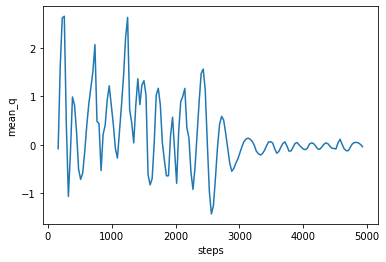

starting train 95
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 89s 90ms/step - reward: -6.4220 - cumulative_reward: 718.7777
train 95 completed. took 5303.730 seconds, total_reward: 1067.0000000000002 total_profit: 0.9107247530753881
min reward: -140.1000000000008, max reward: 1200.0000000000011, mean_reward: 0.21559911093150136


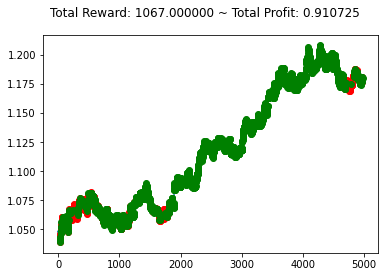

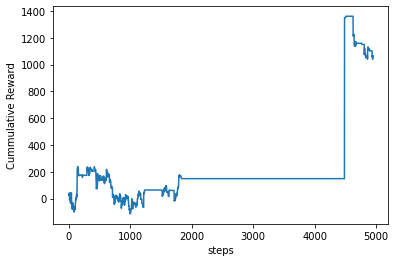

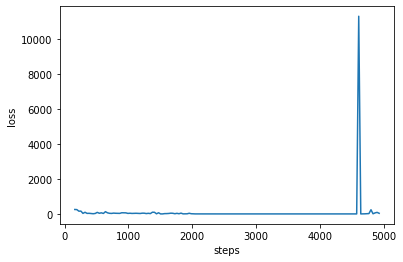

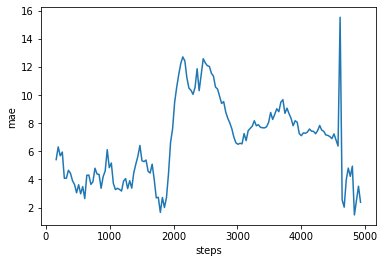

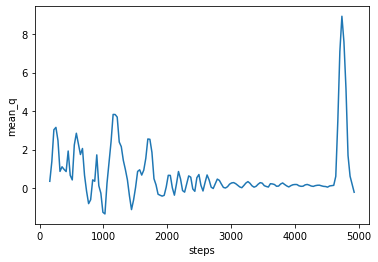

starting train 96
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 87s 88ms/step - reward: -0.5577 - cumulative_reward: -518.4174
train 96 completed. took 5413.305 seconds, total_reward: -551.9999999999613 total_profit: 0.8116077386937472
min reward: -125.20000000000087, max reward: 203.40000000000026, mean_reward: -0.11153768438067516


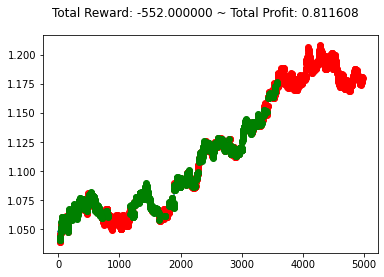

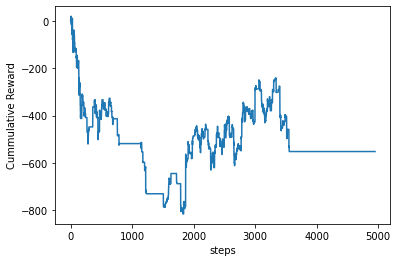

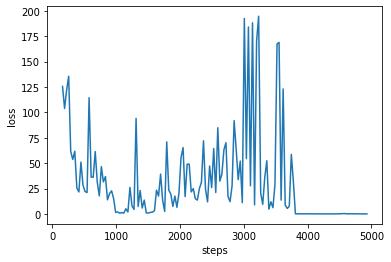

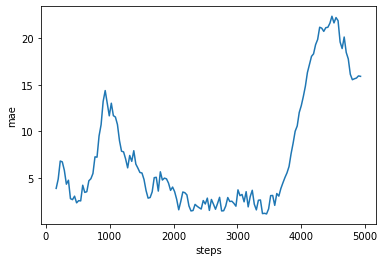

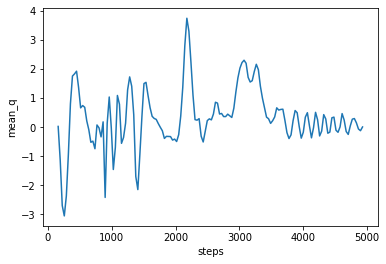

starting train 97
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 89s 89ms/step - reward: -14.5970 - cumulative_reward: -730.6703
train 97 completed. took 5524.766 seconds, total_reward: -1382.799999999972 total_profit: 0.8103935168220244
min reward: -281.0000000000001, max reward: 78.10000000000095, mean_reward: -0.27940998181450233


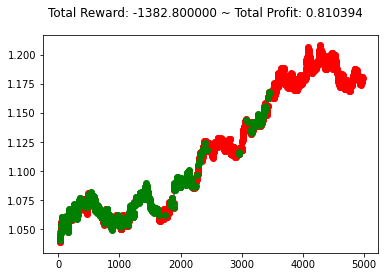

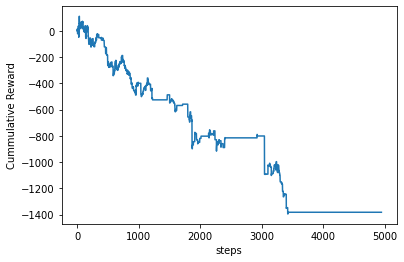

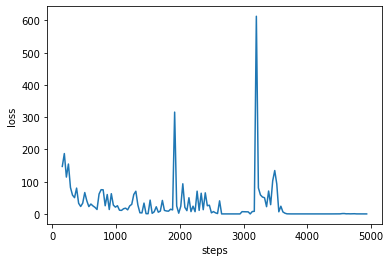

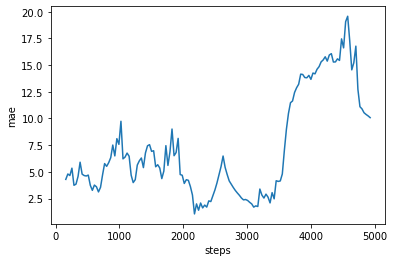

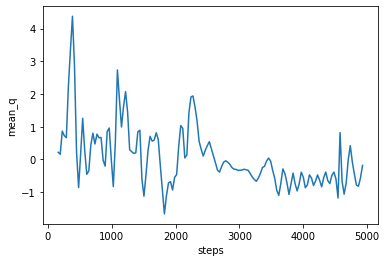

starting train 98
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 89s 90ms/step - reward: -5.2501 - cumulative_reward: 736.4726
train 98 completed. took 5636.918 seconds, total_reward: 1237.2000000000671 total_profit: 0.8706465113969483
min reward: -88.3999999999996, max reward: 380.79999999999893, mean_reward: 0.24998989694889212


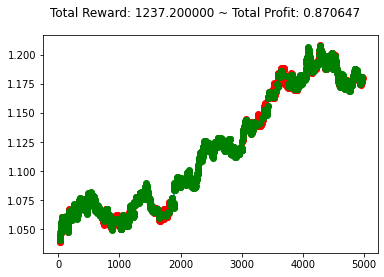

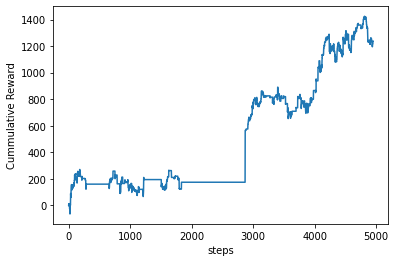

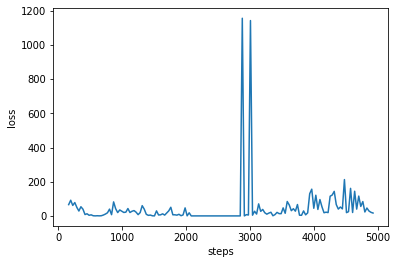

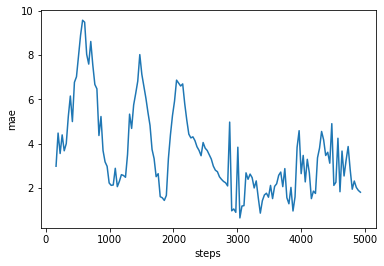

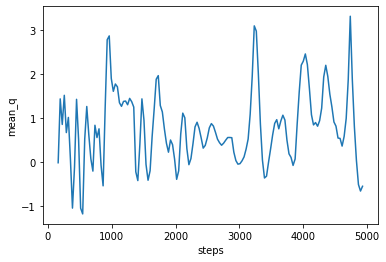

starting train 99
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 90s 91ms/step - reward: 23.5315 - cumulative_reward: 63.2537
train 99 completed. took 5750.473 seconds, total_reward: -166.79999999987405 total_profit: 0.8053920844091083
min reward: -189.20000000000047, max reward: 106.5999999999967, mean_reward: -0.033703778541093965


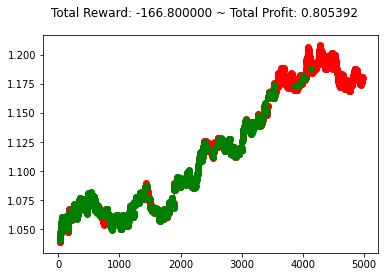

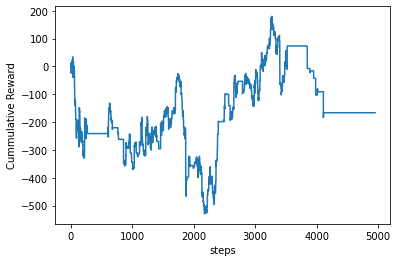

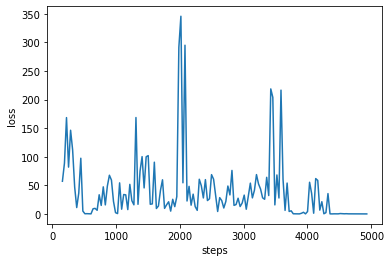

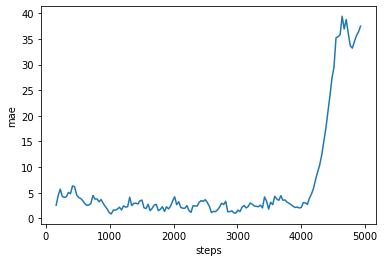

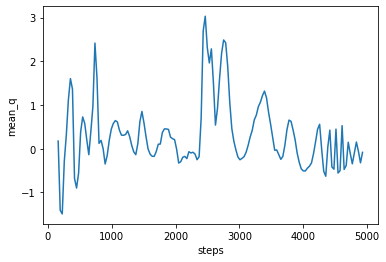

starting train 100
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 91s 92ms/step - reward: 14.3852 - cumulative_reward: 629.0548
train 100 completed. took 5865.384 seconds, total_reward: 1173.1000000000008 total_profit: 0.8795639906436192
min reward: -127.80000000000014, max reward: 419.6999999999984, mean_reward: 0.23703778541119436


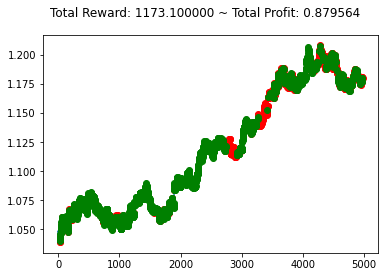

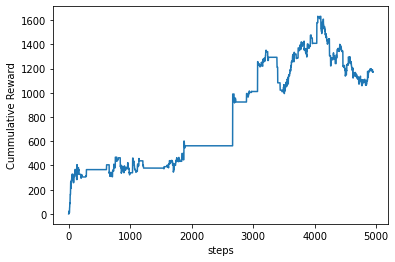

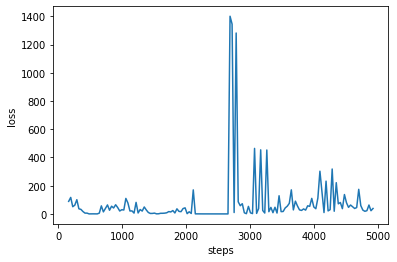

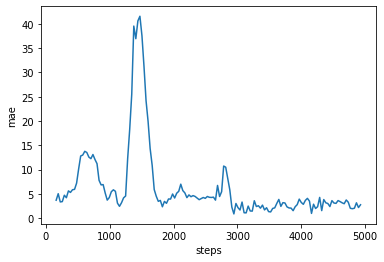

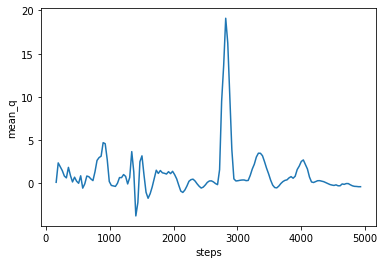

In [3]:
from evaluator import Evaluator

e = Evaluator(agent_creator, env_creator, name="dqn")
e.train(repeat=100)


average of total_reward across trainings: [58.338]


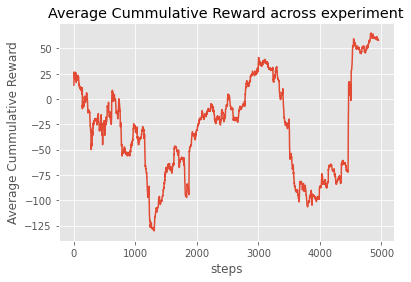

In [4]:
e.process_train_result()

Testing for 1 episodes ...
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
197/199 [============================>.] - ETA: 0s - reward: 1.6254 - cumulative_reward: 16.0091Episode 1: reward: 120.600, steps: 999
test completed. total_reward: 120.5999999999708 total_profit: 0.9823366296715013
min reward: -105.80000000000034, max reward: 79.2000000000015, mean_reward: 0.1207207207206915


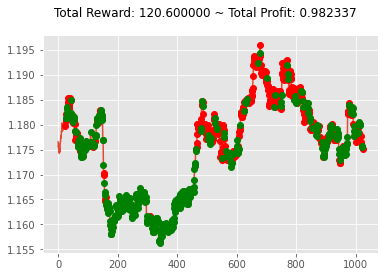

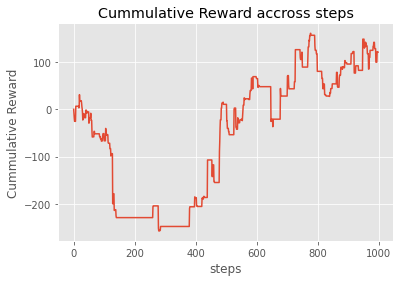

In [5]:
e.test(ForexV0FullFeature(df=FOREX_EURUSD_1H_ASK, frame_bound=(5000, 6000), window_size=24))

### Double DQN

In [6]:

def agent_creator():
    #processor = EnvProcessor()
    processor = WhiteningNormalizerProcessor()
    memory = SequentialMemory(limit=256, window_length=1)
    #policy = EpsGreedyQPolicy()
    policy = BoltzmannQPolicy()
    agent = DQNAgent(model=buildModel(), nb_actions=nb_actions, memory=memory, nb_steps_warmup=128, policy=policy, batch_size=64, processor=processor, 
                   target_model_update=1e-2, train_interval=32, gamma=0.5, enable_double_dqn=True)
    agent.compile(Adam(lr=0.001), metrics=['mae'])
    return agent

starting train 1
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 94s 95ms/step - reward: -0.4309 - cumulative_reward: -289.8617
train 1 completed. took 111.063 seconds, total_reward: -426.5000000000472 total_profit: 0.9102307539378444
min reward: -92.0999999999994, max reward: 63.69999999999987, mean_reward: -0.08617902606588143


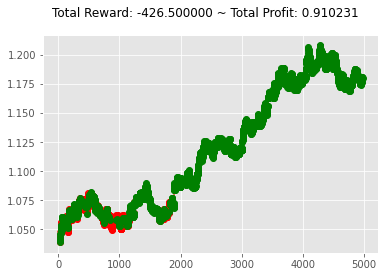

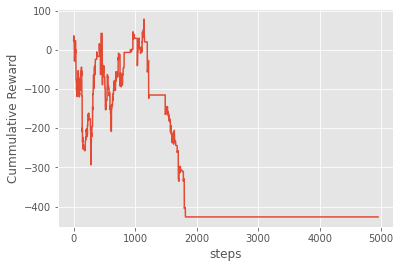

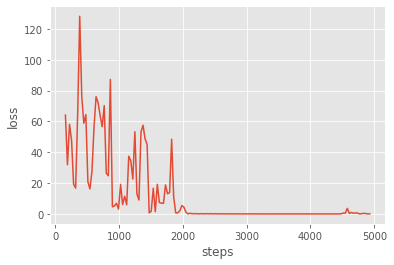

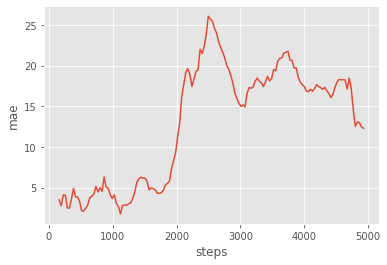

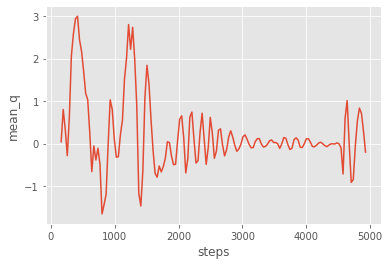

starting train 2
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 94s 95ms/step - reward: 23.4272 - cumulative_reward: -127.7432
train 2 completed. took 229.426 seconds, total_reward: -270.0000000000413 total_profit: 0.797792870900233
min reward: -122.99999999999977, max reward: 231.10000000000187, mean_reward: -0.054556476055777195


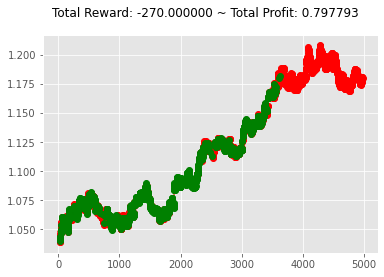

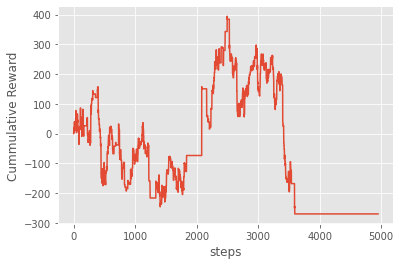

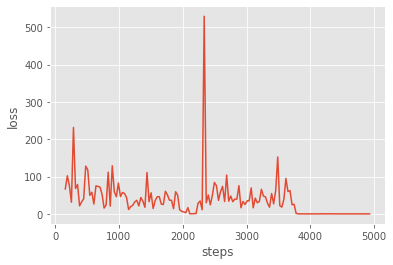

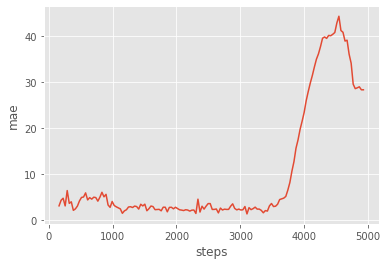

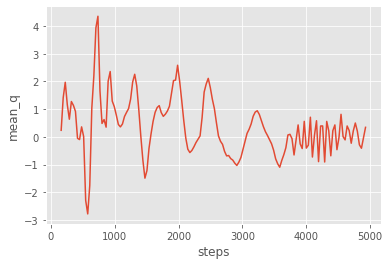

starting train 3
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 95s 96ms/step - reward: 7.4576 - cumulative_reward: 186.9613
train 3 completed. took 349.306 seconds, total_reward: 650.8999999999571 total_profit: 0.89890809747297
min reward: -183.69999999999774, max reward: 1161.2999999999984, mean_reward: 0.13152151949888


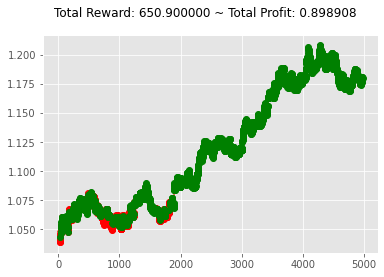

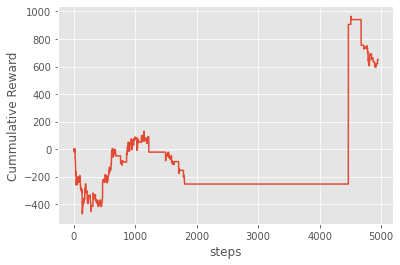

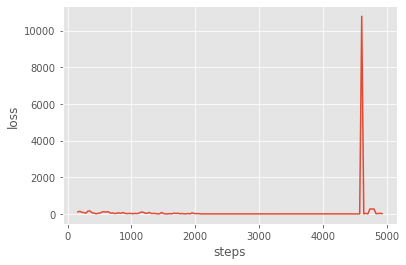

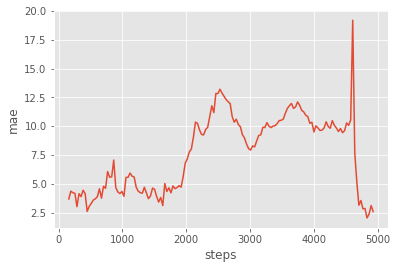

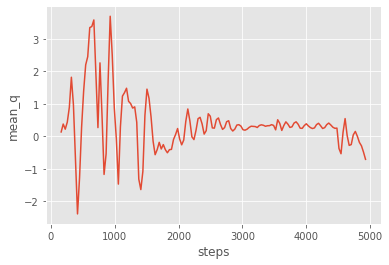

starting train 4
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 96s 97ms/step - reward: -6.0919 - cumulative_reward: -974.7479
train 4 completed. took 470.776 seconds, total_reward: -1278.700000000037 total_profit: 0.7651086620016195
min reward: -111.69999999999902, max reward: 241.0000000000001, mean_reward: -0.25837542937968017


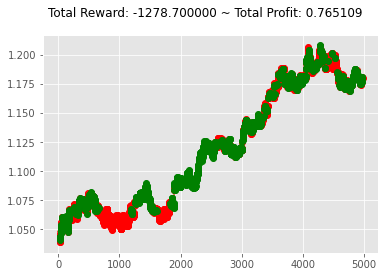

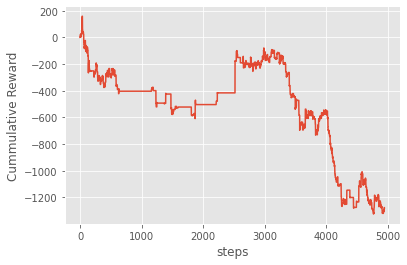

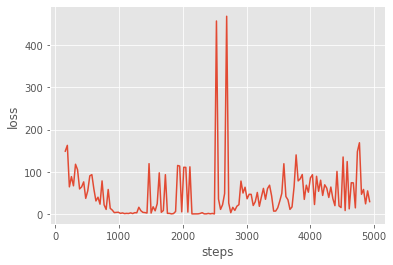

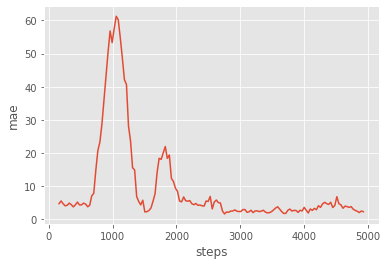

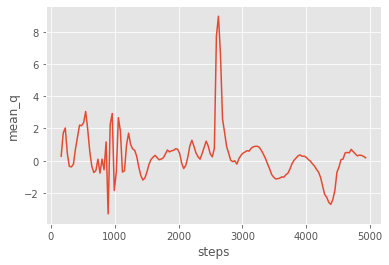

starting train 5
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 103s 104ms/step - reward: 0.1323 - cumulative_reward: -106.4340
train 5 completed. took 599.369 seconds, total_reward: 130.99999999999 total_profit: 0.8643097304727787
min reward: -176.49999999999943, max reward: 468.50000000000057, mean_reward: 0.026469993938167305


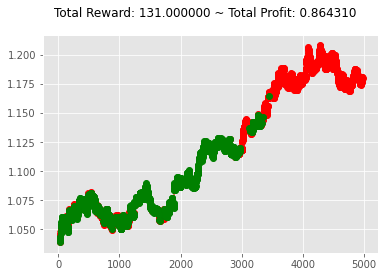

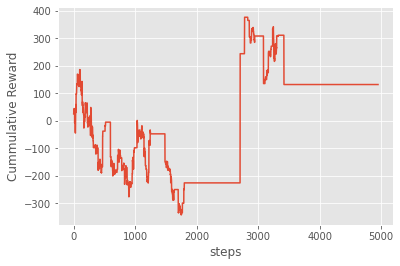

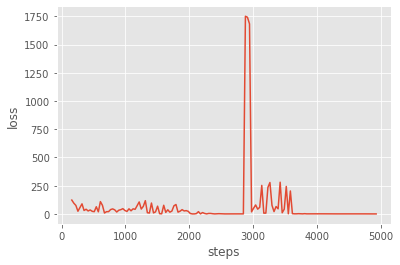

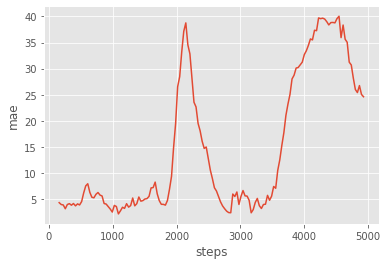

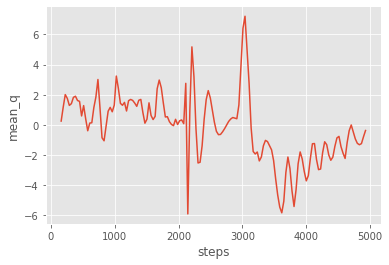

starting train 6
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 99s 100ms/step - reward: 0.1107 - cumulative_reward: -164.5856
train 6 completed. took 724.098 seconds, total_reward: 109.6000000000159 total_profit: 0.8633852982185157
min reward: -201.79999999999865, max reward: 489.2000000000007, mean_reward: 0.022145888058196787


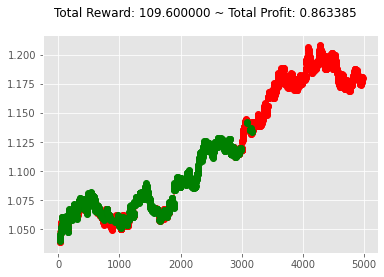

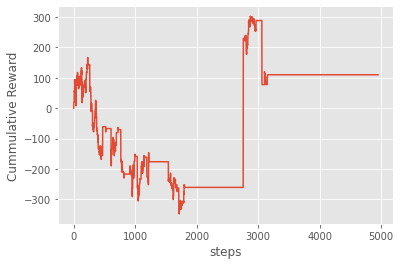

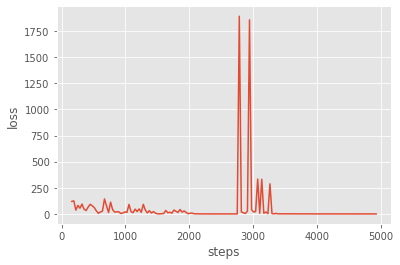

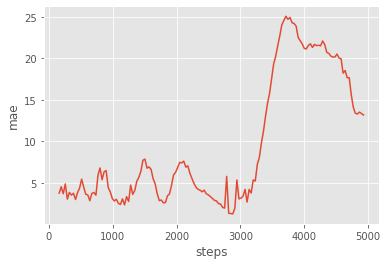

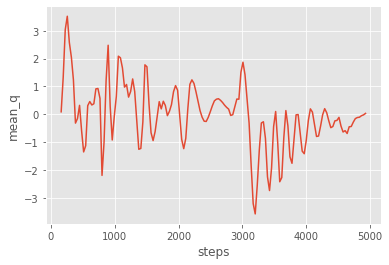

starting train 7
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 102s 103ms/step - reward: -0.0492 - cumulative_reward: -39.6733
train 7 completed. took 852.277 seconds, total_reward: -48.69999999999471 total_profit: 0.9170347505527483
min reward: -94.60000000000024, max reward: 78.00000000000028, mean_reward: -0.0098403717922802


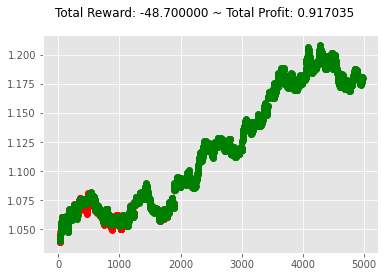

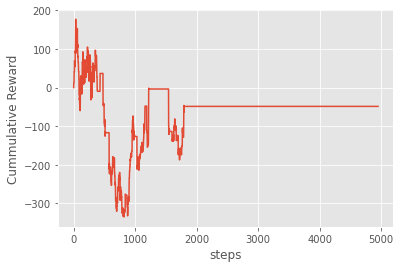

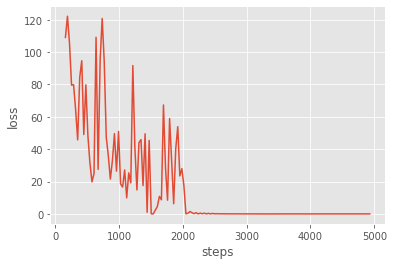

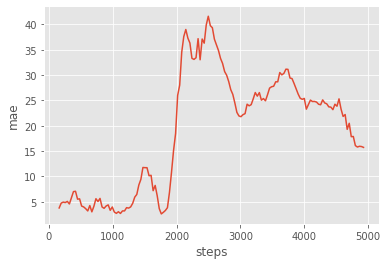

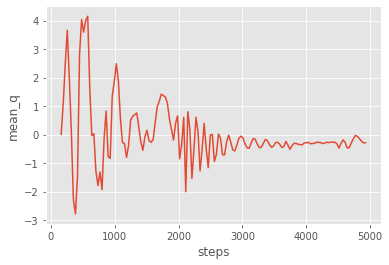

starting train 8
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 103s 104ms/step - reward: 22.1671 - cumulative_reward: -288.3292
train 8 completed. took 981.332 seconds, total_reward: -32.59999999997819 total_profit: 0.8504660811879213
min reward: -149.7000000000015, max reward: 186.69999999999965, mean_reward: -0.006587189331173609


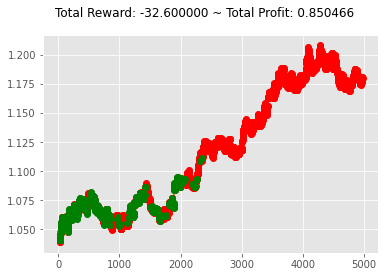

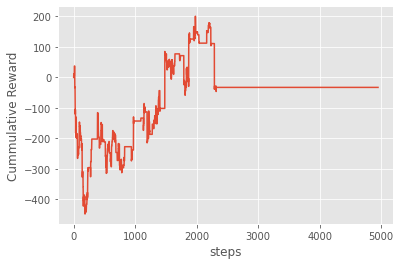

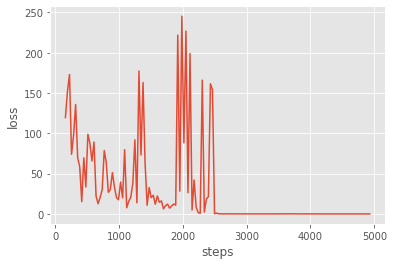

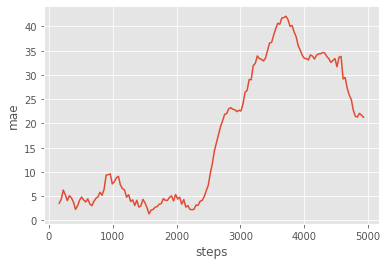

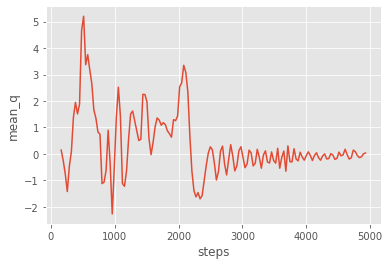

starting train 9
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 103s 104ms/step - reward: 21.5363 - cumulative_reward: -613.3937
train 9 completed. took 1110.925 seconds, total_reward: -656.9000000001577 total_profit: 0.7335581197540518
min reward: -181.00000000000006, max reward: 128.39999999999964, mean_reward: -0.13273388563349317


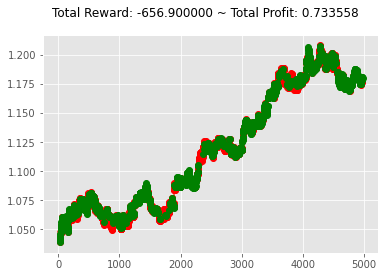

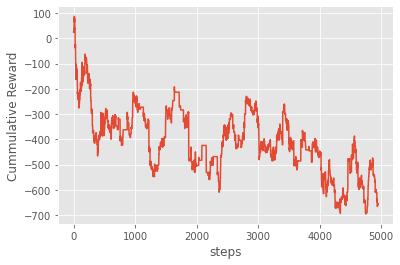

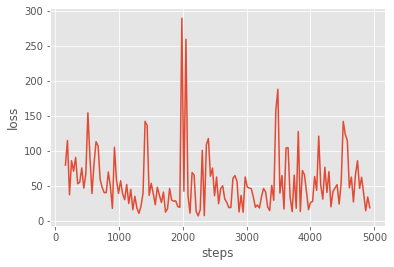

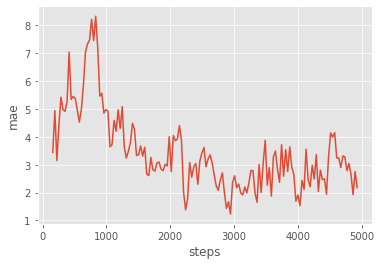

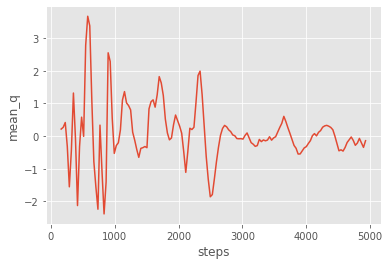

starting train 10
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 103s 104ms/step - reward: -0.1761 - cumulative_reward: 37.6075
train 10 completed. took 1240.957 seconds, total_reward: -174.29999999992506 total_profit: 0.8293187677243176
min reward: -270.79999999999995, max reward: 178.4999999999992, mean_reward: -0.035219236209320076


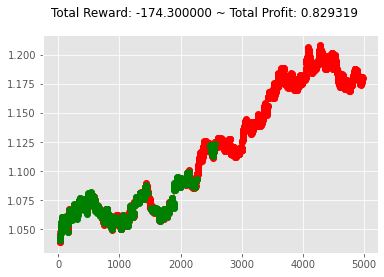

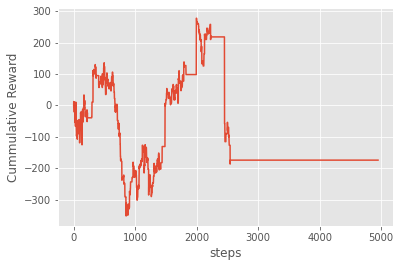

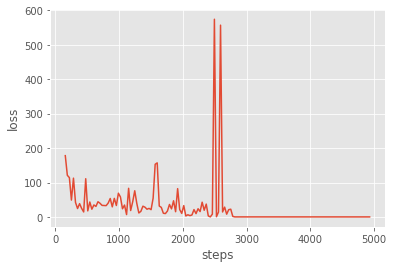

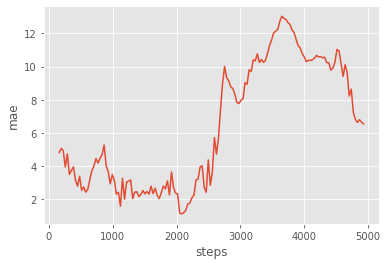

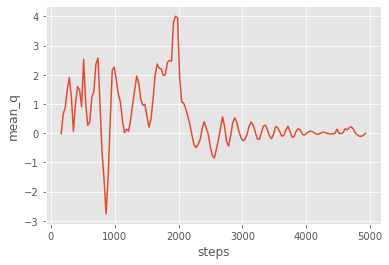

starting train 11
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 105s 106ms/step - reward: -15.3798 - cumulative_reward: 118.0045
train 11 completed. took 1372.854 seconds, total_reward: -375.90000000007115 total_profit: 0.7381294602103127
min reward: -121.79999999999858, max reward: 170.2999999999988, mean_reward: -0.07595473833099033


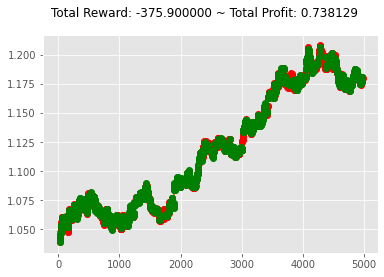

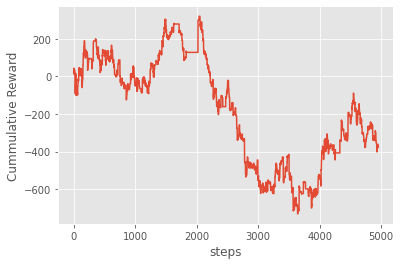

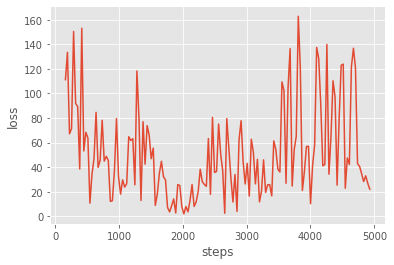

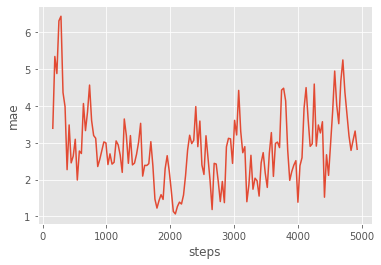

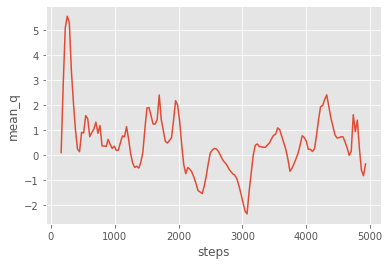

starting train 12
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 106s 108ms/step - reward: 7.9402 - cumulative_reward: -250.1951
train 12 completed. took 1506.689 seconds, total_reward: -653.1000000000154 total_profit: 0.7916829883041924
min reward: -168.70000000000164, max reward: 90.20000000000027, mean_reward: -0.13196605374823508


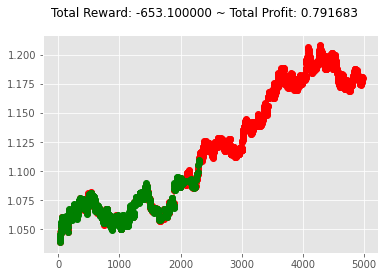

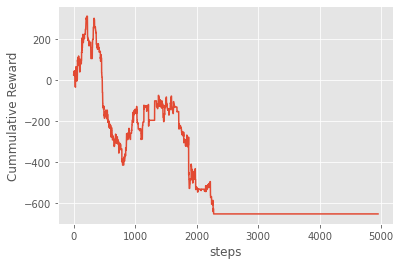

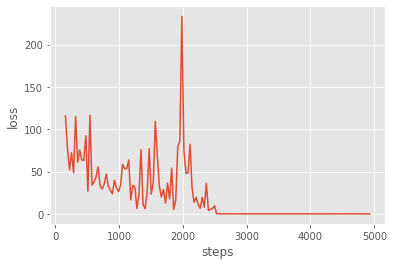

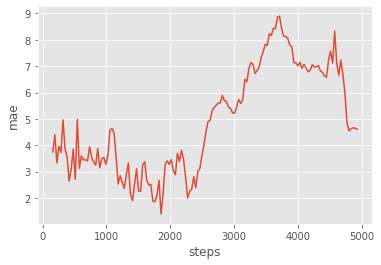

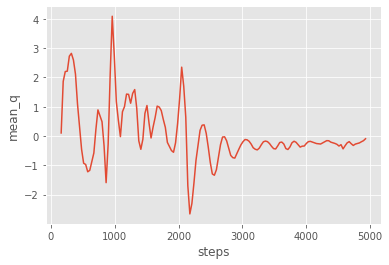

starting train 13
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 107s 108ms/step - reward: -0.8230 - cumulative_reward: -550.6868
train 13 completed. took 1642.355 seconds, total_reward: -814.5999999999938 total_profit: 0.7609061796533279
min reward: -159.40000000000066, max reward: 143.49999999999864, mean_reward: -0.16459890887047762


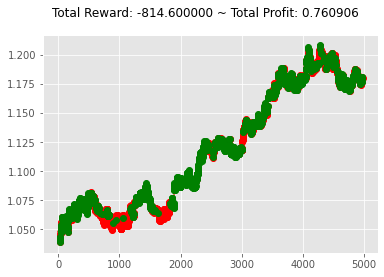

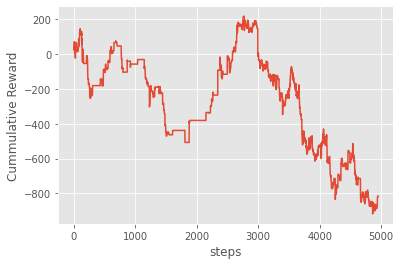

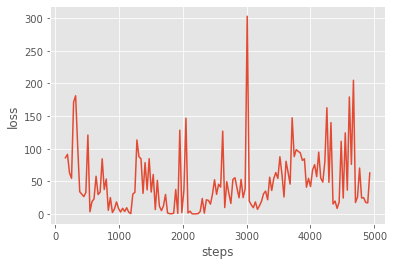

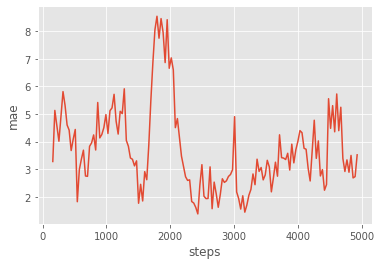

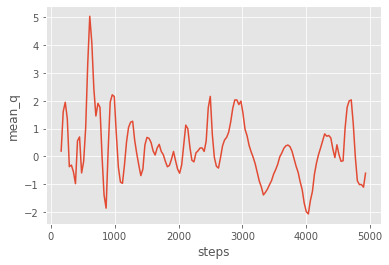

starting train 14
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 110s 111ms/step - reward: -0.5322 - cumulative_reward: -497.9429
train 14 completed. took 1780.632 seconds, total_reward: -526.8000000000402 total_profit: 0.8109699063572978
min reward: -128.39999999999964, max reward: 162.80000000000072, mean_reward: -0.106445746615486


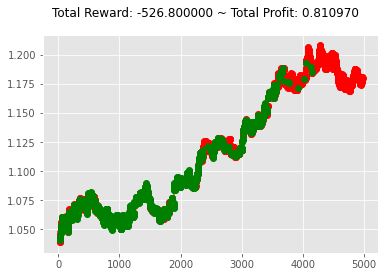

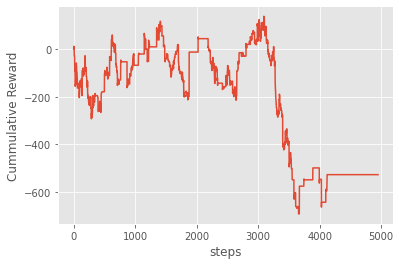

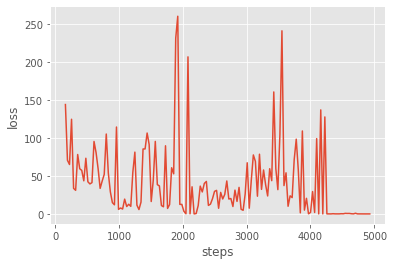

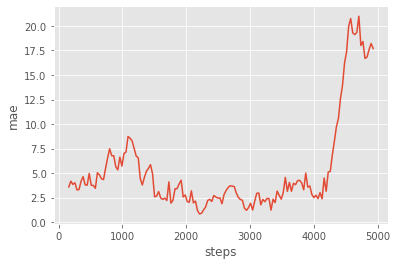

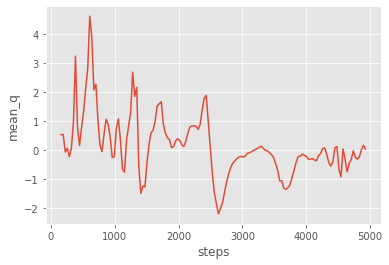

starting train 15
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 109s 110ms/step - reward: 0.1269 - cumulative_reward: -29.2980
train 15 completed. took 1918.346 seconds, total_reward: 125.60000000003464 total_profit: 0.8721137167892452
min reward: -164.69999999999985, max reward: 489.4999999999983, mean_reward: 0.02537886441706095


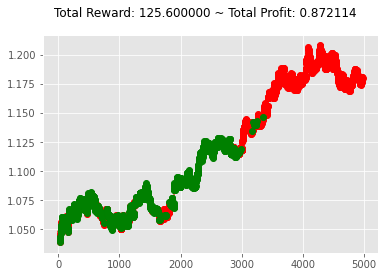

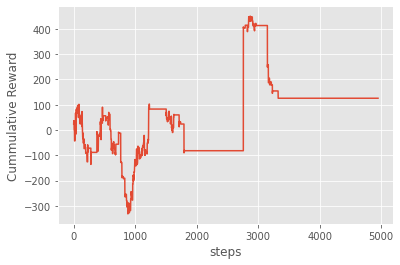

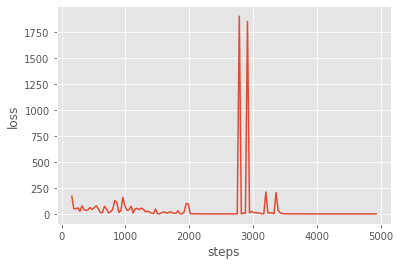

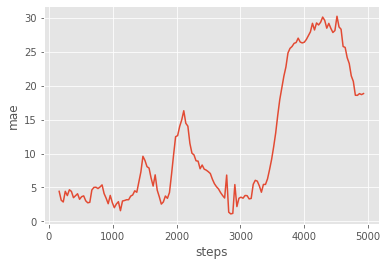

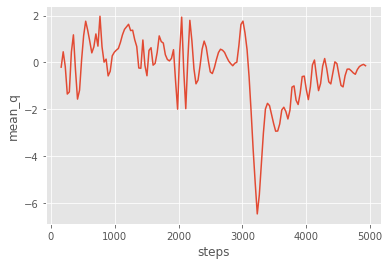

starting train 16
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 112s 113ms/step - reward: 0.9854 - cumulative_reward: 675.5543
train 16 completed. took 2058.980 seconds, total_reward: 975.3000000000417 total_profit: 0.801513100241938
min reward: -178.6000000000021, max reward: 161.5999999999995, mean_reward: 0.1970701151747912


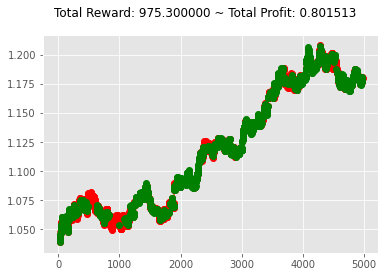

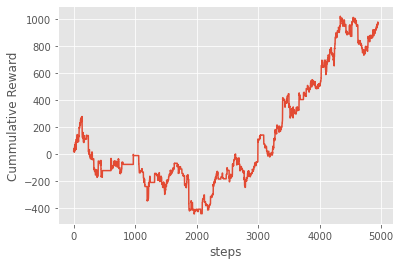

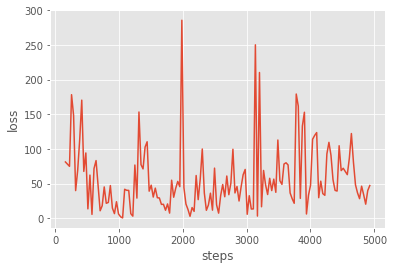

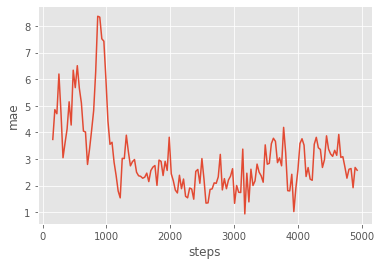

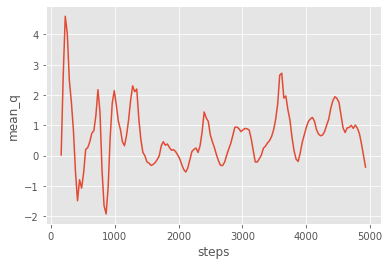

starting train 17
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 113s 114ms/step - reward: -34.9515 - cumulative_reward: 277.6336
train 17 completed. took 2201.169 seconds, total_reward: 146.9999999999597 total_profit: 0.7882622370096851
min reward: -169.9000000000006, max reward: 122.6000000000016, mean_reward: 0.02970297029702156


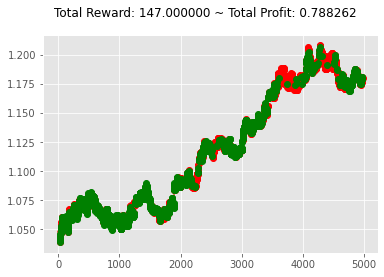

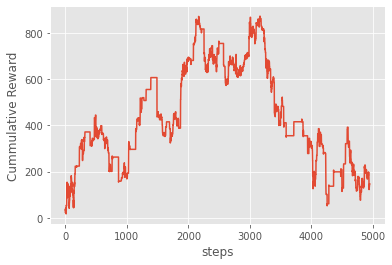

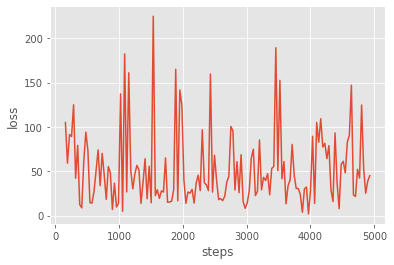

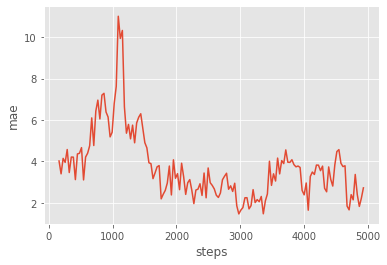

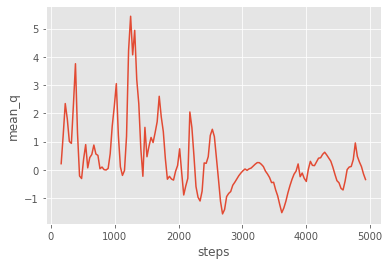

starting train 18
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 113s 114ms/step - reward: -6.4254 - cumulative_reward: -18.9771
train 18 completed. took 2342.976 seconds, total_reward: 73.80000000002408 total_profit: 0.814928797061821
min reward: -99.79999999999878, max reward: 168.70000000000164, mean_reward: 0.01491210345524835


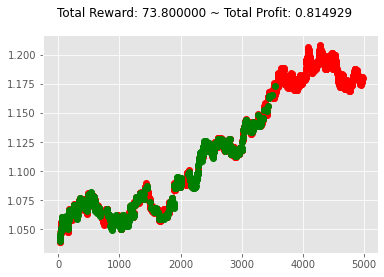

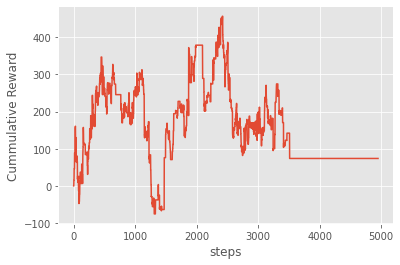

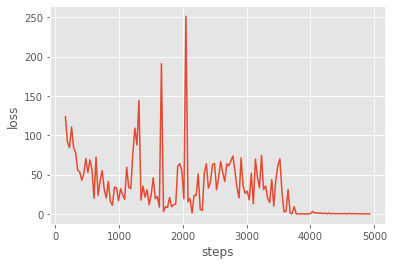

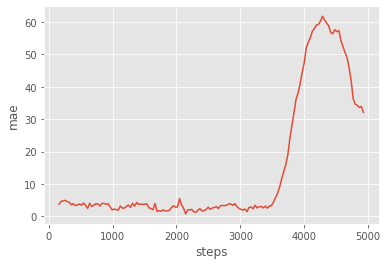

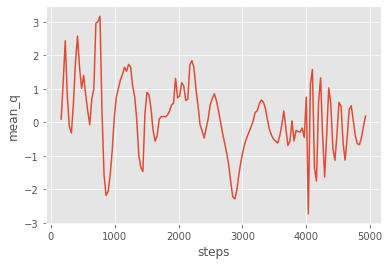

starting train 19
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 114s 115ms/step - reward: 8.5514 - cumulative_reward: -115.3677
train 19 completed. took 2487.257 seconds, total_reward: -48.09999999996866 total_profit: 0.8306242682458456
min reward: -123.50000000000082, max reward: 53.300000000000566, mean_reward: -0.009719135178817673


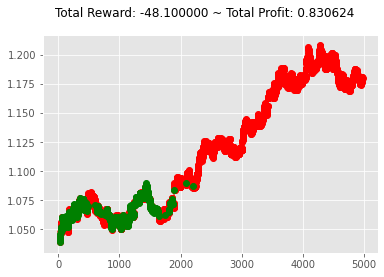

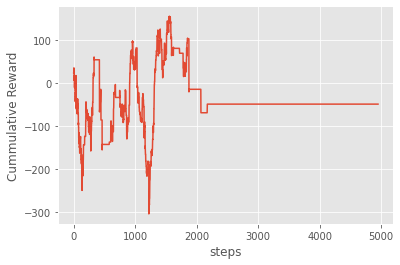

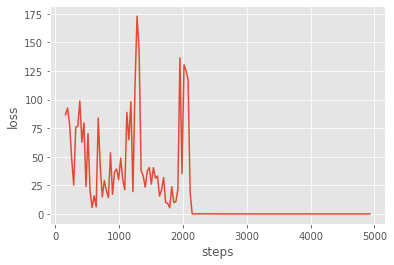

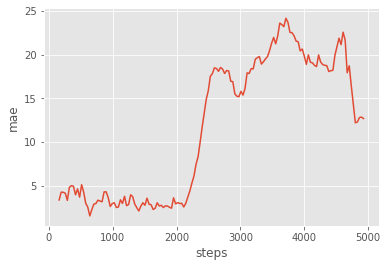

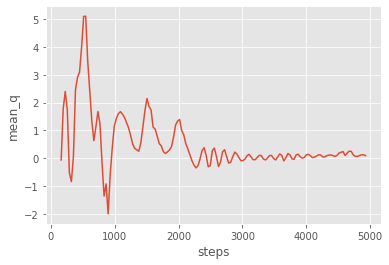

starting train 20
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 115s 116ms/step - reward: -0.9349 - cumulative_reward: -560.2168
train 20 completed. took 2632.872 seconds, total_reward: -925.3999999999853 total_profit: 0.8280626169605569
min reward: -470.30000000000126, max reward: 143.80000000000058, mean_reward: -0.18698727015558403


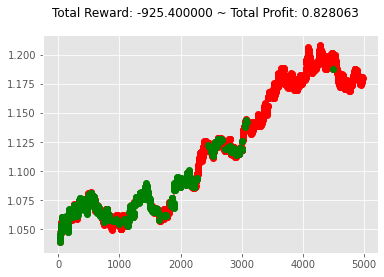

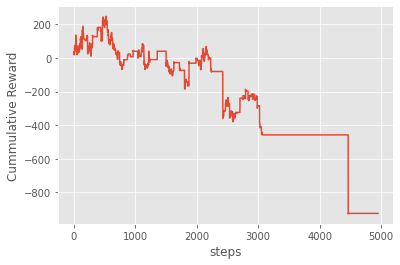

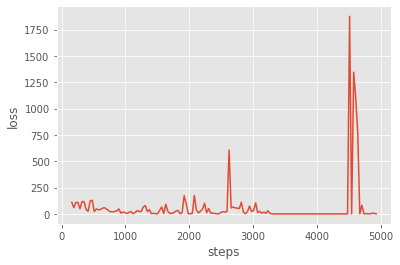

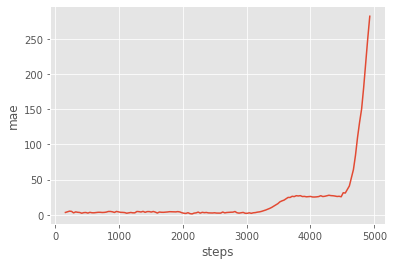

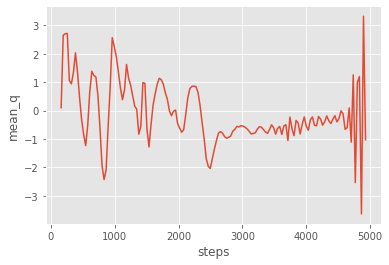

starting train 21
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 117s 118ms/step - reward: -0.2165 - cumulative_reward: -497.8319
train 21 completed. took 2779.921 seconds, total_reward: -214.29999999997835 total_profit: 0.8313429282171955
min reward: -116.19999999999963, max reward: 199.30000000000004, mean_reward: -0.043301677106481785


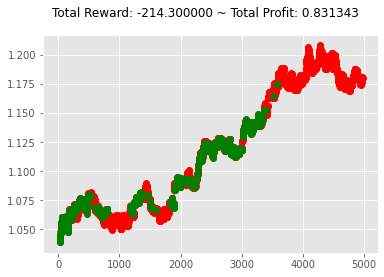

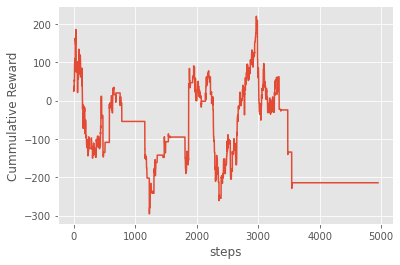

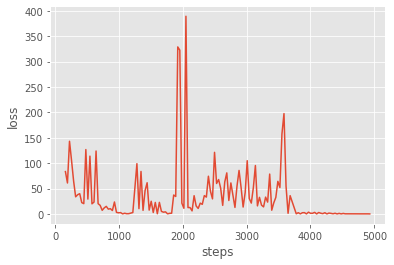

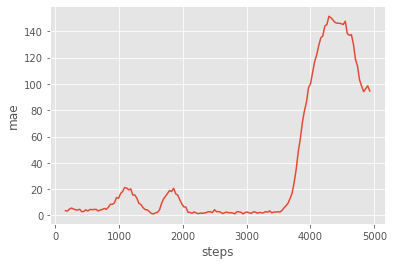

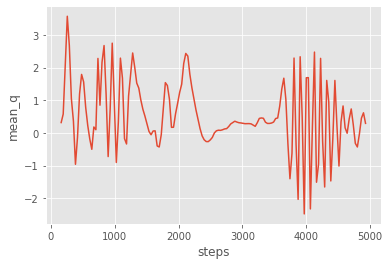

starting train 22
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 121s 123ms/step - reward: -13.4319 - cumulative_reward: -175.8467
train 22 completed. took 2934.317 seconds, total_reward: -229.49999999998477 total_profit: 0.8301977444065208
min reward: -104.50000000000071, max reward: 118.50000000000138, mean_reward: -0.046373004647400434


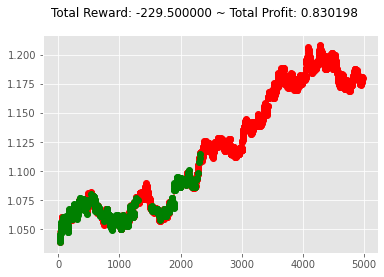

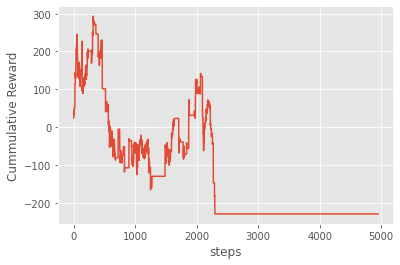

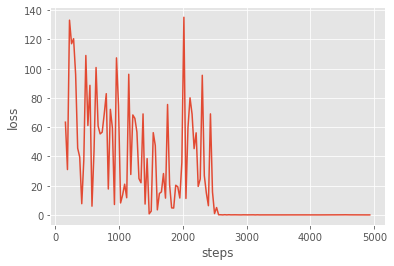

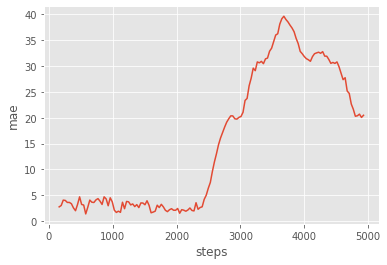

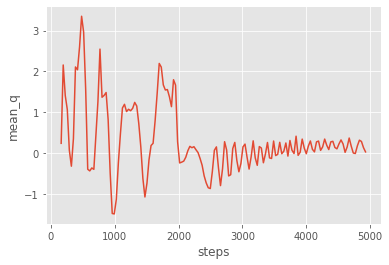

starting train 23
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 126s 127ms/step - reward: -0.2555 - cumulative_reward: -108.3942
train 23 completed. took 3091.371 seconds, total_reward: -252.89999999994663 total_profit: 0.8401420395809991
min reward: -654.4999999999978, max reward: 150.00000000000125, mean_reward: -0.051101232572226034


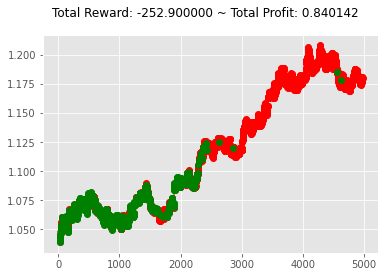

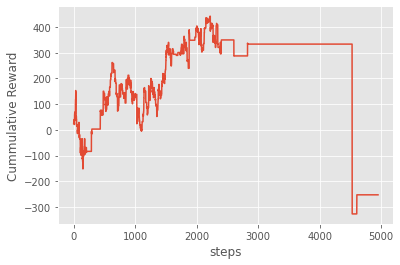

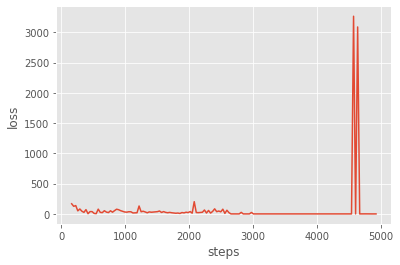

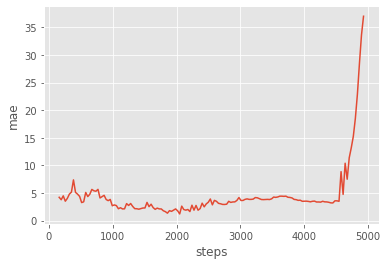

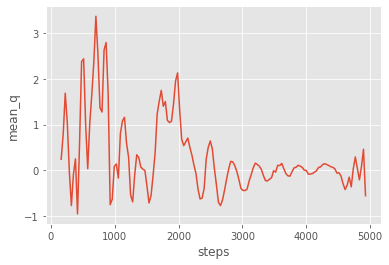

starting train 24
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 121s 122ms/step - reward: -0.1895 - cumulative_reward: 251.9785
train 24 completed. took 3243.178 seconds, total_reward: -187.60000000004155 total_profit: 0.814509027573465
min reward: -128.09999999999988, max reward: 204.40000000000015, mean_reward: -0.0379066478076463


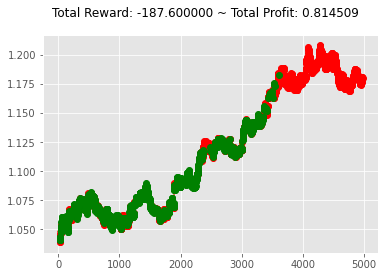

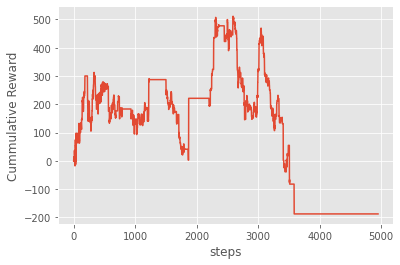

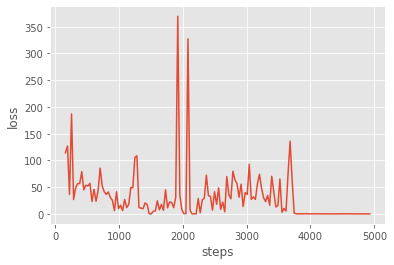

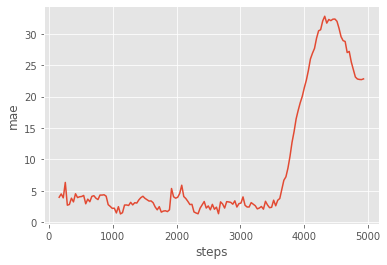

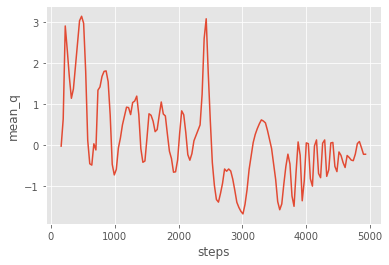

starting train 25
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 122s 123ms/step - reward: 1.5837 - cumulative_reward: 718.9319
train 25 completed. took 3396.905 seconds, total_reward: 1567.500000000004 total_profit: 0.9252694346586419
min reward: -145.60000000000127, max reward: 1238.9000000000005, mean_reward: 0.31673065265710326


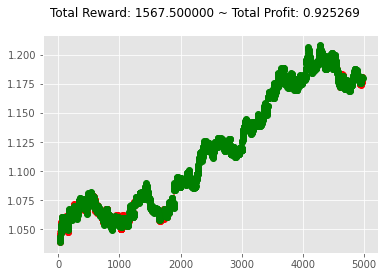

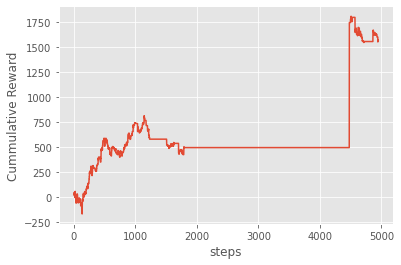

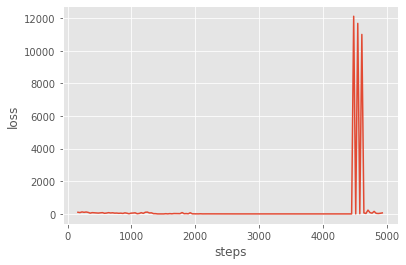

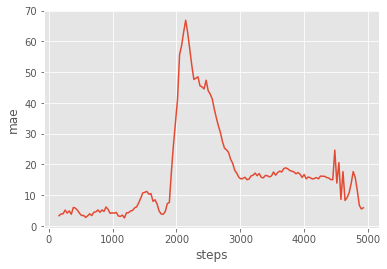

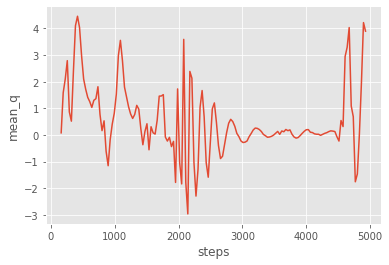

starting train 26
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 123s 124ms/step - reward: 11.1212 - cumulative_reward: 595.5944
train 26 completed. took 3551.961 seconds, total_reward: 614.8999999999473 total_profit: 0.7593772356850689
min reward: -106.7000000000018, max reward: 172.69999999999897, mean_reward: 0.12424732269144217


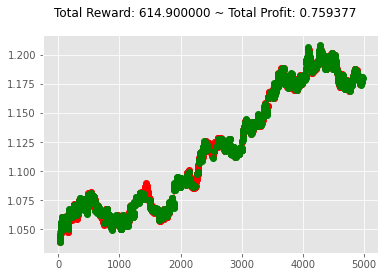

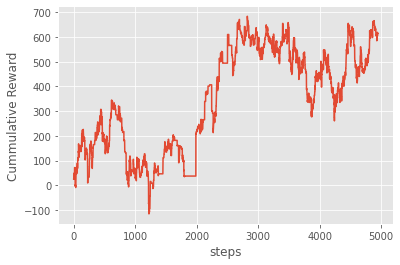

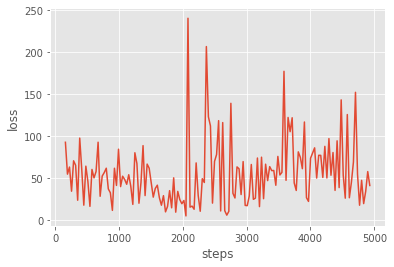

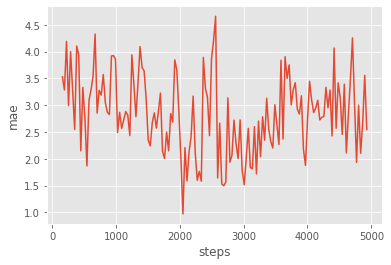

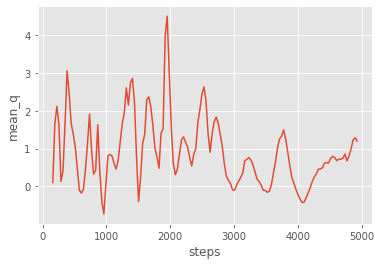

starting train 27
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 131s 132ms/step - reward: 17.6847 - cumulative_reward: -725.9465
train 27 completed. took 3714.272 seconds, total_reward: -1400.9000000001013 total_profit: 0.7689926805438475
min reward: -168.70000000000164, max reward: 94.69999999999868, mean_reward: -0.2830672863204892


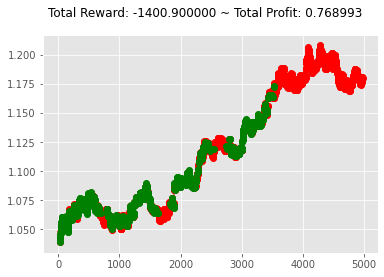

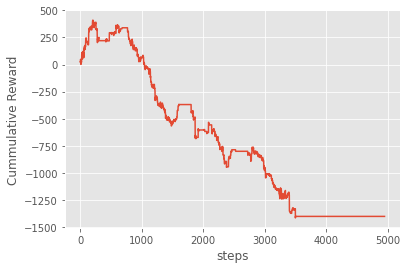

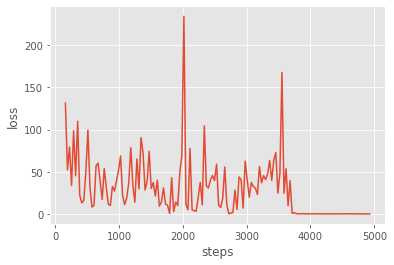

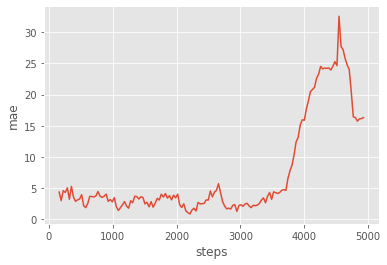

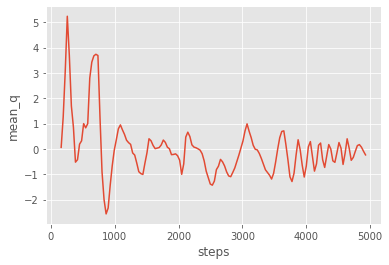

starting train 28
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 133s 134ms/step - reward: 0.4423 - cumulative_reward: 248.3023
train 28 completed. took 3882.604 seconds, total_reward: 437.79999999998176 total_profit: 0.8847831404712589
min reward: -83.99999999999963, max reward: 458.30000000000035, mean_reward: 0.08846231561931335


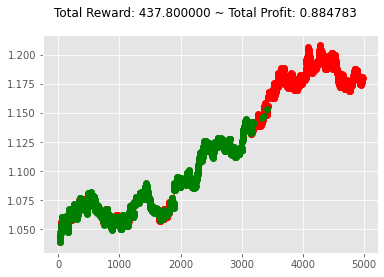

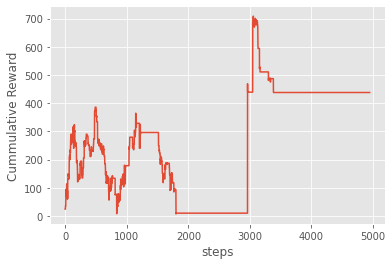

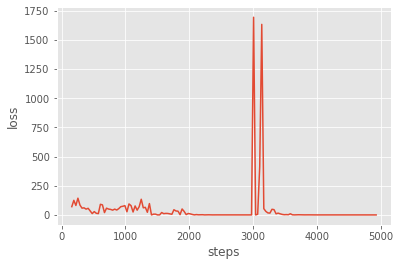

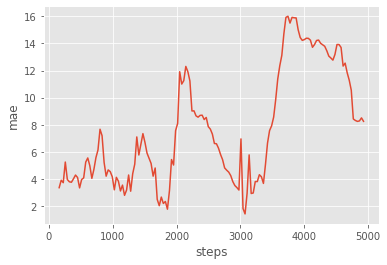

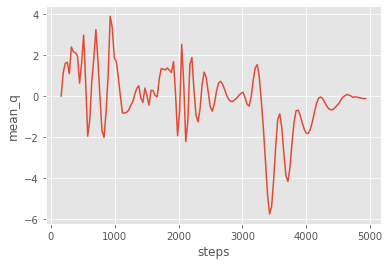

starting train 29
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 133s 134ms/step - reward: -0.2860 - cumulative_reward: 201.4512
train 29 completed. took 4050.068 seconds, total_reward: -283.0999999999783 total_profit: 0.841170134028432
min reward: -622.7000000000005, max reward: 107.80000000000013, mean_reward: -0.05720347544958139


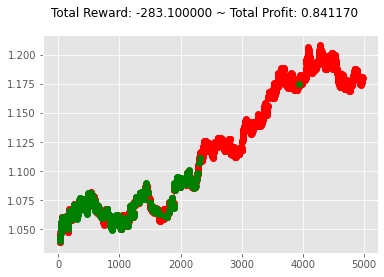

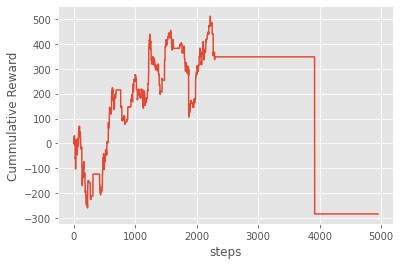

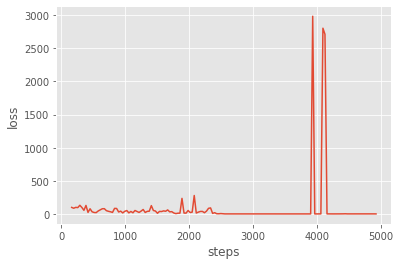

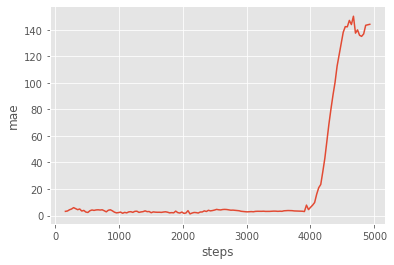

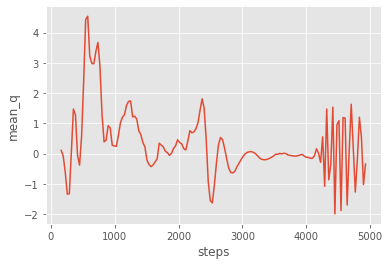

starting train 30
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 133s 134ms/step - reward: 0.4066 - cumulative_reward: 44.6836
train 30 completed. took 4217.935 seconds, total_reward: 402.49999999994776 total_profit: 0.8883553714592226
min reward: -194.399999999999, max reward: 1223.1999999999998, mean_reward: 0.08132956152757077


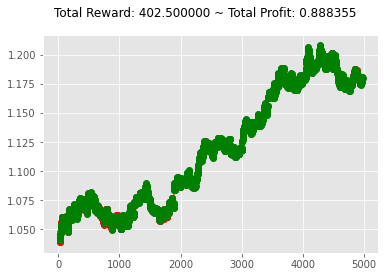

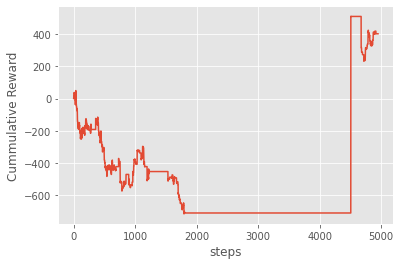

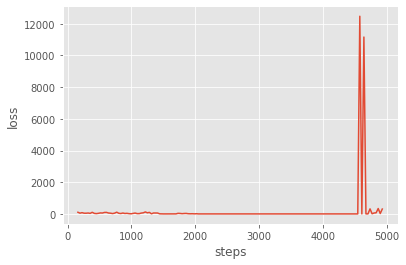

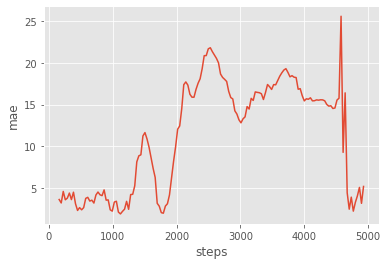

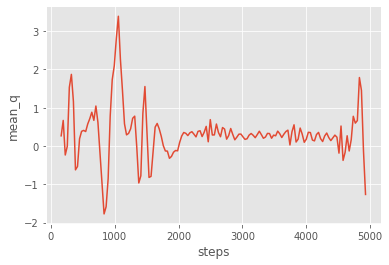

starting train 31
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 132s 134ms/step - reward: 22.1794 - cumulative_reward: 236.5314
train 31 completed. took 4384.915 seconds, total_reward: -20.3999999999378 total_profit: 0.7903932924779209
min reward: -199.30000000000004, max reward: 157.59999999999997, mean_reward: -0.004122044857534412


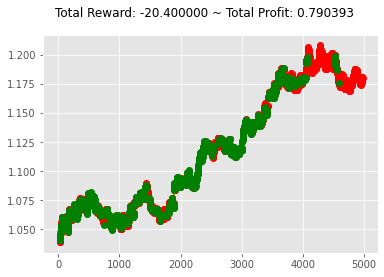

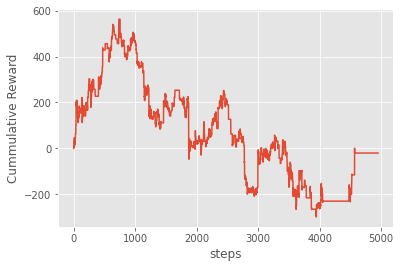

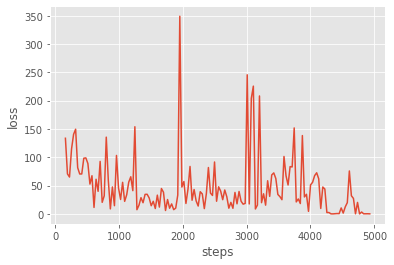

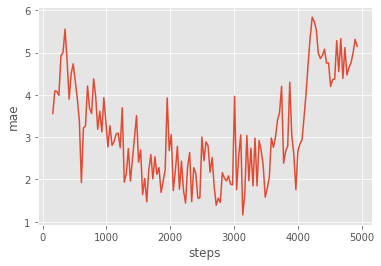

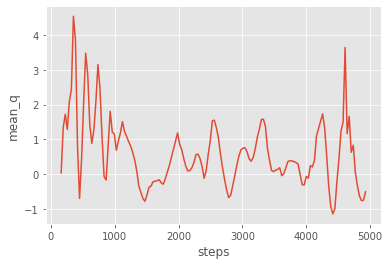

starting train 32
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 130s 132ms/step - reward: 0.1984 - cumulative_reward: 137.4965
train 32 completed. took 4549.983 seconds, total_reward: 196.40000000001888 total_profit: 0.8300846807764454
min reward: -90.20000000000027, max reward: 168.70000000000164, mean_reward: 0.03968478480501493


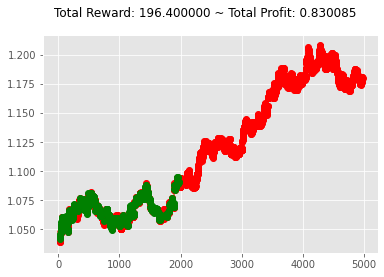

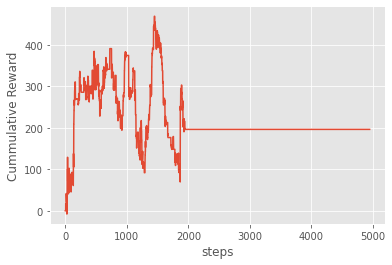

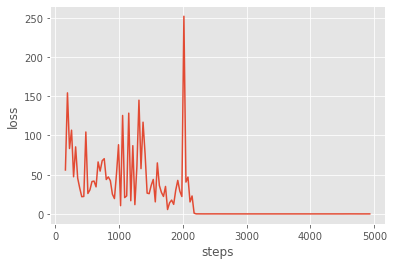

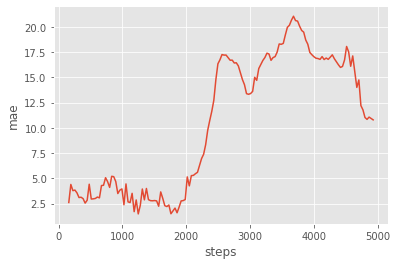

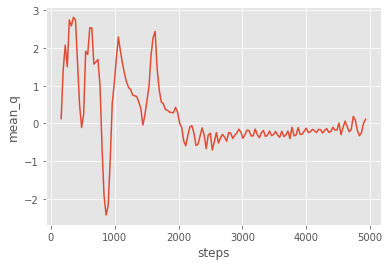

starting train 33
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 134s 135ms/step - reward: -28.3477 - cumulative_reward: 285.9318
train 33 completed. took 4718.326 seconds, total_reward: 348.7000000000398 total_profit: 0.8046989048838328
min reward: -189.20000000000047, max reward: 104.1000000000003, mean_reward: 0.07045867852092136


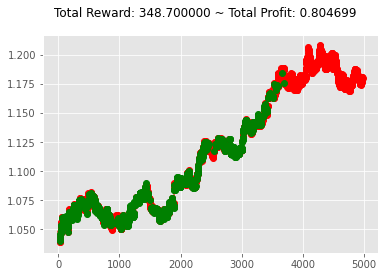

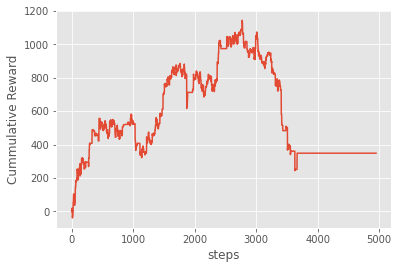

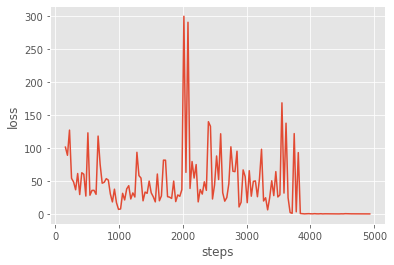

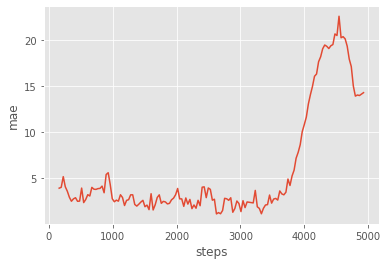

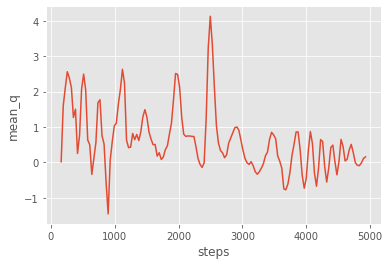

starting train 34
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 132s 133ms/step - reward: 24.5959 - cumulative_reward: -431.5411
train 34 completed. took 4885.423 seconds, total_reward: -993.9000000000742 total_profit: 0.8032256182268622
min reward: -256.0999999999991, max reward: 90.60000000000068, mean_reward: -0.20082845019197296


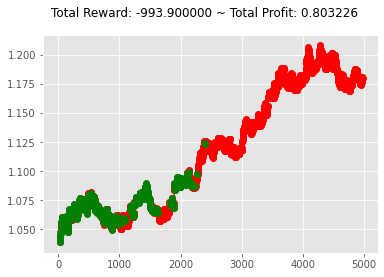

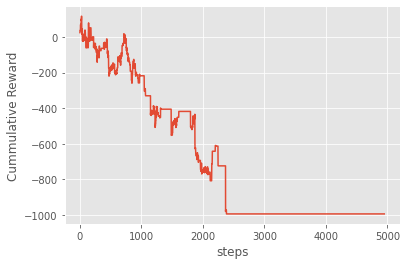

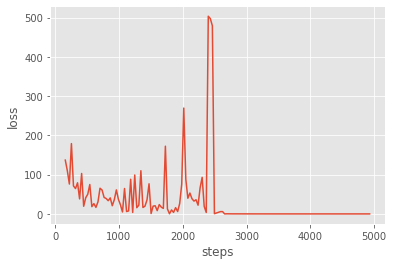

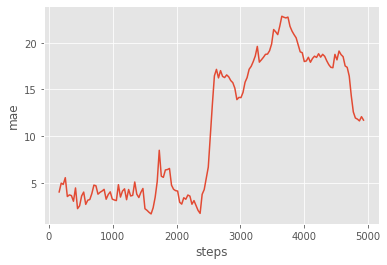

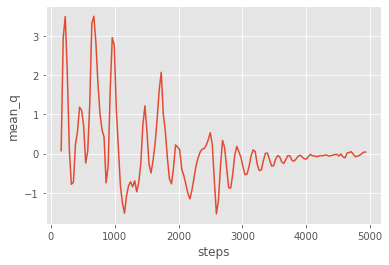

starting train 35
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 135s 137ms/step - reward: 0.2515 - cumulative_reward: 196.3532
train 35 completed. took 5055.252 seconds, total_reward: 248.90000000004045 total_profit: 0.8592699718873331
min reward: -247.10000000000232, max reward: 290.9000000000028, mean_reward: 0.050292988482529895


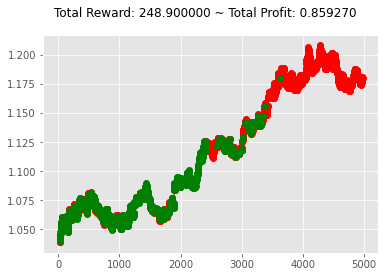

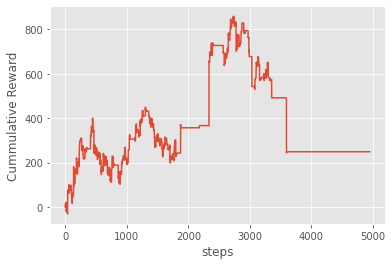

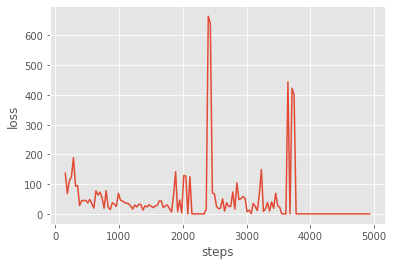

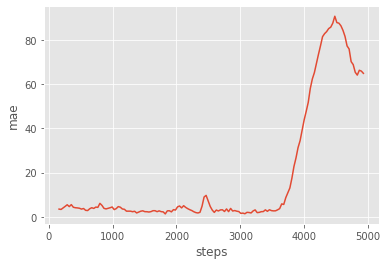

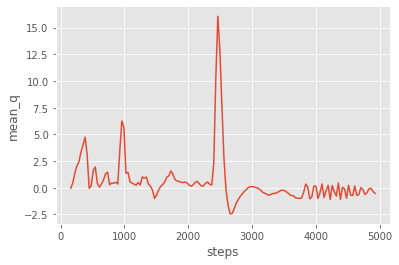

starting train 36
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 135s 137ms/step - reward: 0.7482 - cumulative_reward: 576.9499
train 36 completed. took 5226.350 seconds, total_reward: 740.5999999999813 total_profit: 0.8737195620898722
min reward: -155.69999999999862, max reward: 323.0999999999984, mean_reward: 0.14964639321074585


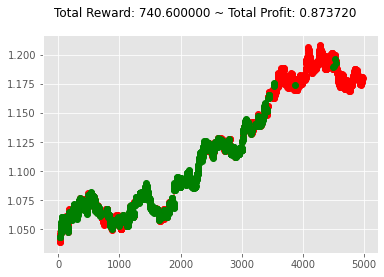

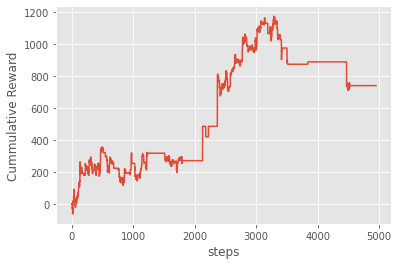

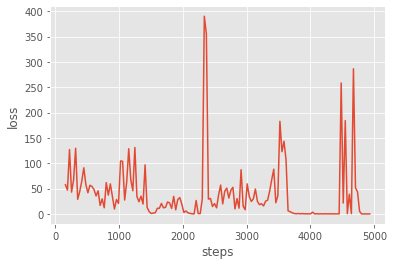

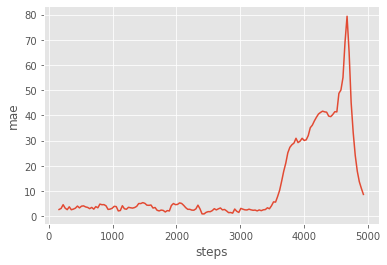

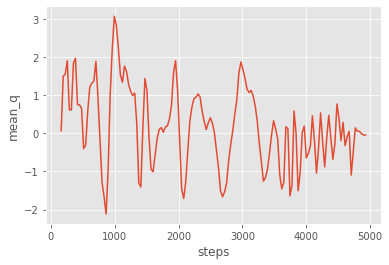

starting train 37
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 138s 140ms/step - reward: 1.1278 - cumulative_reward: 727.0618
train 37 completed. took 5401.827 seconds, total_reward: 1116.3000000000281 total_profit: 0.7826974516682093
min reward: -122.70000000000225, max reward: 197.69999999999843, mean_reward: 0.22556071933724553


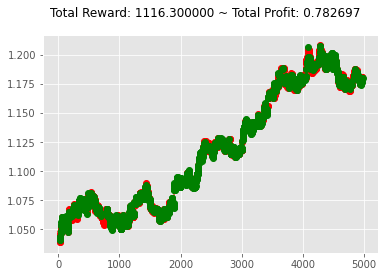

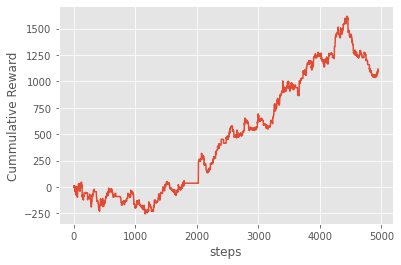

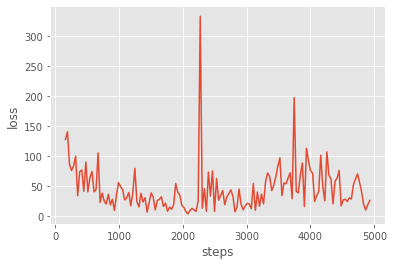

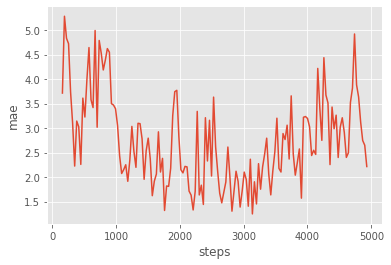

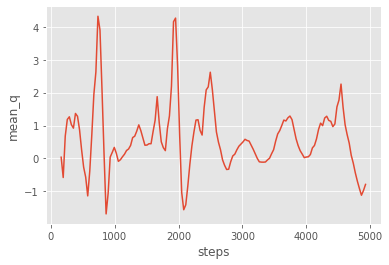

starting train 38
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 138s 140ms/step - reward: 38.3444 - cumulative_reward: -140.2999
train 38 completed. took 5576.803 seconds, total_reward: 340.89999999992966 total_profit: 0.7944777254360574
min reward: -143.59999999999928, max reward: 140.1000000000008, mean_reward: 0.06888260254595467


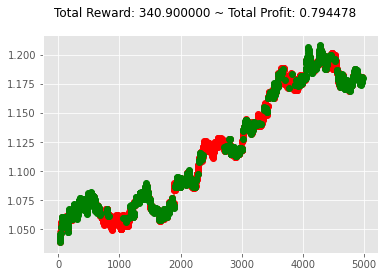

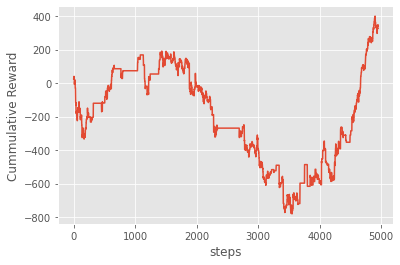

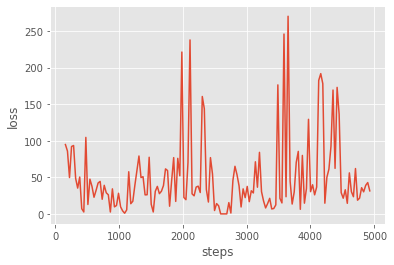

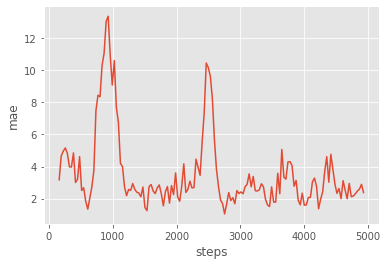

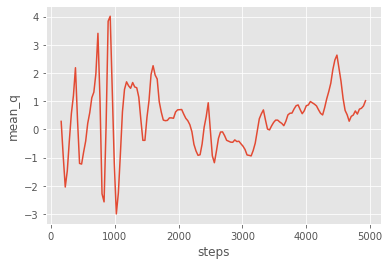

starting train 39
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 140s 141ms/step - reward: 0.4530 - cumulative_reward: 72.1282
train 39 completed. took 5752.606 seconds, total_reward: 448.3999999999461 total_profit: 0.884753679401462
min reward: -159.3, max reward: 511.299999999999, mean_reward: 0.09060416245705114


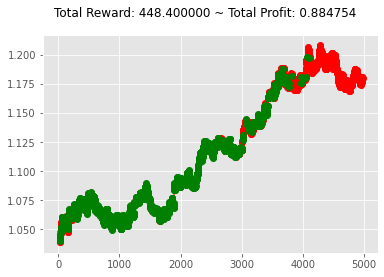

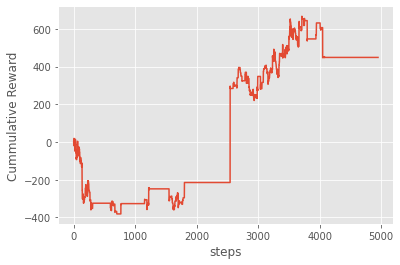

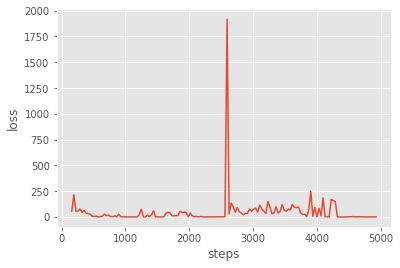

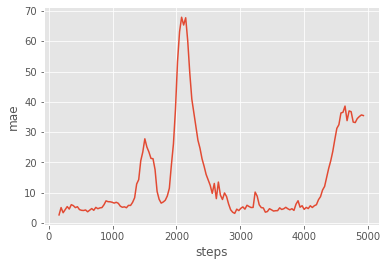

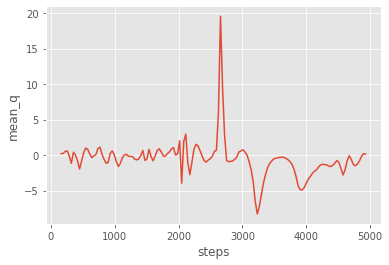

starting train 40
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 140s 142ms/step - reward: -11.7879 - cumulative_reward: -797.9469
train 40 completed. took 5929.624 seconds, total_reward: -1274.8000000000275 total_profit: 0.7797767119805391
min reward: -168.70000000000164, max reward: 80.90000000000153, mean_reward: -0.257587391392206


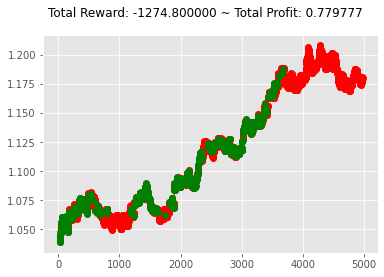

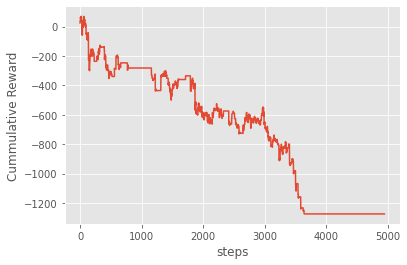

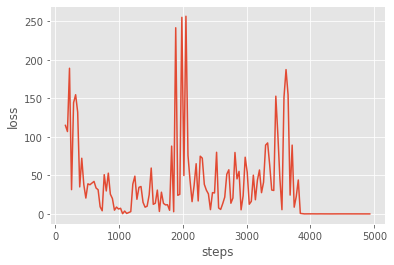

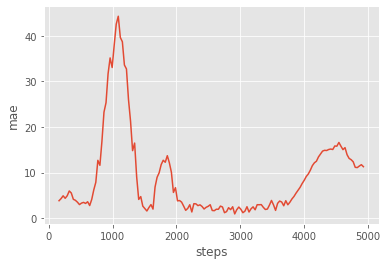

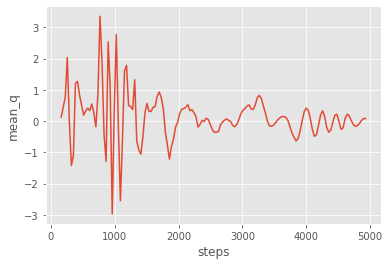

starting train 41
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 143s 145ms/step - reward: 0.6458 - cumulative_reward: 376.9890
train 41 completed. took 6110.800 seconds, total_reward: 639.1999999999954 total_profit: 0.9044460216833494
min reward: -154.50000000000185, max reward: 1034.1999999999985, mean_reward: 0.1291574055364711


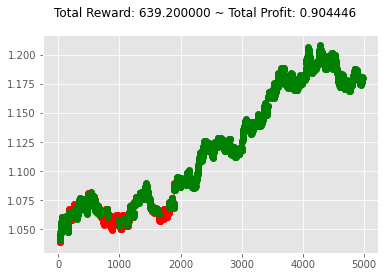

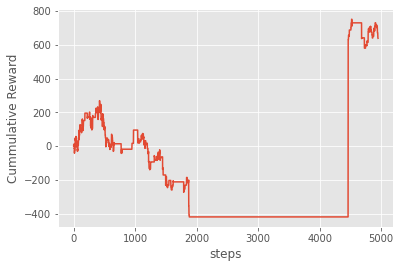

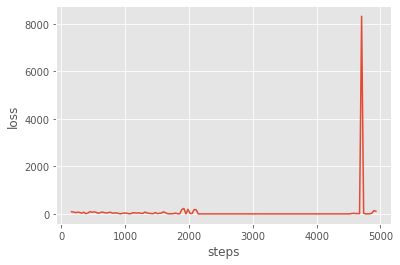

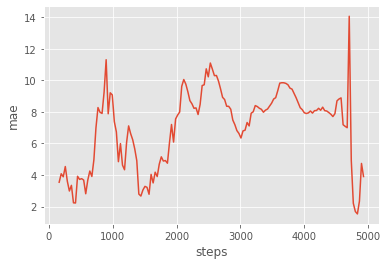

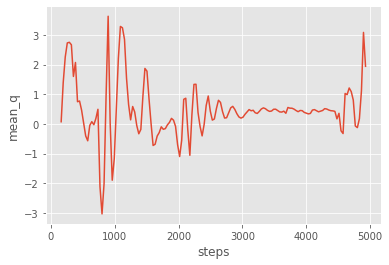

starting train 42
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 146s 147ms/step - reward: 0.3498 - cumulative_reward: 108.4043
train 42 completed. took 6293.819 seconds, total_reward: 346.20000000004745 total_profit: 0.8792585224559805
min reward: -129.89999999999836, max reward: 1174.0999999999979, mean_reward: 0.06995352596485097


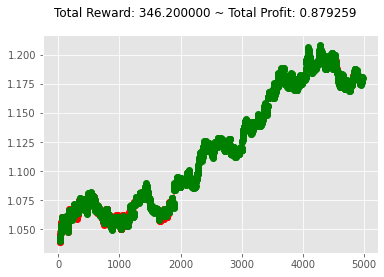

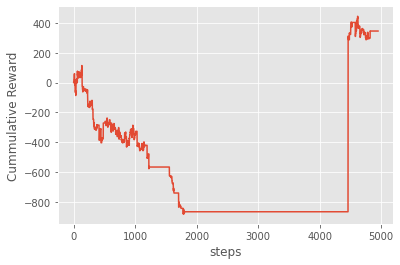

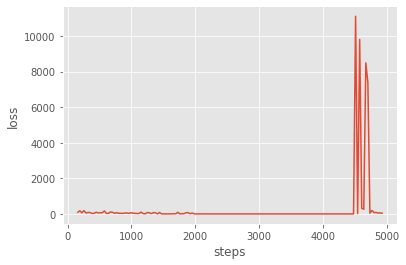

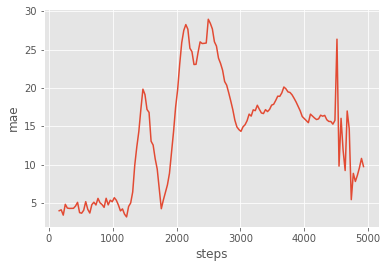

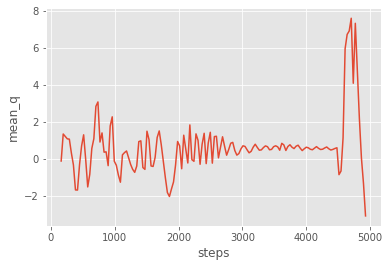

starting train 43
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 146s 147ms/step - reward: 14.4444 - cumulative_reward: 572.0811
train 43 completed. took 6478.294 seconds, total_reward: 1231.700000000074 total_profit: 0.8417267232114961
min reward: -149.59999999999863, max reward: 165.50000000000065, mean_reward: 0.24887856132553524


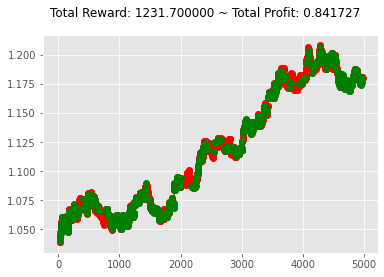

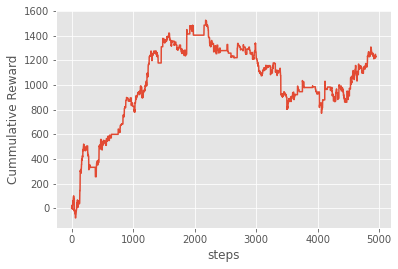

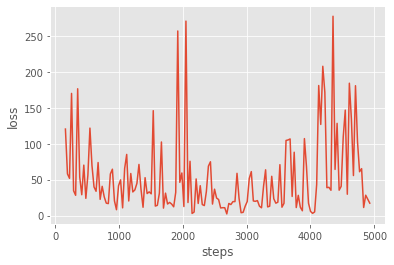

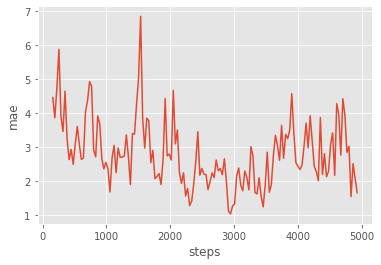

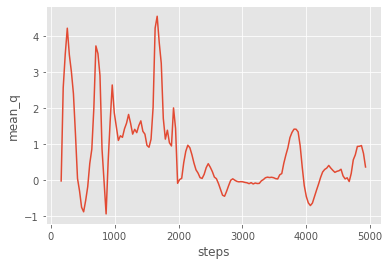

starting train 44
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 147s 149ms/step - reward: -13.3093 - cumulative_reward: -154.9784
train 44 completed. took 6672.541 seconds, total_reward: -603.1000000000146 total_profit: 0.7635672346538122
min reward: -195.19999999999982, max reward: 132.29999999999853, mean_reward: -0.12186300262679624


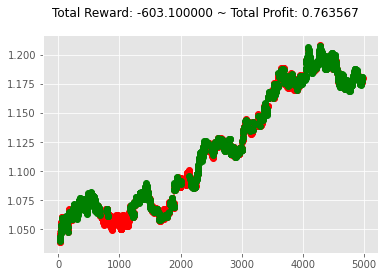

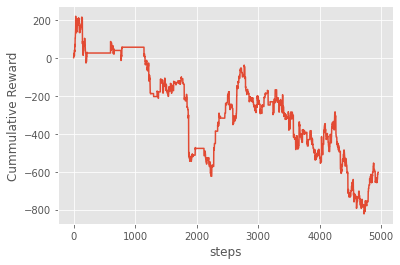

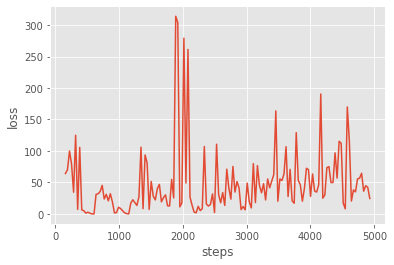

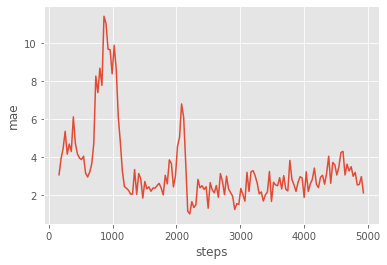

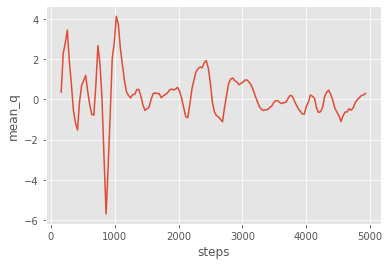

starting train 45
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 151s 152ms/step - reward: -32.6396 - cumulative_reward: 31.0740
train 45 completed. took 6864.417 seconds, total_reward: 59.7999999999213 total_profit: 0.7989902209303323
min reward: -168.70000000000164, max reward: 92.60000000000046, mean_reward: 0.012083249141224751


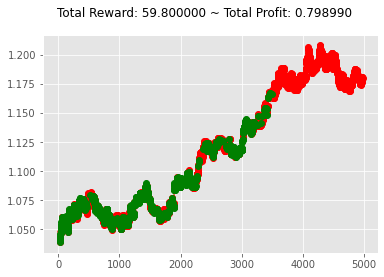

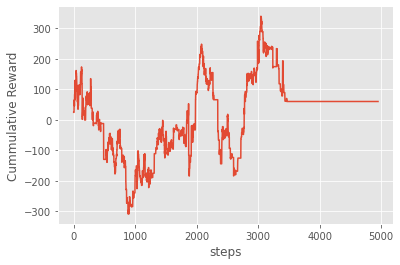

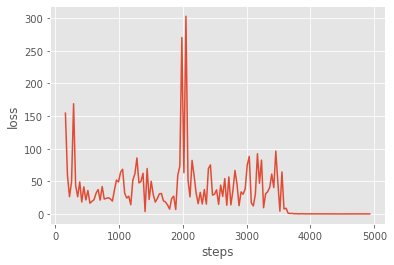

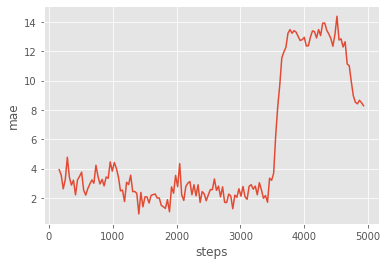

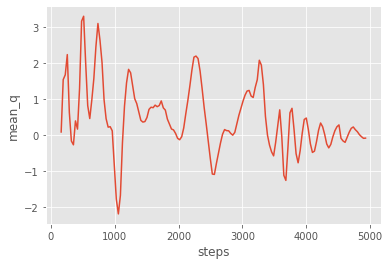

starting train 46
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 151s 153ms/step - reward: -12.3965 - cumulative_reward: 437.1154
train 46 completed. took 7055.472 seconds, total_reward: 795.2999999999857 total_profit: 0.9310825943345553
min reward: -113.30000000000284, max reward: 1161.9, mean_reward: 0.16069913113760068


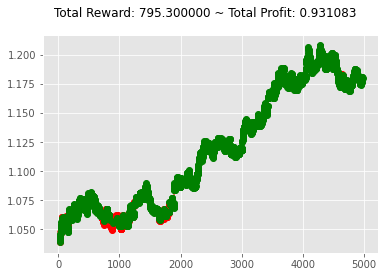

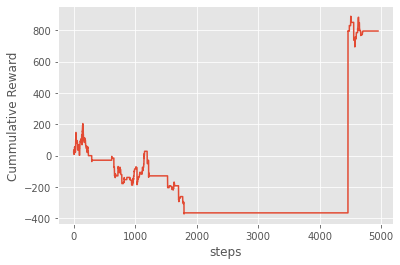

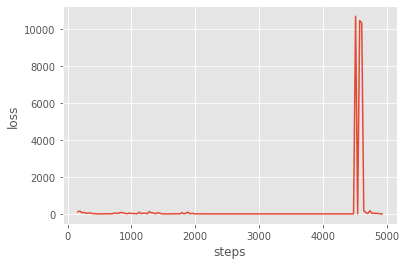

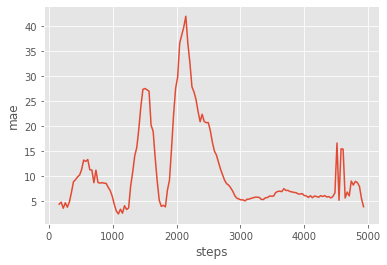

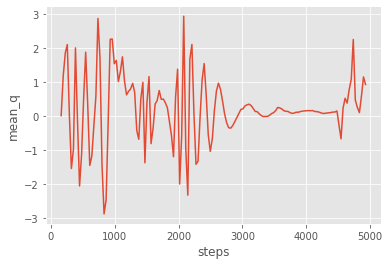

starting train 47
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 152s 154ms/step - reward: 13.7088 - cumulative_reward: 439.4441
train 47 completed. took 7247.957 seconds, total_reward: 503.5999999999375 total_profit: 0.868977015060792
min reward: -118.50000000000138, max reward: 326.90000000000106, mean_reward: 0.1017579308951177


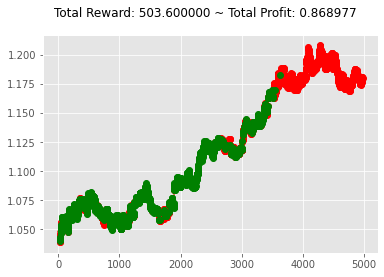

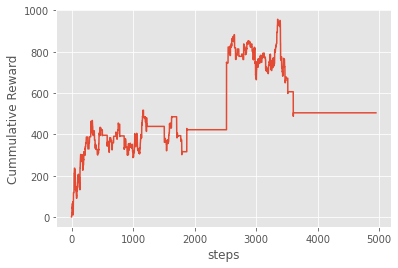

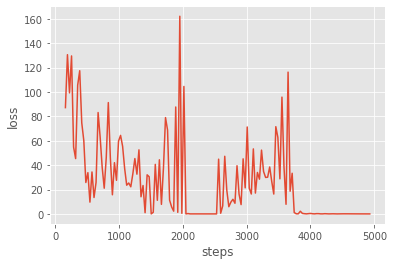

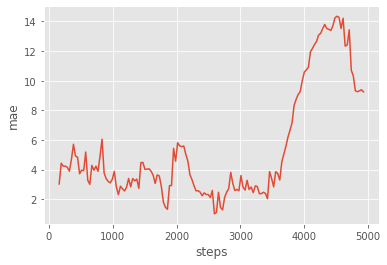

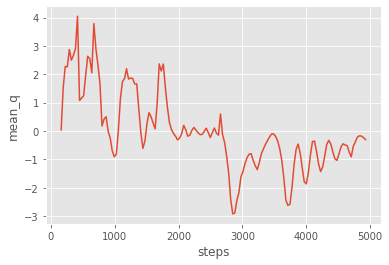

starting train 48
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 156s 158ms/step - reward: -10.0940 - cumulative_reward: -1.2946
train 48 completed. took 7443.656 seconds, total_reward: 401.89999999987776 total_profit: 0.821768910069765
min reward: -178.70000000000275, max reward: 309.29999999999905, mean_reward: 0.08120832491409936


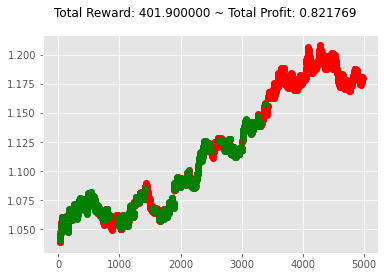

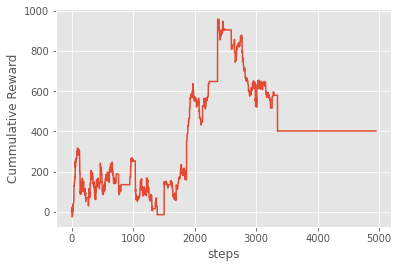

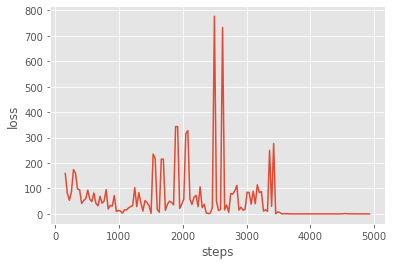

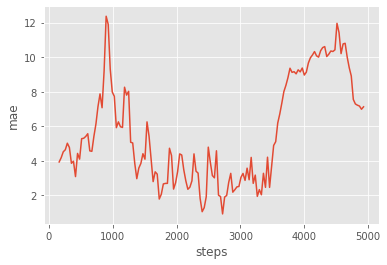

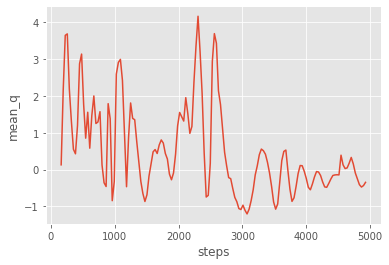

starting train 49
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 155s 156ms/step - reward: 1.1190 - cumulative_reward: 464.5978
train 49 completed. took 7638.568 seconds, total_reward: 1107.5999999999249 total_profit: 0.8341674199628252
min reward: -127.5000000000004, max reward: 168.70000000000164, mean_reward: 0.22380278844209434


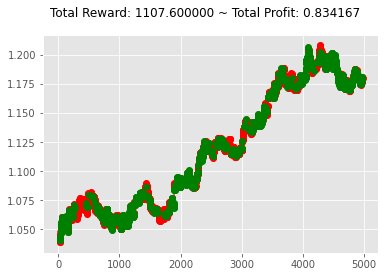

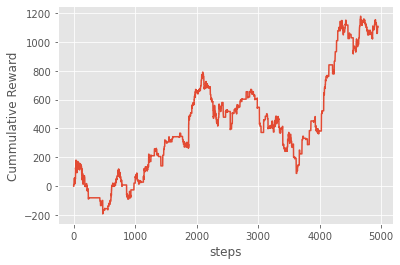

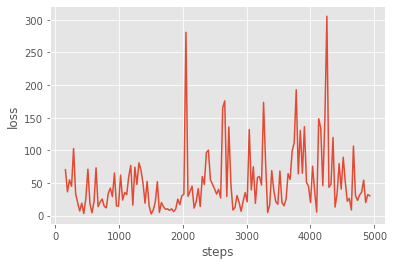

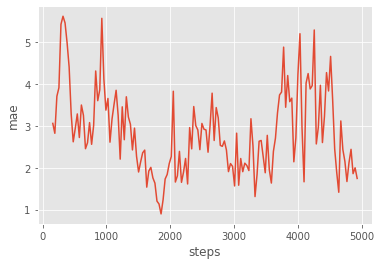

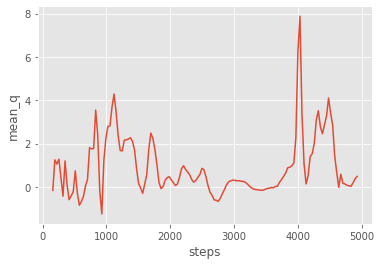

starting train 50
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 649s 656ms/step - reward: -0.6426 - cumulative_reward: -246.1983
train 50 completed. took 7839.774 seconds, total_reward: -636.000000000052 total_profit: 0.8386602214079169
min reward: -230.20000000000041, max reward: 121.29999999999752, mean_reward: -0.12851081026471045


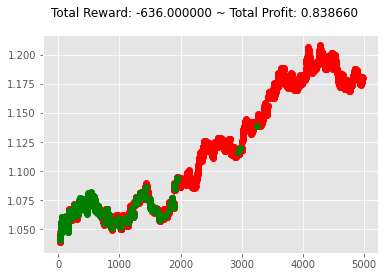

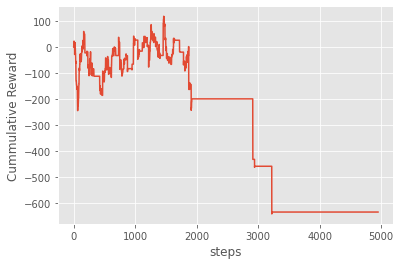

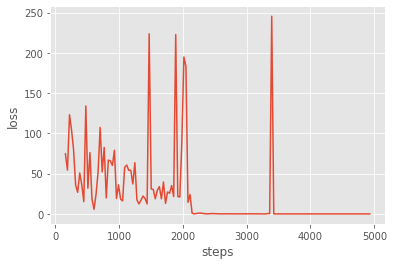

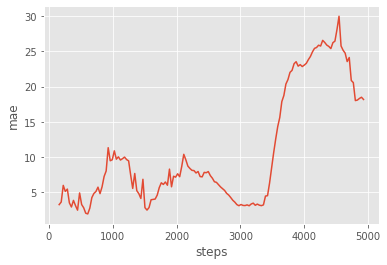

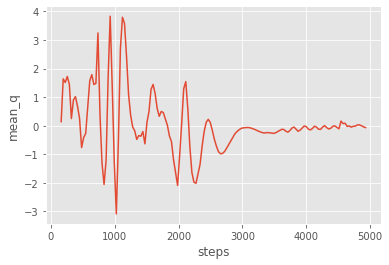

starting train 51
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 159s 161ms/step - reward: 13.4769 - cumulative_reward: -119.3557
train 51 completed. took 8041.864 seconds, total_reward: 274.0999999999989 total_profit: 0.8869141094450785
min reward: -106.5999999999967, max reward: 1207.7999999999988, mean_reward: 0.05538492624772659


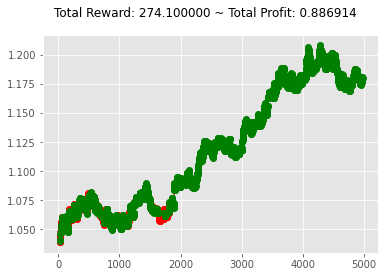

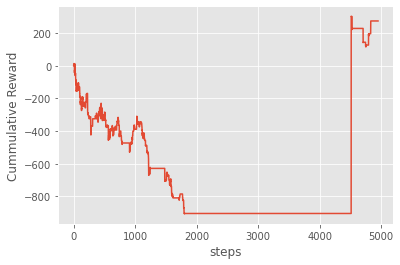

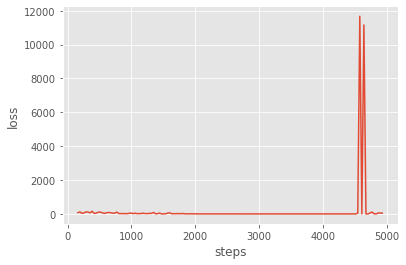

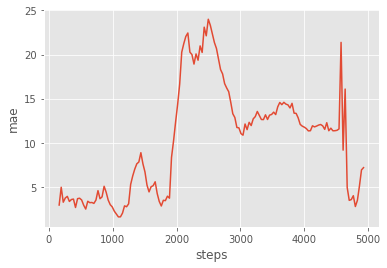

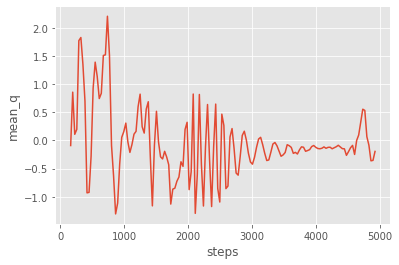

starting train 52
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 159s 161ms/step - reward: 10.6153 - cumulative_reward: -154.6950
train 52 completed. took 8242.433 seconds, total_reward: 114.09999999990602 total_profit: 0.7705600452267821
min reward: -105.80000000000034, max reward: 126.80000000000247, mean_reward: 0.023055162659104064


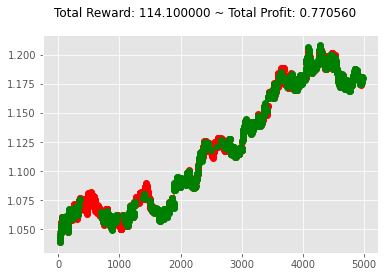

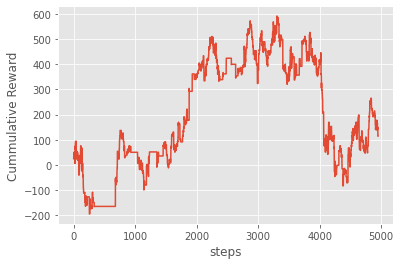

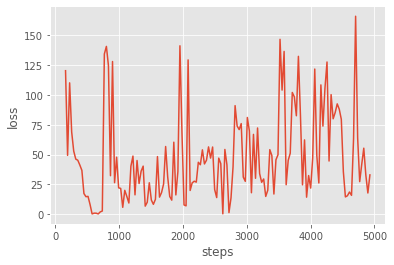

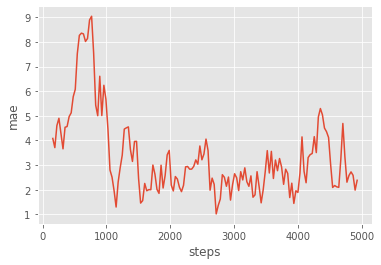

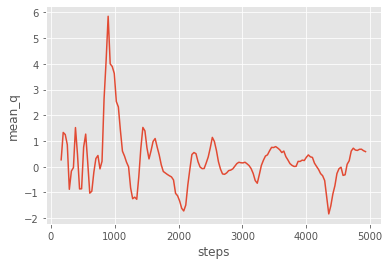

starting train 53
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 163s 165ms/step - reward: 0.4010 - cumulative_reward: 293.4013
train 53 completed. took 8447.307 seconds, total_reward: 396.8999999999867 total_profit: 0.7864659661403489
min reward: -168.70000000000164, max reward: 244.899999999999, mean_reward: 0.08019801980197751


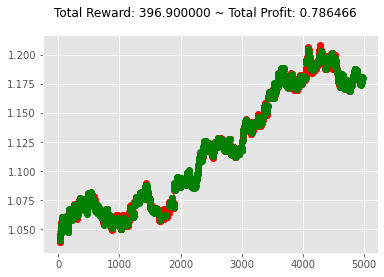

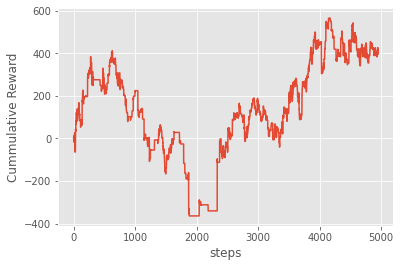

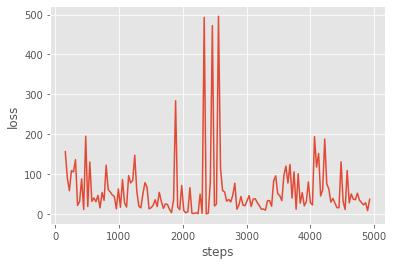

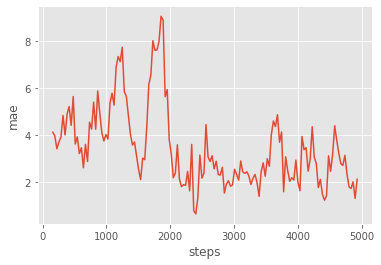

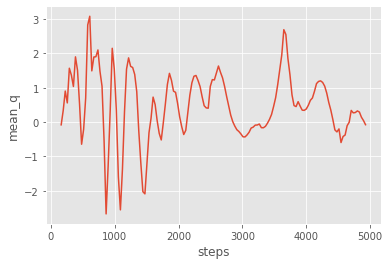

starting train 54
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 162s 164ms/step - reward: -1.3475 - cumulative_reward: -803.8163
train 54 completed. took 8652.272 seconds, total_reward: -1333.799999999995 total_profit: 0.8017330839306986
min reward: -168.70000000000164, max reward: 79.00000000000018, mean_reward: -0.2695089917154971


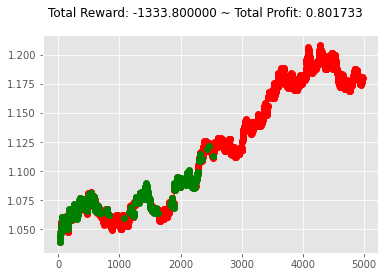

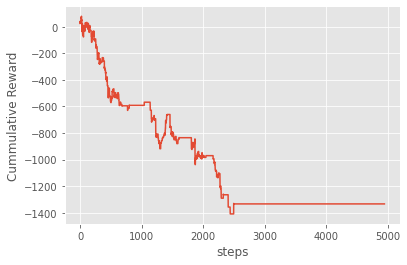

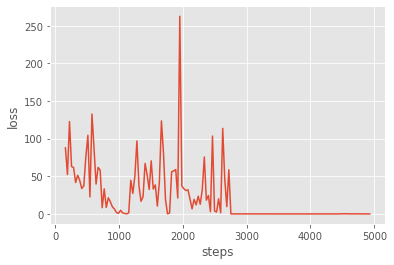

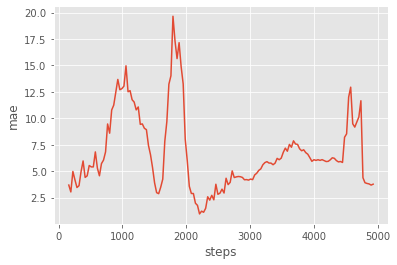

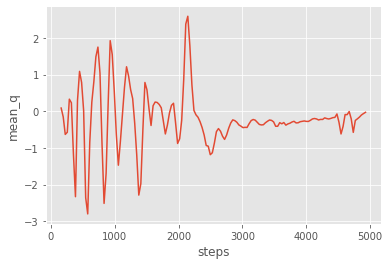

starting train 55
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 164s 165ms/step - reward: 21.4582 - cumulative_reward: -437.7620
train 55 completed. took 8859.724 seconds, total_reward: -338.2999999999847 total_profit: 0.8102598003121356
min reward: -168.70000000000164, max reward: 122.79999999999846, mean_reward: -0.06835724388765098


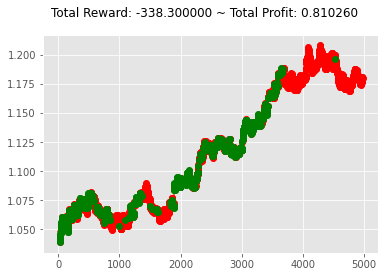

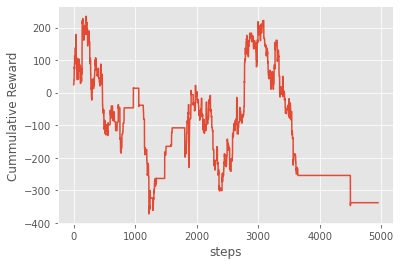

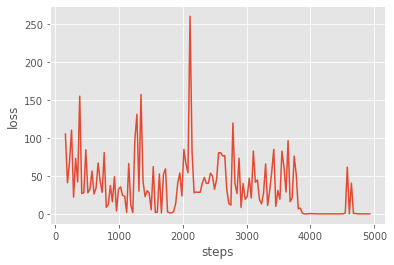

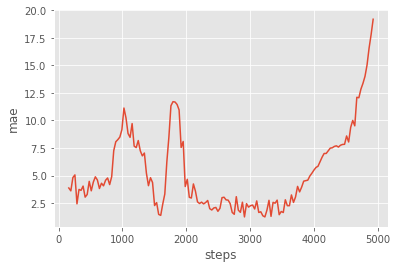

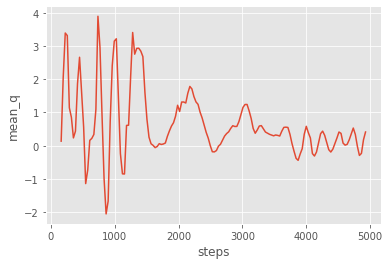

starting train 56
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 2088s 2s/step - reward: -0.4371 - cumulative_reward: -187.0003
train 56 completed. took 9072.541 seconds, total_reward: -432.6000000000253 total_profit: 0.9051104308083642
min reward: -110.99999999999888, max reward: 83.10000000000039, mean_reward: -0.08741159830269253


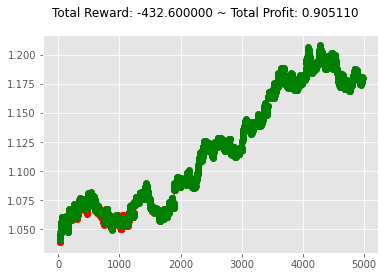

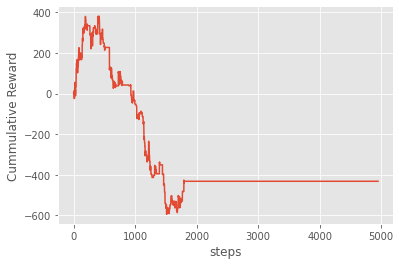

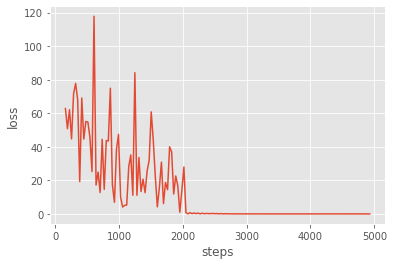

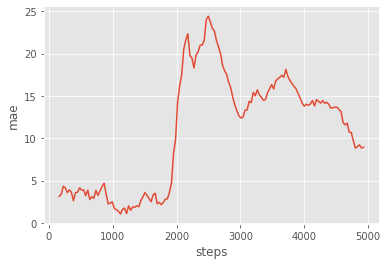

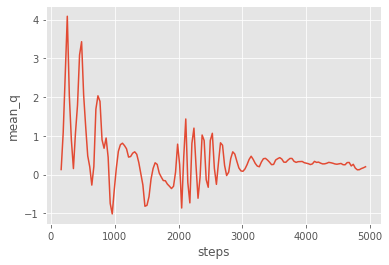

starting train 57
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 18896s 19s/step - reward: 0.5792 - cumulative_reward: 356.1491
train 57 completed. took 9473.472 seconds, total_reward: 573.2999999999624 total_profit: 0.8432567997223571
min reward: -128.09999999999988, max reward: 150.70000000000138, mean_reward: 0.11584158415840826


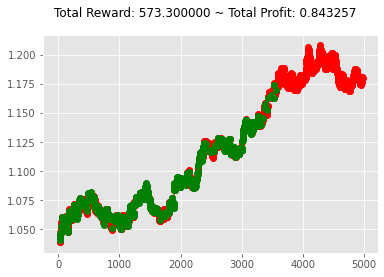

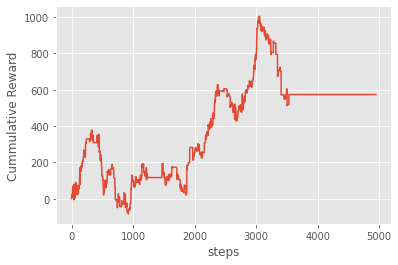

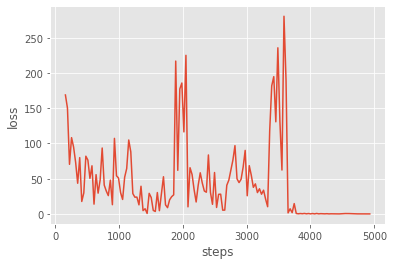

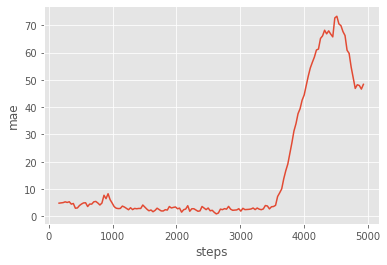

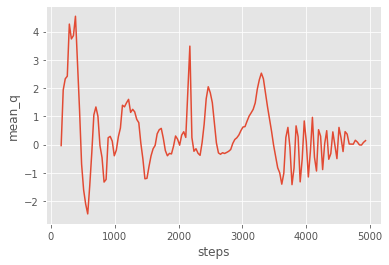

starting train 58
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 176s 178ms/step - reward: -0.0204 - cumulative_reward: -481.4475
train 58 completed. took 9694.609 seconds, total_reward: -20.200000000018285 total_profit: 0.7772374617378016
min reward: -130.90000000000046, max reward: 154.50000000000185, mean_reward: -0.004081632653064919


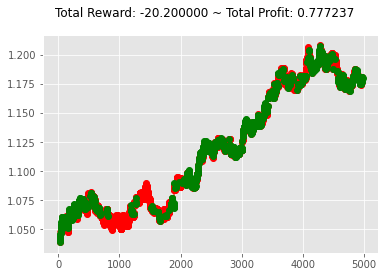

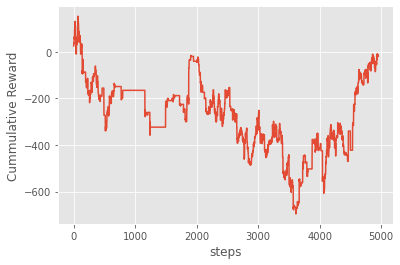

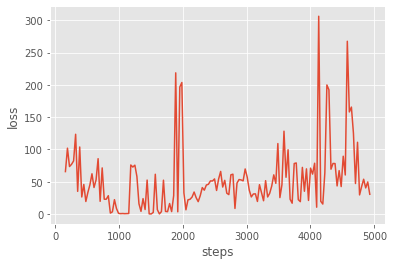

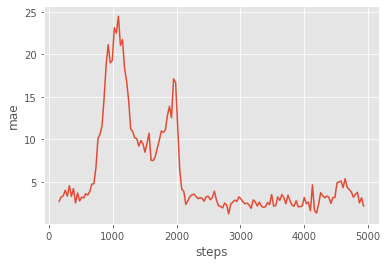

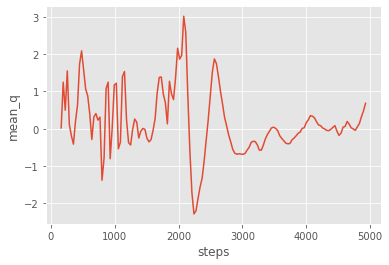

starting train 59
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 178s 180ms/step - reward: -0.1264 - cumulative_reward: -137.9030
train 59 completed. took 9918.077 seconds, total_reward: -125.09999999997811 total_profit: 0.8752379701561328
min reward: -233.2000000000023, max reward: 473.0999999999996, mean_reward: -0.02527783390583514


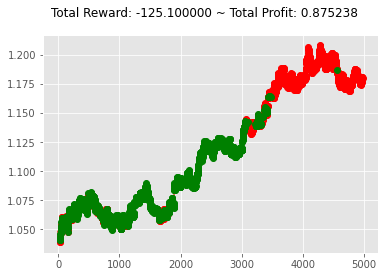

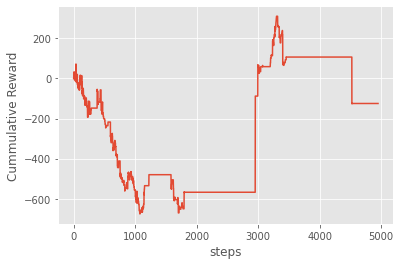

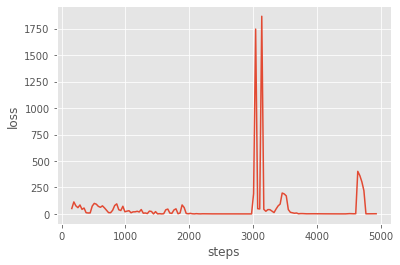

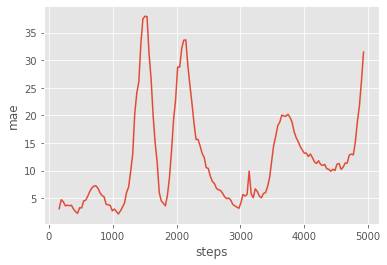

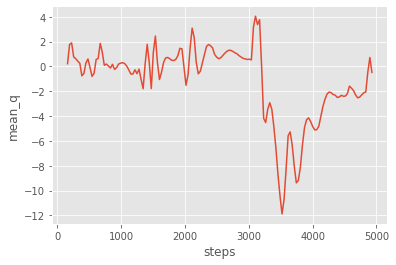

starting train 60
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 178s 180ms/step - reward: 0.5590 - cumulative_reward: 330.7278
train 60 completed. took 10140.757 seconds, total_reward: 553.300000000072 total_profit: 0.8457711511437178
min reward: -120.8000000000009, max reward: 354.79999999999956, mean_reward: 0.11180036370985492


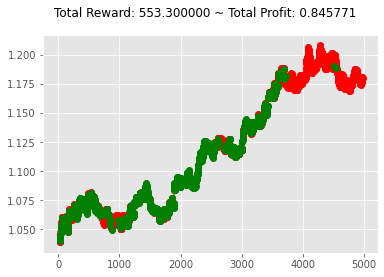

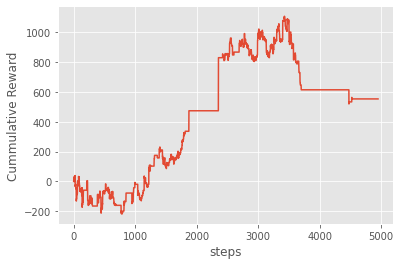

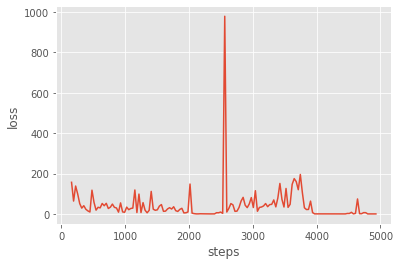

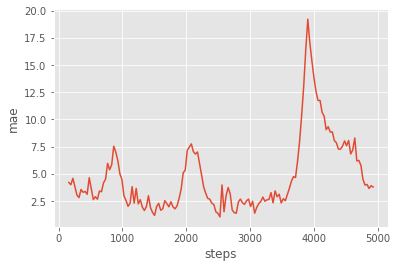

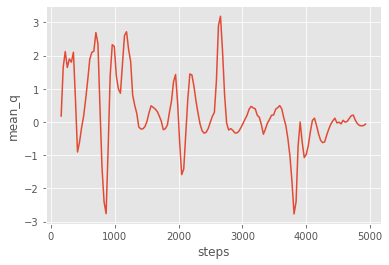

starting train 61
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 181s 183ms/step - reward: 0.1613 - cumulative_reward: 120.9917
train 61 completed. took 10367.448 seconds, total_reward: 159.7000000000576 total_profit: 0.7933507443205574
min reward: -86.799999999998, max reward: 183.80000000000064, mean_reward: 0.03226914528188676


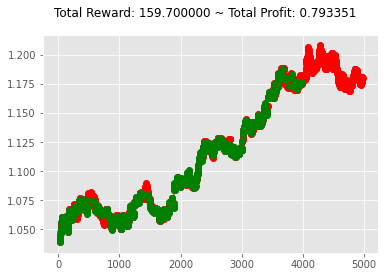

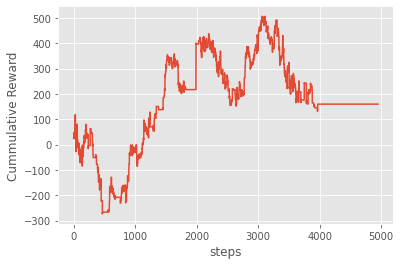

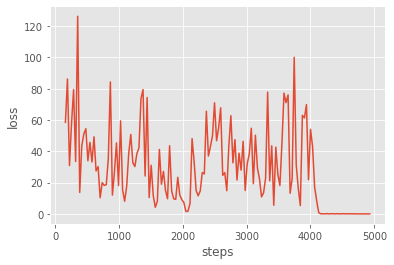

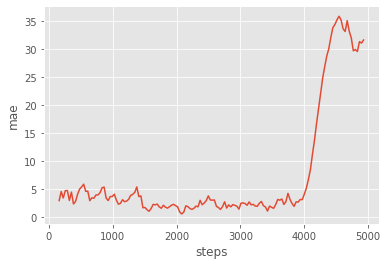

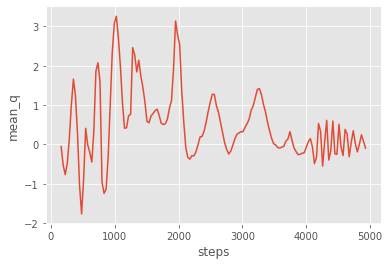

starting train 62
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 180s 182ms/step - reward: -0.2903 - cumulative_reward: -253.6254
train 62 completed. took 10592.773 seconds, total_reward: -287.3000000000102 total_profit: 0.8466026792183557
min reward: -120.70000000000024, max reward: 101.09999999999842, mean_reward: -0.05805213174378868


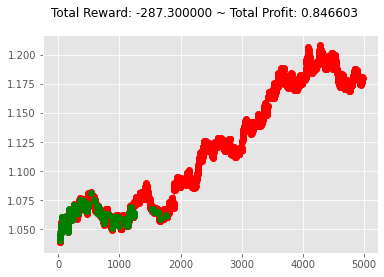

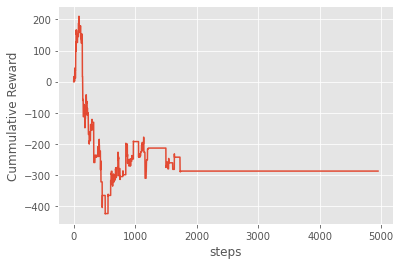

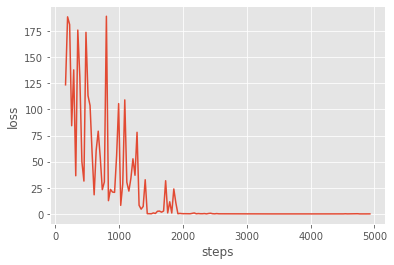

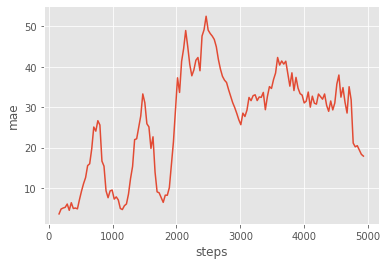

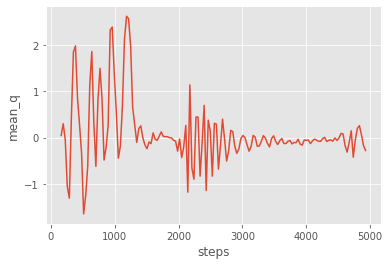

starting train 63
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 188s 190ms/step - reward: -20.9646 - cumulative_reward: 313.9741
train 63 completed. took 10825.838 seconds, total_reward: 925.9000000000452 total_profit: 0.8548532794113015
min reward: -128.69999999999936, max reward: 142.199999999999, mean_reward: 0.1870883006668105


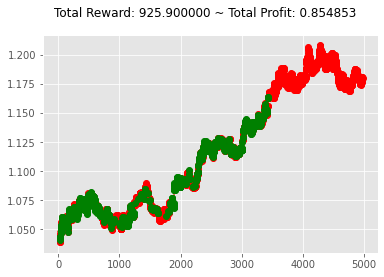

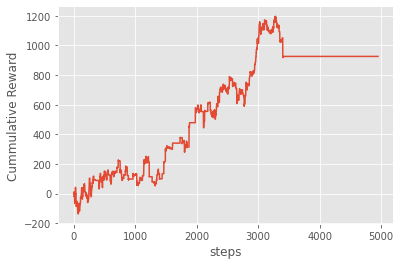

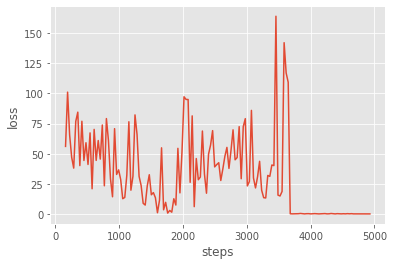

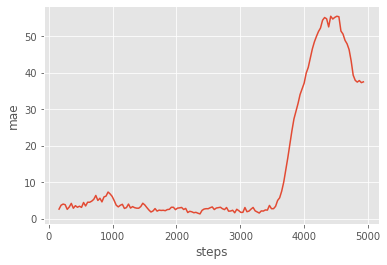

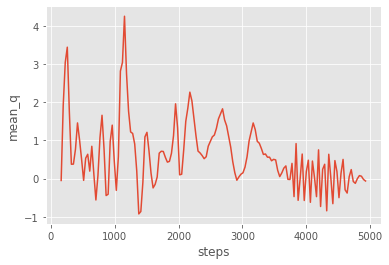

starting train 64
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 188s 190ms/step - reward: 6.1360 - cumulative_reward: -10.7451
train 64 completed. took 11060.085 seconds, total_reward: -360.3000000000135 total_profit: 0.8722318797694624
min reward: -484.2999999999997, max reward: 545.8999999999992, mean_reward: -0.07280258638108981


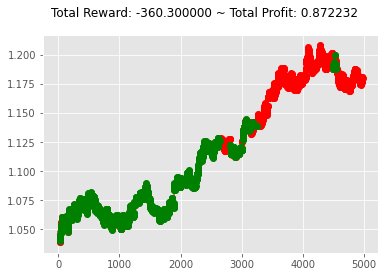

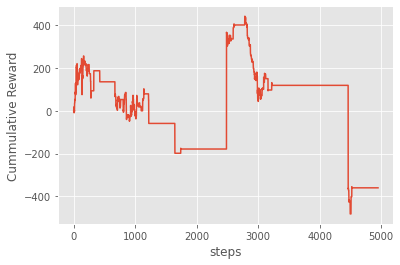

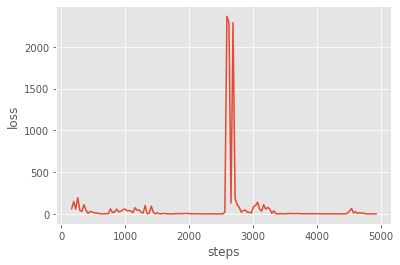

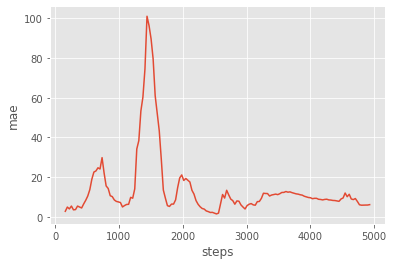

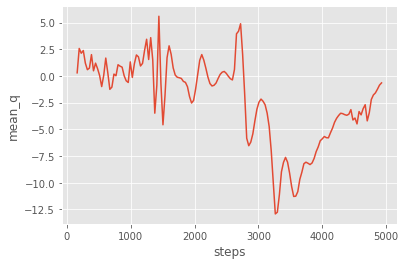

starting train 65
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 189s 191ms/step - reward: 10.3053 - cumulative_reward: -355.2759
train 65 completed. took 11294.800 seconds, total_reward: -192.7000000000037 total_profit: 0.8226554715845594
min reward: -504.800000000003, max reward: 185.10000000000025, mean_reward: -0.0389371590220254


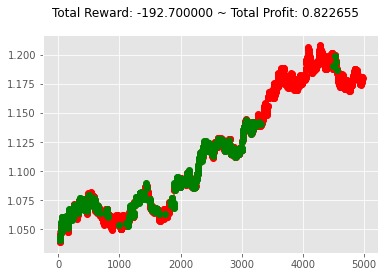

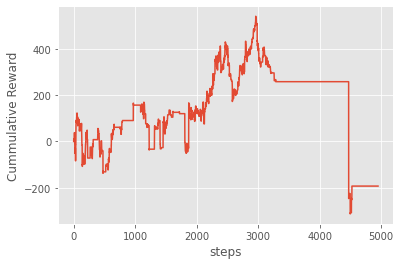

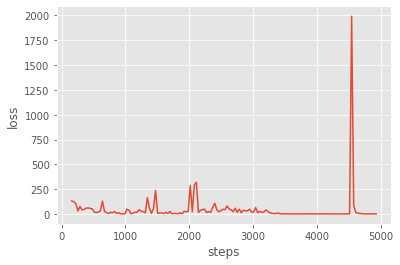

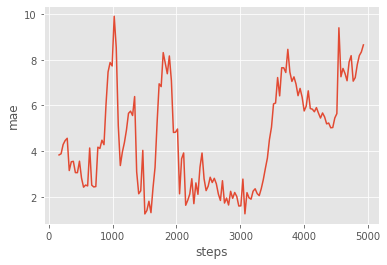

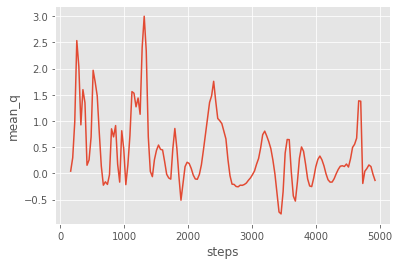

starting train 66
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 191s 193ms/step - reward: 0.3022 - cumulative_reward: -314.7348
train 66 completed. took 11532.809 seconds, total_reward: 299.0999999999328 total_profit: 0.8703681960642488
min reward: -120.4000000000005, max reward: 535.4999999999999, mean_reward: 0.060436451808432566


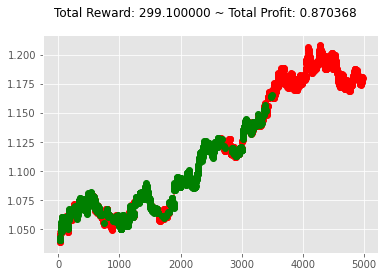

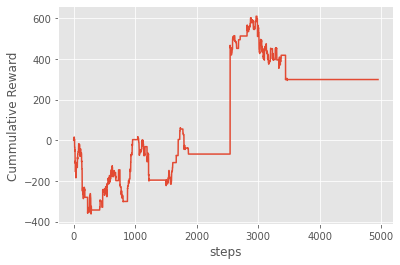

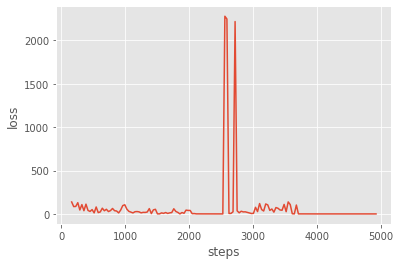

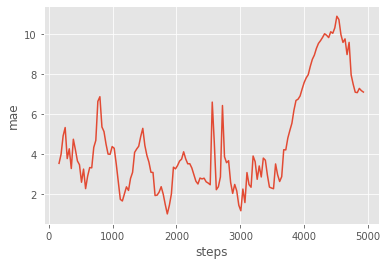

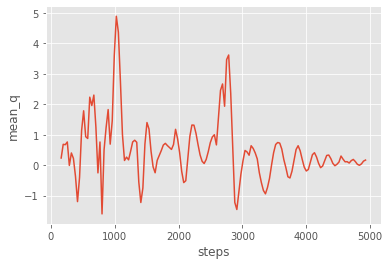

starting train 67
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 194s 196ms/step - reward: -1.2372 - cumulative_reward: -385.1115
train 67 completed. took 11775.330 seconds, total_reward: -1224.600000000007 total_profit: 0.8370079866501021
min reward: -1068.3999999999983, max reward: 101.89999999999921, mean_reward: -0.2474439280662774


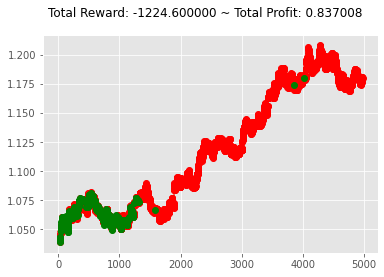

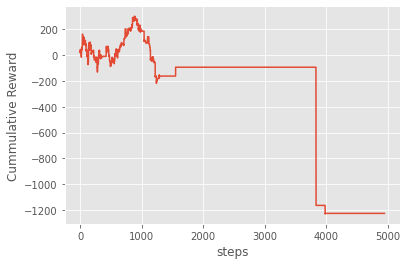

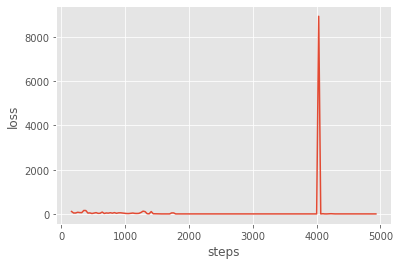

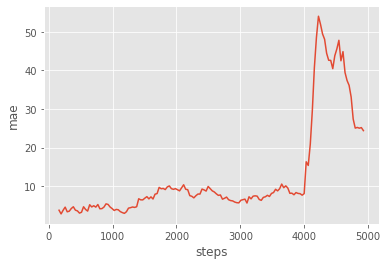

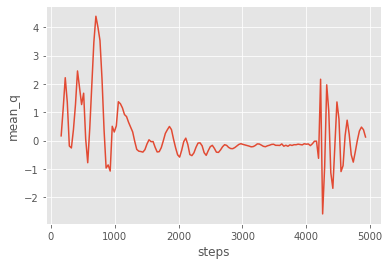

starting train 68
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 199s 201ms/step - reward: 6.8240 - cumulative_reward: -45.8688
train 68 completed. took 12022.951 seconds, total_reward: 320.6999999999448 total_profit: 0.7833743691813464
min reward: -126.9000000000009, max reward: 182.59999999999943, mean_reward: 0.0648009698928965


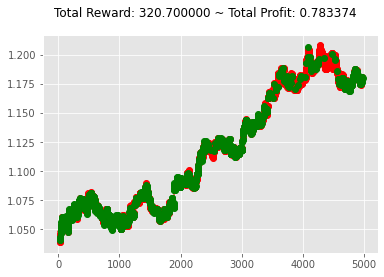

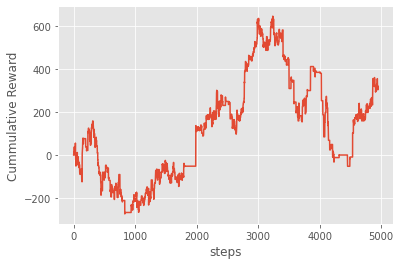

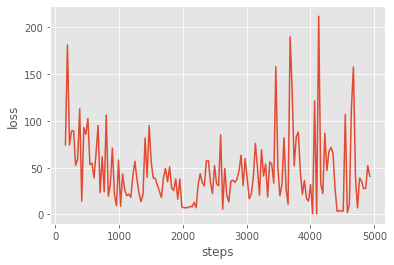

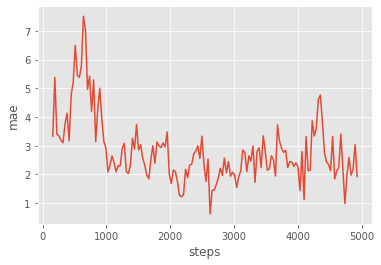

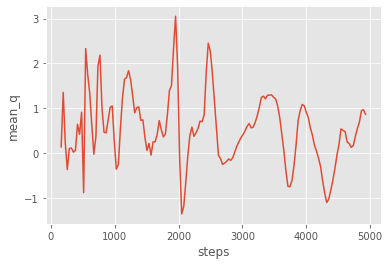

starting train 69
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 208s 211ms/step - reward: -0.1760 - cumulative_reward: -100.0924
train 69 completed. took 12280.848 seconds, total_reward: -174.2000000000885 total_profit: 0.7925265123038994
min reward: -145.60000000000127, max reward: 100.49999999999892, mean_reward: -0.03519903010711022


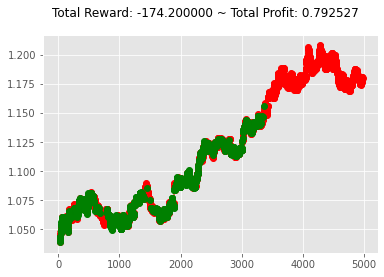

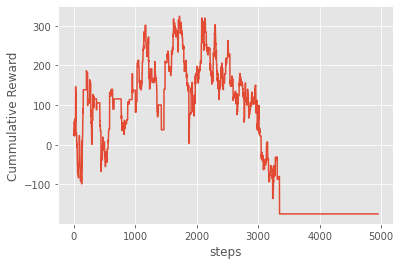

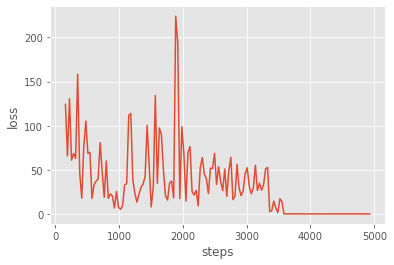

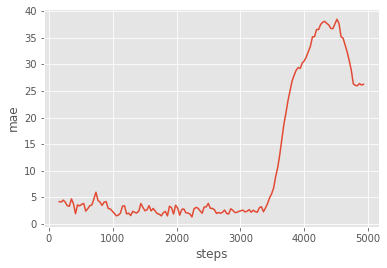

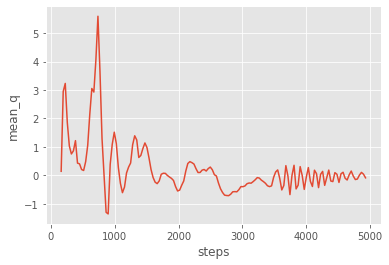

starting train 70
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 202s 204ms/step - reward: 12.5300 - cumulative_reward: -298.7207
train 70 completed. took 12532.796 seconds, total_reward: -663.2000000000039 total_profit: 0.8179551539412608
min reward: -668.7000000000021, max reward: 73.30000000000058, mean_reward: -0.13400687007476336


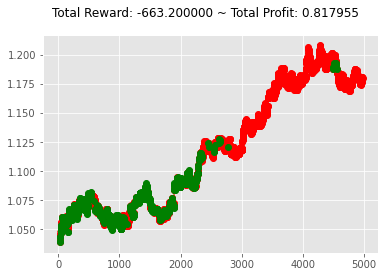

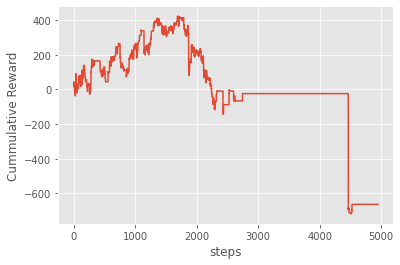

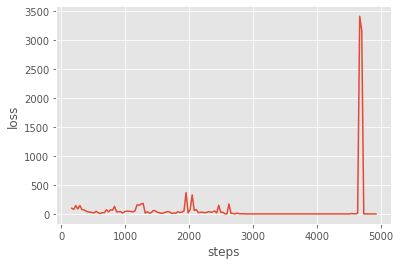

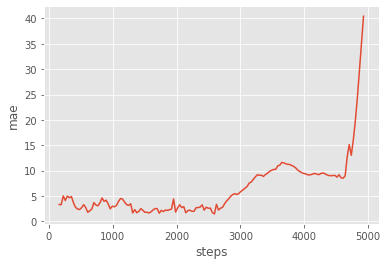

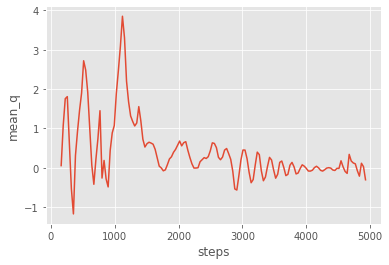

starting train 71
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 203s 205ms/step - reward: -0.4834 - cumulative_reward: 45.4320
train 71 completed. took 12784.212 seconds, total_reward: -478.49999999993537 total_profit: 0.7981138394424758
min reward: -200.8999999999994, max reward: 147.99999999999923, mean_reward: -0.09668619923215506


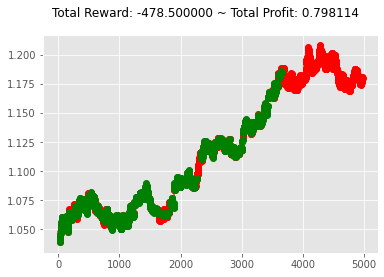

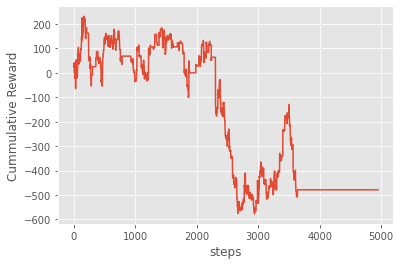

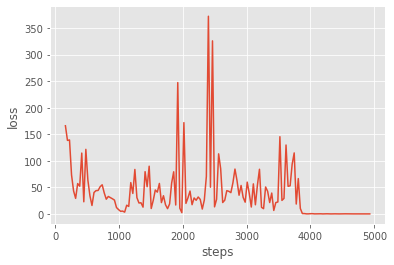

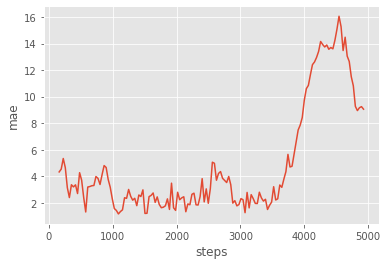

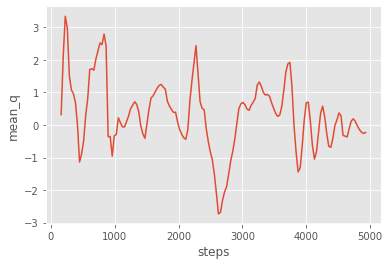

starting train 72
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 6434s 7s/step - reward: -18.0321 - cumulative_reward: 679.8961
train 72 completed. took 13097.300 seconds, total_reward: 1156.0000000000073 total_profit: 0.835283934687687
min reward: -101.70000000000013, max reward: 185.8000000000004, mean_reward: 0.23358254192766362


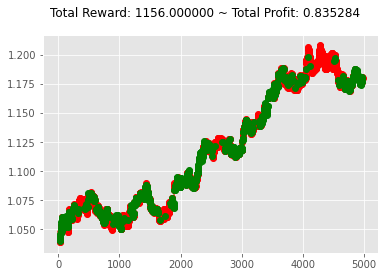

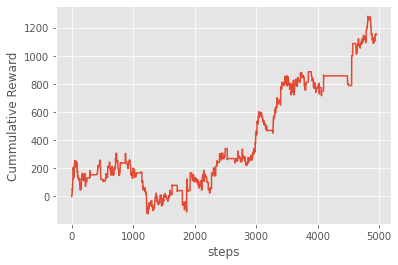

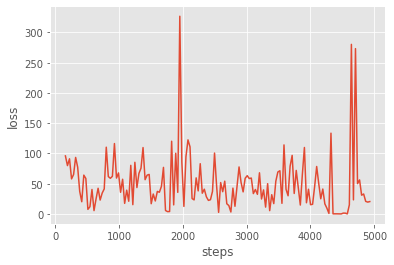

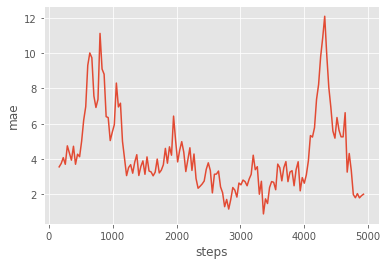

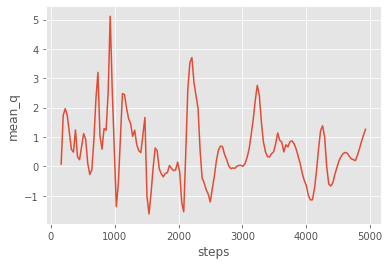

starting train 73
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 208s 210ms/step - reward: -13.0287 - cumulative_reward: -30.1491
train 73 completed. took 13369.154 seconds, total_reward: 169.59999999999764 total_profit: 0.8302842865270437
min reward: -127.79999999999791, max reward: 170.40000000000165, mean_reward: 0.034269549403919505


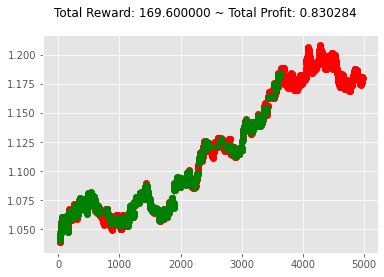

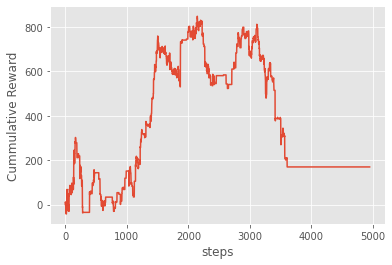

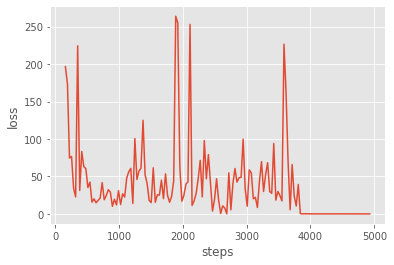

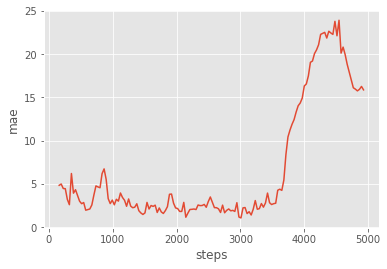

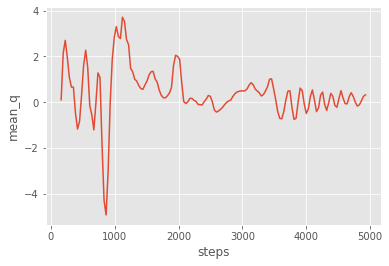

starting train 74
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 206s 208ms/step - reward: 10.4595 - cumulative_reward: 89.1736
train 74 completed. took 13626.756 seconds, total_reward: -40.09999999990494 total_profit: 0.7844627373980506
min reward: -107.80000000000013, max reward: 129.90000000000057, mean_reward: -0.008102646999374609


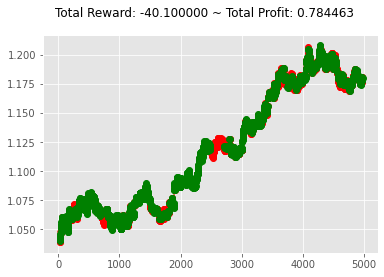

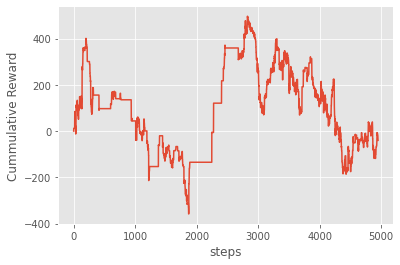

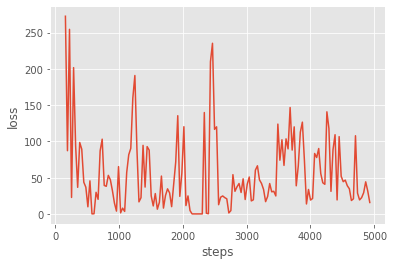

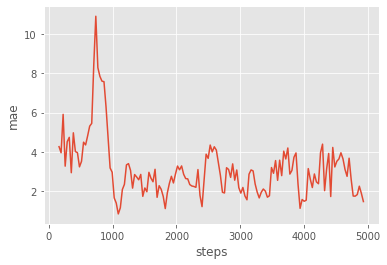

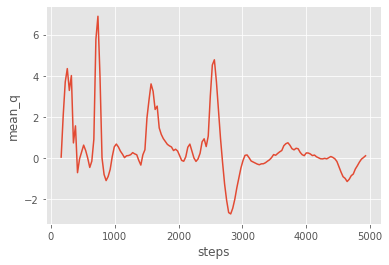

starting train 75
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 352s 356ms/step - reward: -0.0342 - cumulative_reward: 365.4971
train 75 completed. took 13896.096 seconds, total_reward: -33.89999999994788 total_profit: 0.7896051783975941
min reward: -141.69999999999794, max reward: 130.50000000000006, mean_reward: -0.00684986866032489


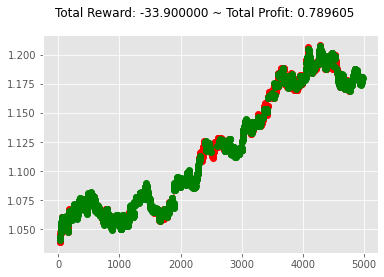

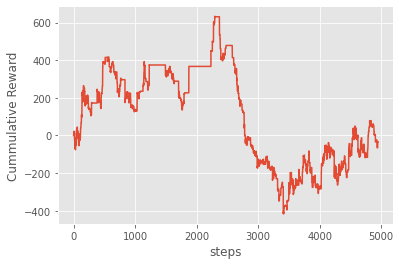

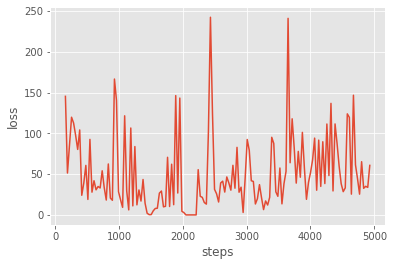

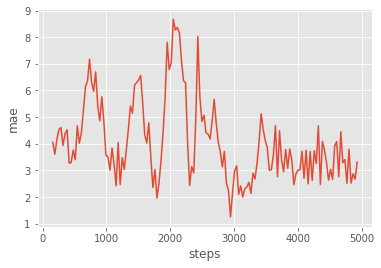

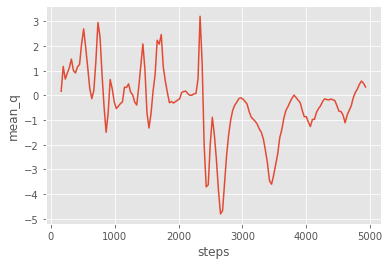

starting train 76
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 218s 220ms/step - reward: 0.2757 - cumulative_reward: 92.0517
train 76 completed. took 14167.949 seconds, total_reward: 272.89999999994745 total_profit: 0.8289990352963278
min reward: -93.19999999999773, max reward: 163.10000000000048, mean_reward: 0.05514245302080167


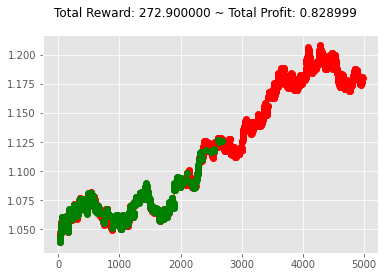

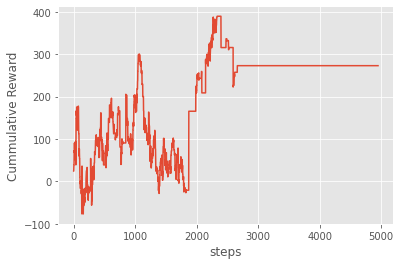

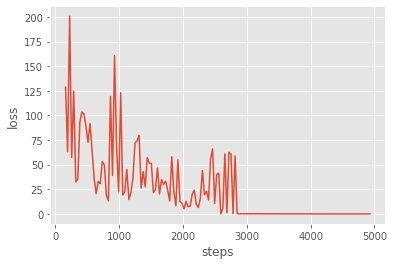

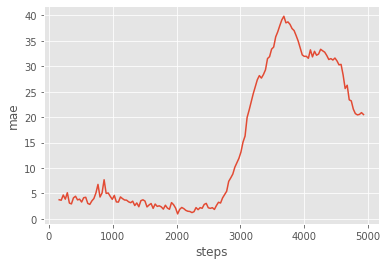

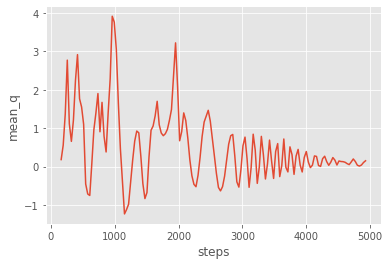

starting train 77
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 218s 220ms/step - reward: -21.8136 - cumulative_reward: 80.9632
train 77 completed. took 14439.629 seconds, total_reward: 382.5000000000483 total_profit: 0.8321200073249518
min reward: -100.00000000000009, max reward: 199.30000000000004, mean_reward: 0.07728834107901562


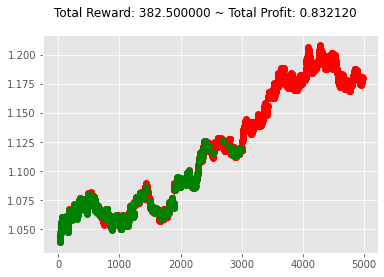

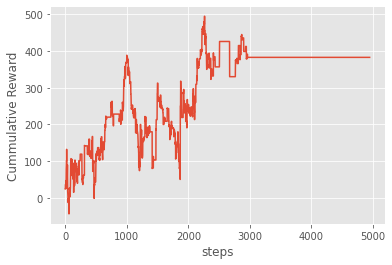

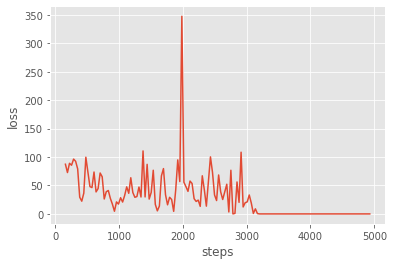

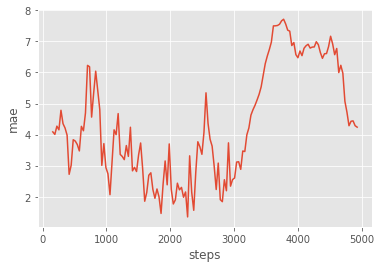

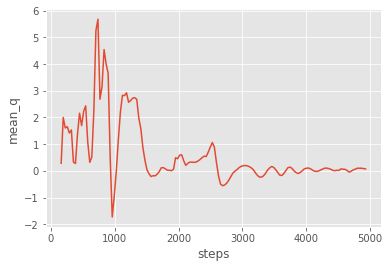

starting train 78
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 219s 221ms/step - reward: -28.8898 - cumulative_reward: 44.5816
train 78 completed. took 14711.152 seconds, total_reward: -286.79999999998705 total_profit: 0.8336898119839776
min reward: -252.3999999999993, max reward: 132.59999999999826, mean_reward: -0.05795110123256962


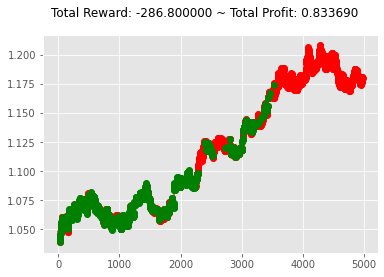

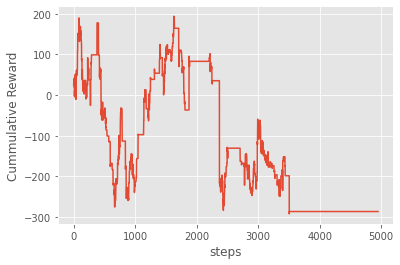

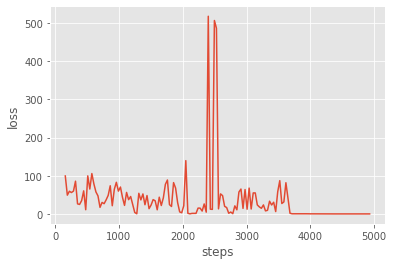

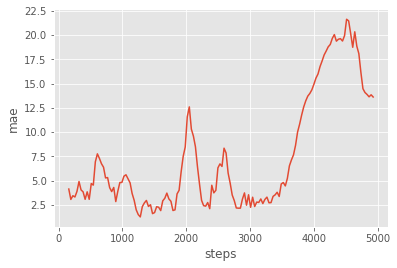

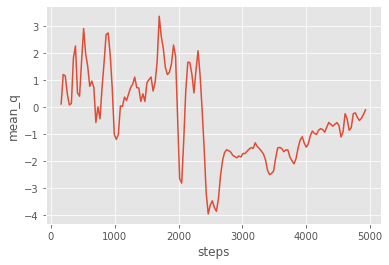

starting train 79
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 220s 223ms/step - reward: -16.3991 - cumulative_reward: -228.2219
train 79 completed. took 14985.348 seconds, total_reward: -1087.899999999999 total_profit: 0.7160443847207965
min reward: -170.40000000000165, max reward: 110.89999999999822, mean_reward: -0.21982218630026246


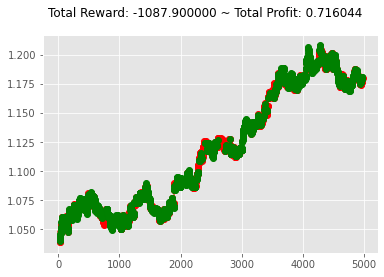

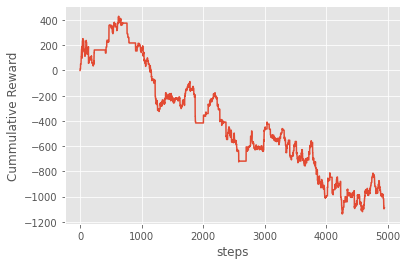

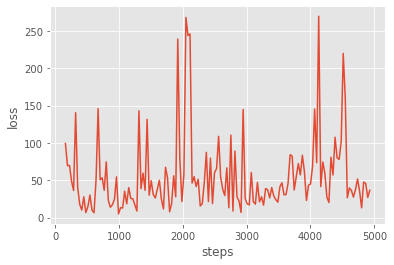

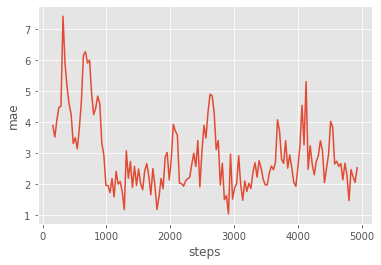

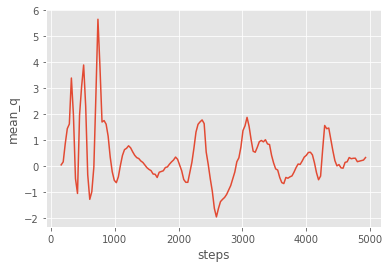

starting train 80
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 266s 268ms/step - reward: 31.3568 - cumulative_reward: -476.2532
train 80 completed. took 15270.745 seconds, total_reward: -735.5999999999143 total_profit: 0.7848463085484955
min reward: -111.30000000000084, max reward: 168.70000000000164, mean_reward: -0.14863608809858847


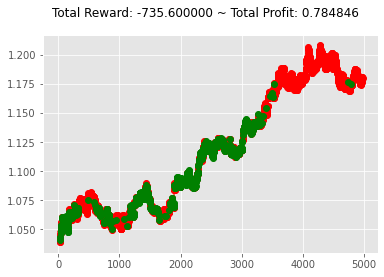

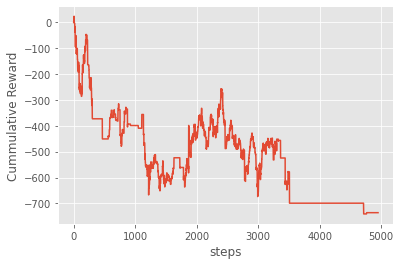

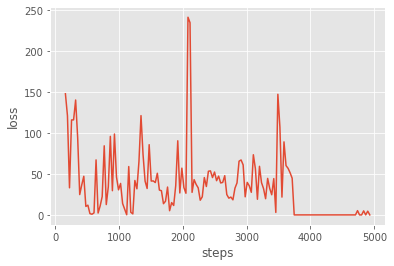

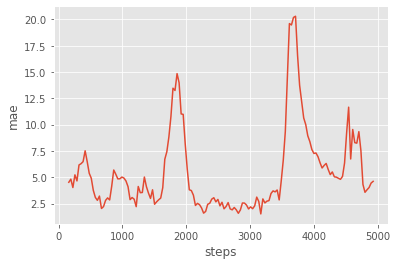

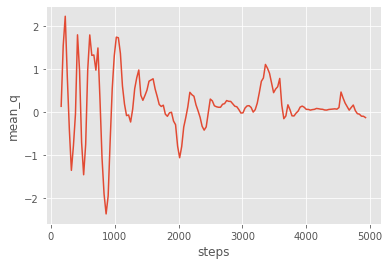

starting train 81
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 225s 228ms/step - reward: 10.9517 - cumulative_reward: 542.2648
train 81 completed. took 15551.948 seconds, total_reward: 447.10000000002043 total_profit: 0.7976533296109074
min reward: -149.49999999999795, max reward: 171.1000000000018, mean_reward: 0.09034148312790875


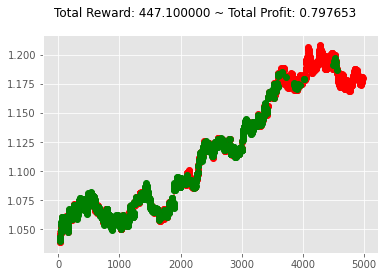

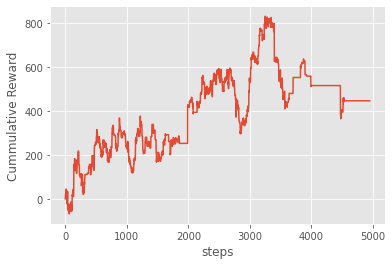

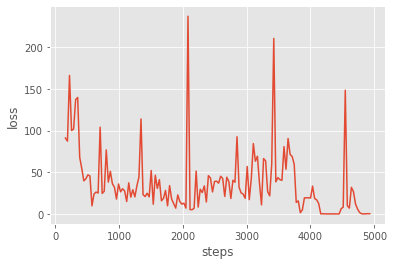

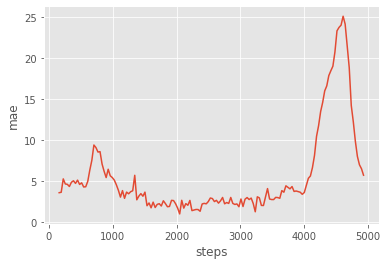

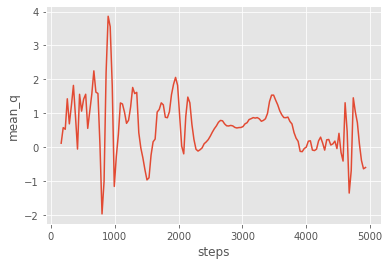

starting train 82
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 228s 230ms/step - reward: -9.7530 - cumulative_reward: 759.2002
train 82 completed. took 15835.572 seconds, total_reward: 739.399999999999 total_profit: 0.7883232057777483
min reward: -170.40000000000165, max reward: 177.89999999999972, mean_reward: 0.1494039199838349


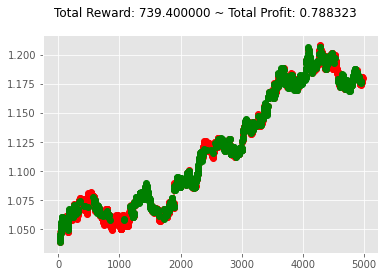

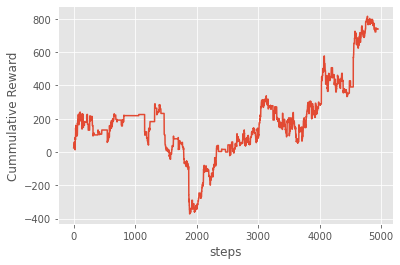

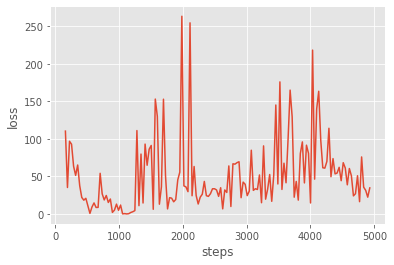

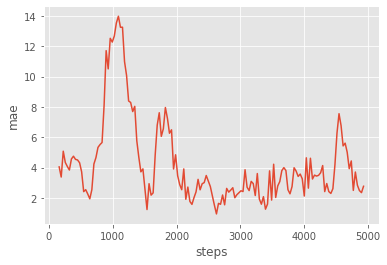

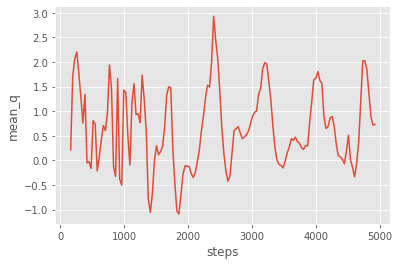

starting train 83
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 234s 237ms/step - reward: 18.8644 - cumulative_reward: -625.5789
train 83 completed. took 16127.089 seconds, total_reward: -827.0999999999741 total_profit: 0.7839226042678599
min reward: -122.8000000000007, max reward: 163.69999999999996, mean_reward: -0.16712467165083333


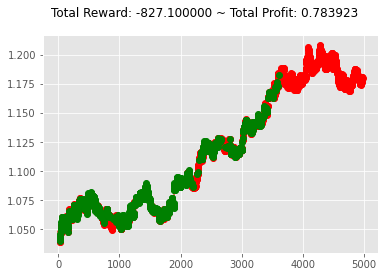

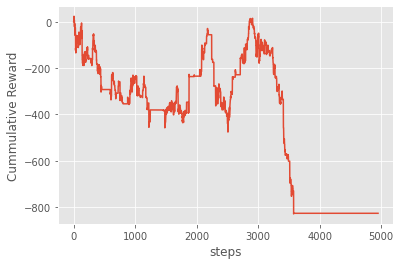

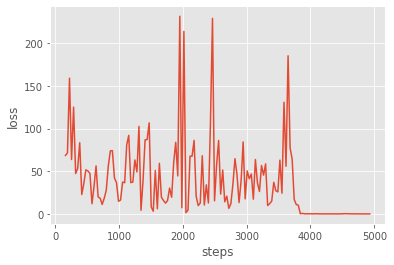

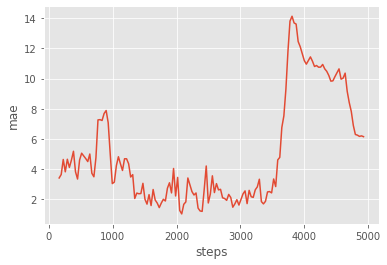

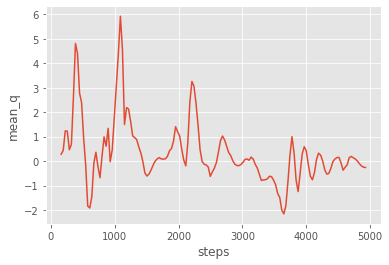

starting train 84
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 234s 237ms/step - reward: -0.2947 - cumulative_reward: -189.9744
train 84 completed. took 16419.415 seconds, total_reward: -588.6000000000563 total_profit: 0.7919016599771116
min reward: -195.19999999999982, max reward: 122.79999999999846, mean_reward: -0.11893311780158745


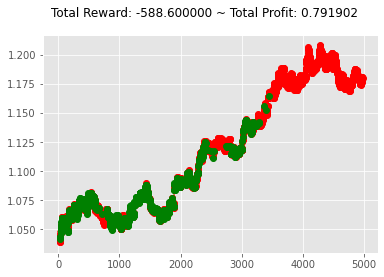

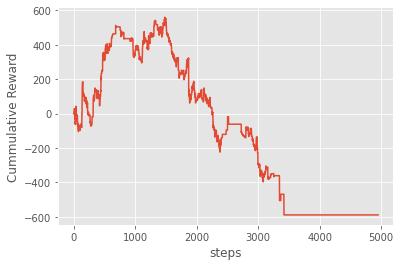

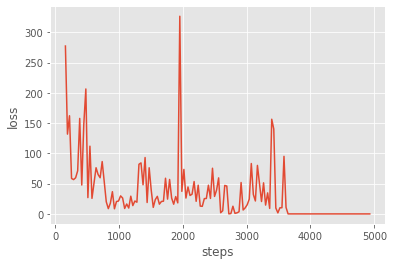

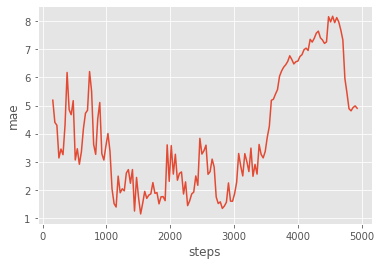

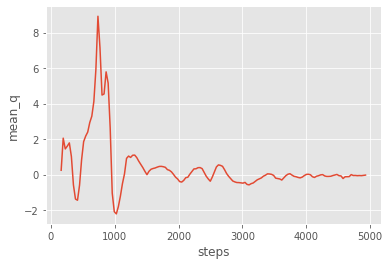

starting train 85
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 238s 241ms/step - reward: -10.4215 - cumulative_reward: 326.7114
train 85 completed. took 16716.199 seconds, total_reward: 77.70000000006071 total_profit: 0.8358629101651943
min reward: -129.69999999999925, max reward: 122.79999999999846, mean_reward: 0.015700141442727966


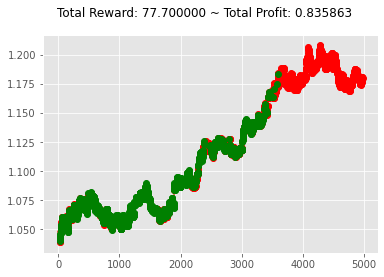

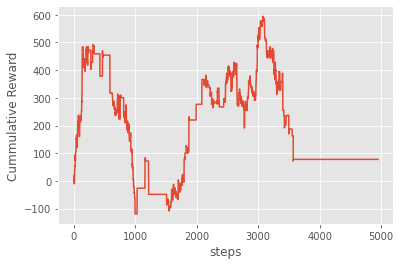

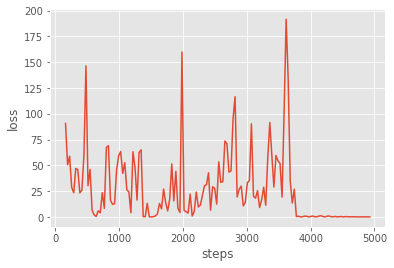

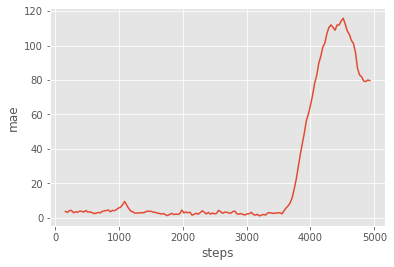

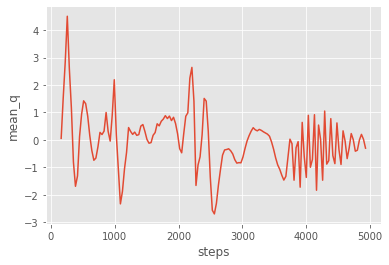

starting train 86
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 237s 240ms/step - reward: 15.0043 - cumulative_reward: 431.5886
train 86 completed. took 17012.925 seconds, total_reward: -292.6999999999925 total_profit: 0.7483852519528952
min reward: -154.50000000000185, max reward: 136.60000000000005, mean_reward: -0.05914326126490048


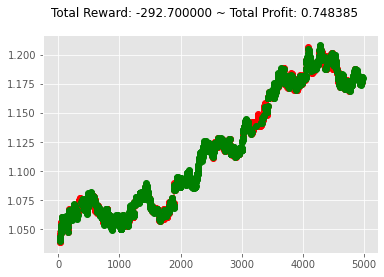

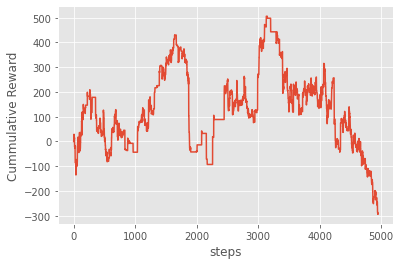

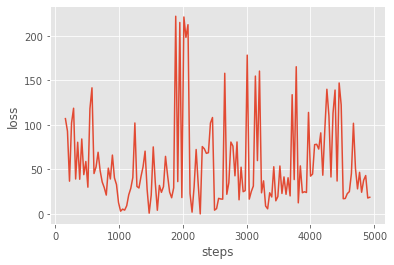

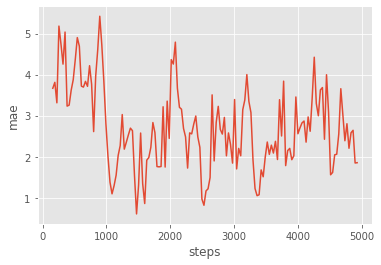

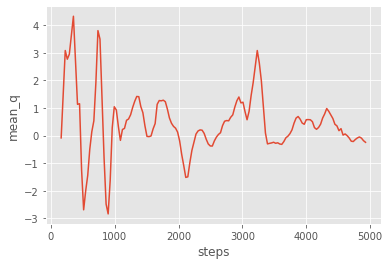

starting train 87
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 243s 246ms/step - reward: -12.6728 - cumulative_reward: -65.3325
train 87 completed. took 17317.451 seconds, total_reward: 125.90000000008342 total_profit: 0.8619854966054894
min reward: -203.40000000000026, max reward: 170.40000000000165, mean_reward: 0.02543948272379944


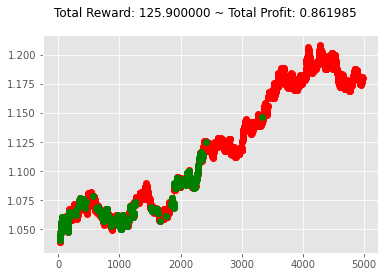

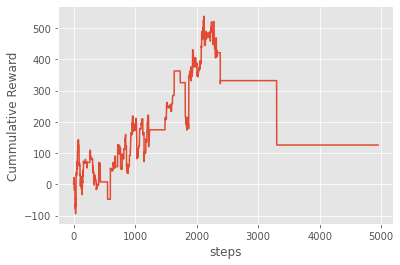

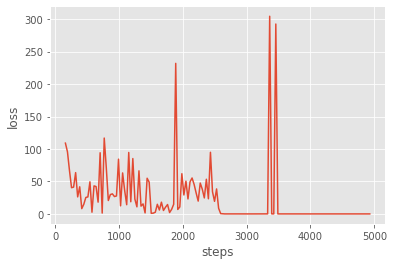

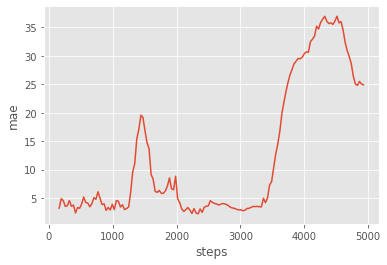

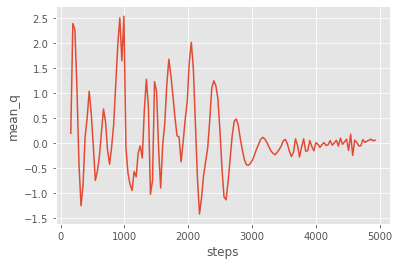

starting train 88
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 251s 253ms/step - reward: 0.7537 - cumulative_reward: 245.6947
train 88 completed. took 17617.115 seconds, total_reward: 746.0000000000509 total_profit: 0.8917254561358703
min reward: -92.20000000000228, max reward: 1019.0999999999995, mean_reward: 0.15073752273187532


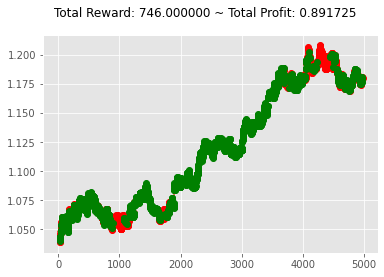

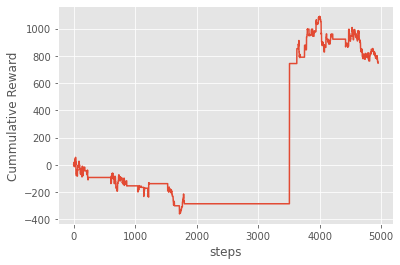

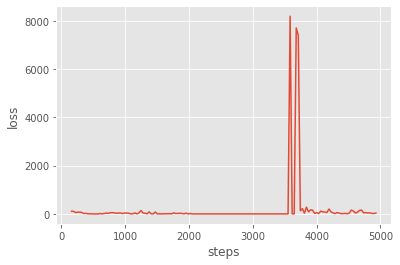

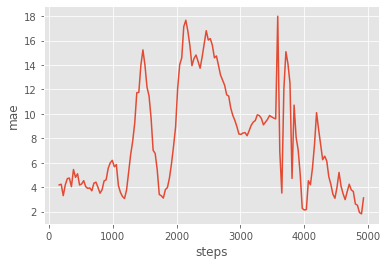

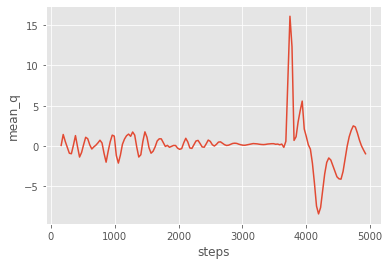

starting train 89
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 257s 259ms/step - reward: 0.5792 - cumulative_reward: 426.0091
train 89 completed. took 17933.183 seconds, total_reward: 573.3000000000059 total_profit: 0.9213154600465888
min reward: -118.20000000000164, max reward: 1196.5000000000005, mean_reward: 0.11584158415841703


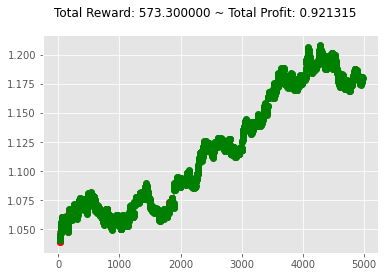

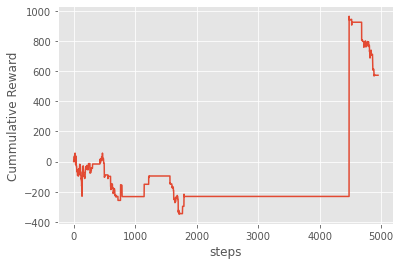

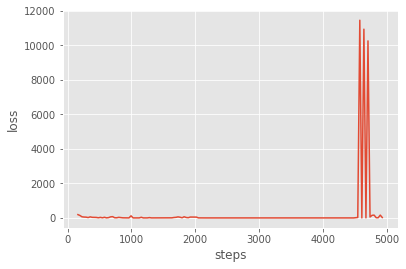

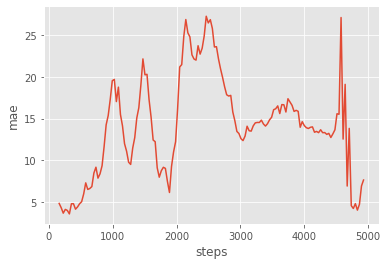

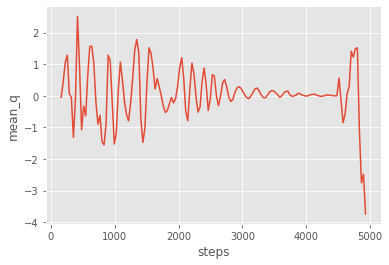

starting train 90
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 257s 259ms/step - reward: -5.1800 - cumulative_reward: 174.1579
train 90 completed. took 18252.676 seconds, total_reward: 415.7000000000135 total_profit: 0.7793292735586934
min reward: -100.49999999999892, max reward: 203.40000000000026, mean_reward: 0.08399676702364386


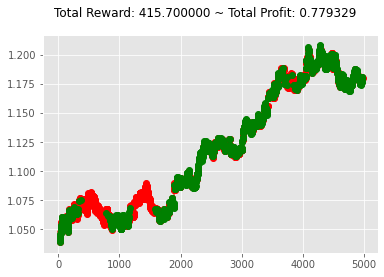

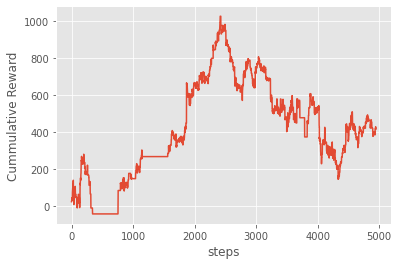

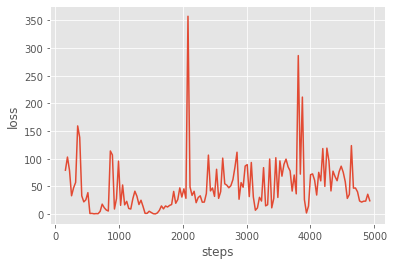

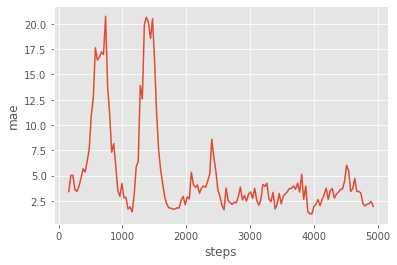

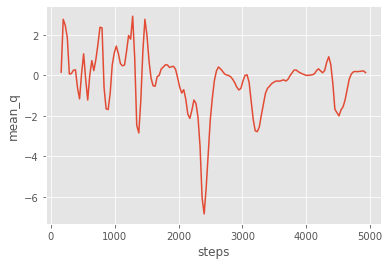

starting train 91
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 249s 251ms/step - reward: 23.0600 - cumulative_reward: 235.0810
train 91 completed. took 18564.236 seconds, total_reward: 455.30000000007146 total_profit: 0.7539418849261231
min reward: -154.50000000000185, max reward: 122.70000000000225, mean_reward: 0.09199838351183501


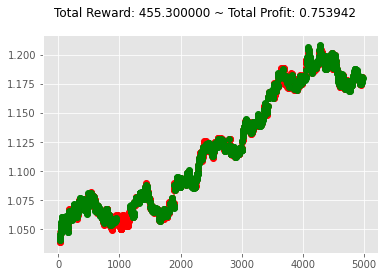

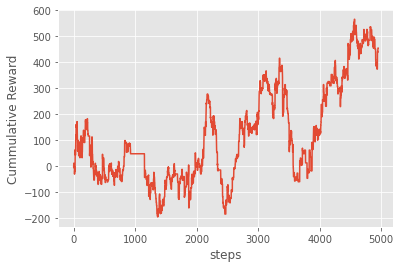

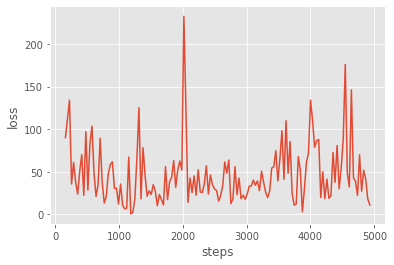

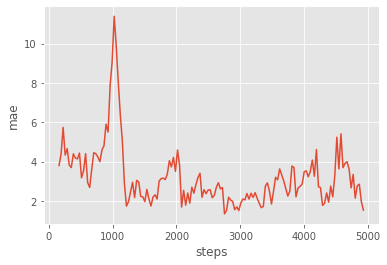

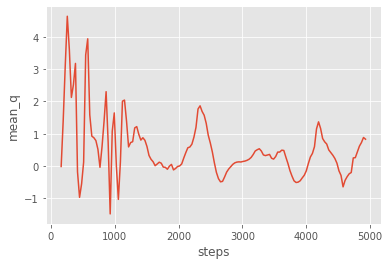

starting train 92
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
989/989 [==============================] - 250s 253ms/step - reward: -4.5055 - cumulative_reward: 794.2020
train 92 completed. took 18877.275 seconds, total_reward: 687.4000000000221 total_profit: 0.764097812930388
min reward: -168.70000000000164, max reward: 121.6000000000017, mean_reward: 0.13889674681754338


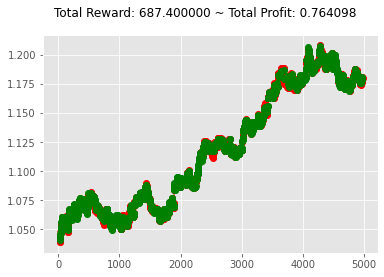

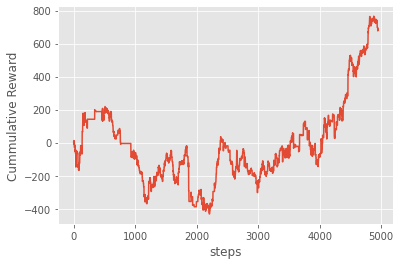

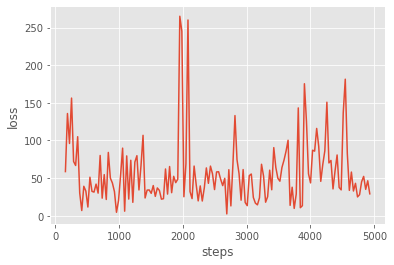

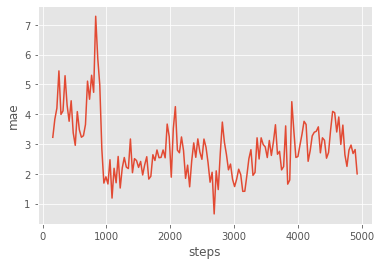

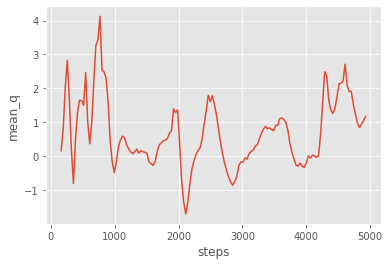

starting train 93
------------------ new episode begin, environment reset -----------------------------
Interval 1.0 (0 steps performed)
155/989 [===>..........................] - ETA: 4:30 - reward: 0.2877 - cumulative_reward: 81.7110

In [ ]:
e = Evaluator(agent_creator, env_creator, name="doubledqn")
e.train(repeat=100)

In [ ]:
e.process_train_result()
e.test(ForexV0FullFeature(df=FOREX_EURUSD_1H_ASK, frame_bound=(5000, 6000), window_size=24))

### Dueling DQN

In [ ]:
def agent_creator():
    processor = WhiteningNormalizerProcessor()
    memory = SequentialMemory(limit=256, window_length=1)
    policy = EpsGreedyQPolicy()
    agent = DQNAgent(model=buildModel(), nb_actions=nb_actions, memory=memory, nb_steps_warmup=128, policy=policy, batch_size=64, processor=processor, 
                   target_model_update=1e-2, train_interval=32, enable_double_dqn=False, gamma=0.5, enable_dueling_network=True)
    agent.compile(Adam(lr=0.001), metrics=['mae'])
    return agent
e = Evaluator(agent_creator, env_creator, name="dueling_dqn")
e.train(repeat=100)


In [ ]:
e.process_train_result()
e.test(gym.make('forex-v0', frame_bound=(5000, 6000), window_size=10))